In [1]:
import numpy as np
from numpy import *
from pylab import *
from math import *
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import os 
import pandas as pd
import glob
from astropy.io import ascii
import itertools
from datetime import datetime

# Ajuste gaussiano
from scipy.optimize import minimize
import emcee
import corner
from IPython.display import display, Math
from scipy.optimize import curve_fit

path = os.getcwd()

### Sustracción del espectro de los gases

Una vez se obtiene el espectro sintetizado mediante Starlight se procede a obtener el espectro del gas.

El espectro sintetizado por el código de Starlight se corresponde con la parte estelar, por lo que al eliminarla obtenemos los gases.

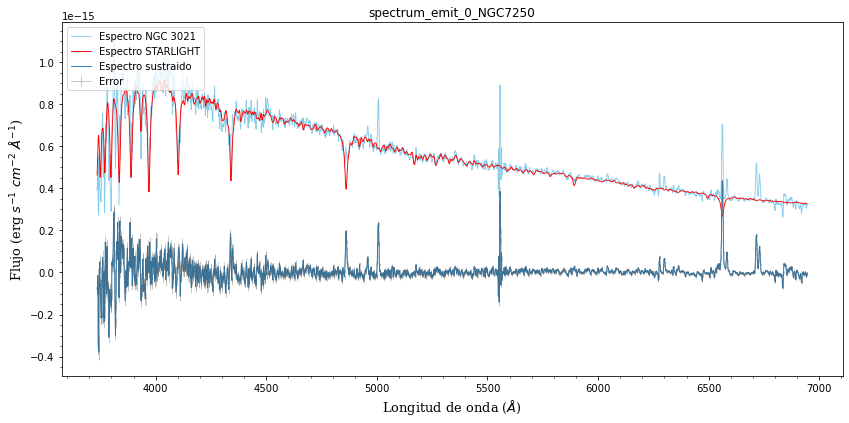

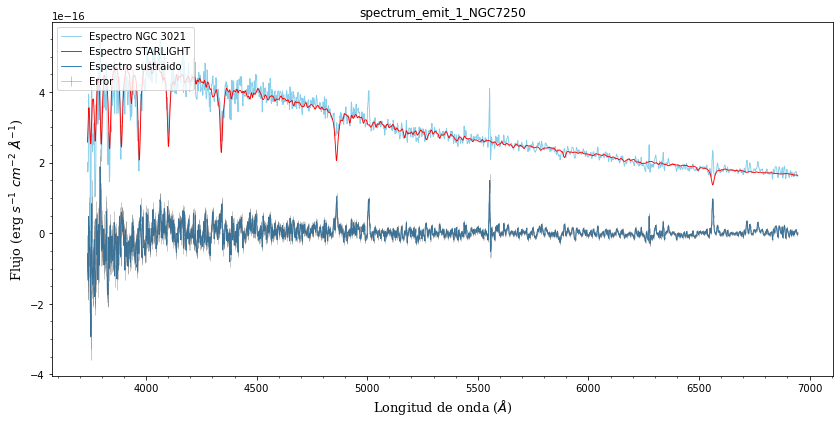

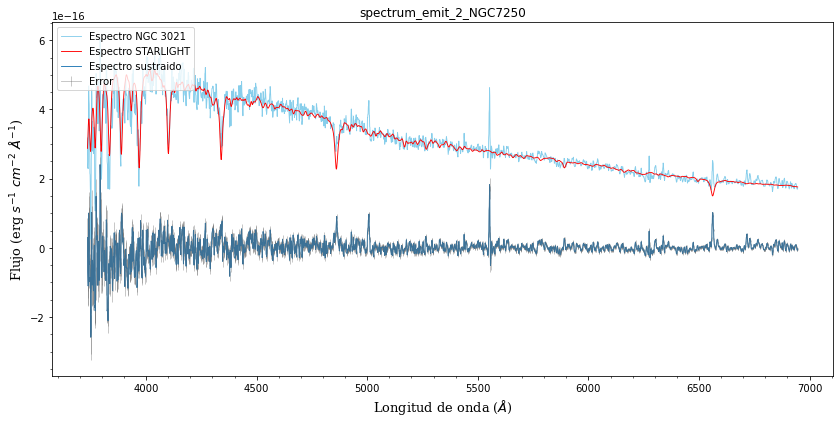

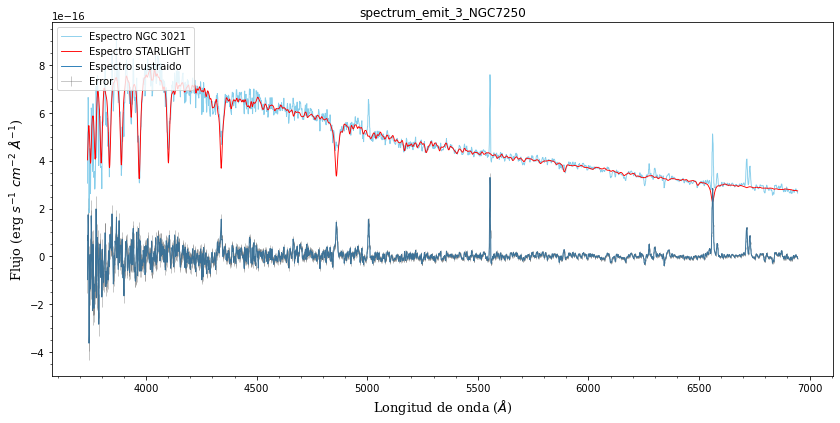

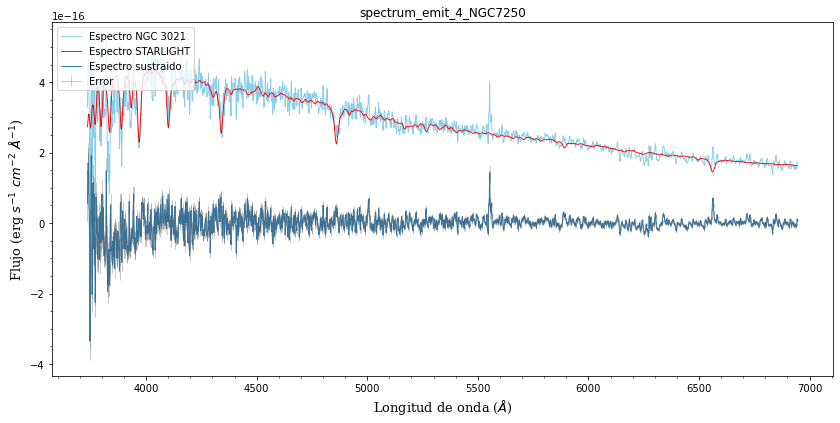

...

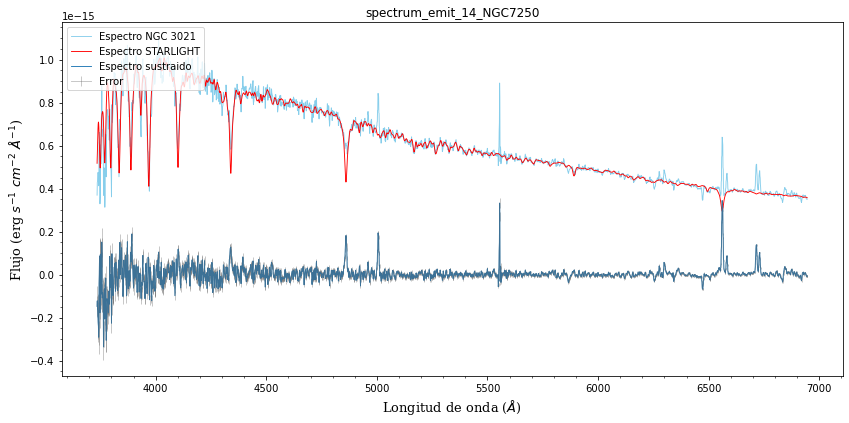

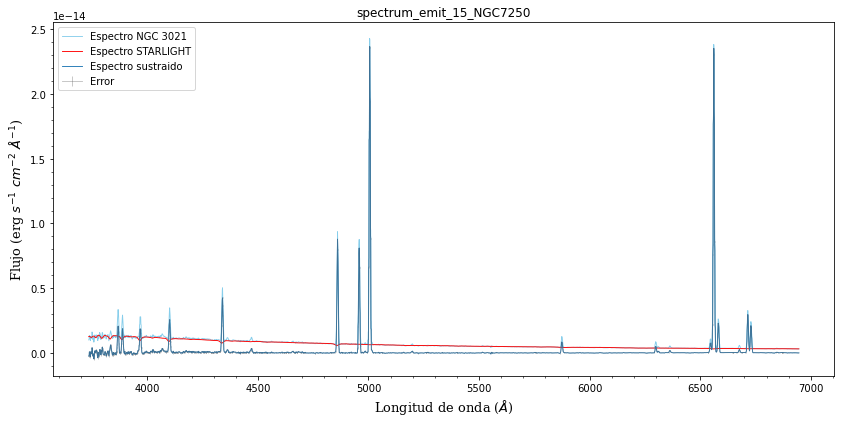

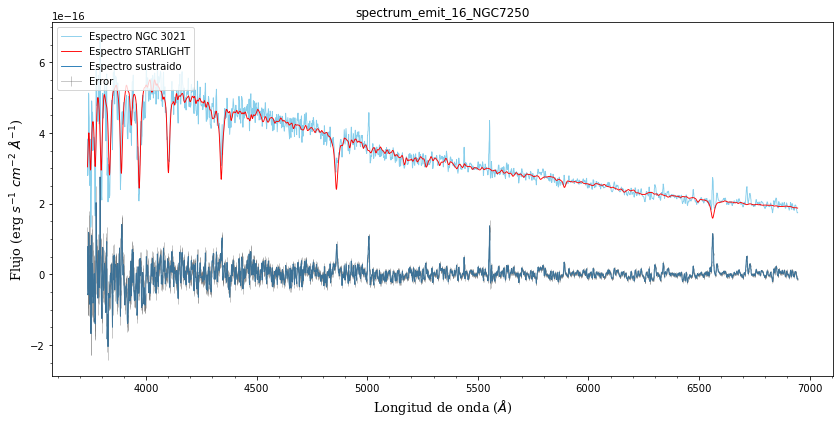

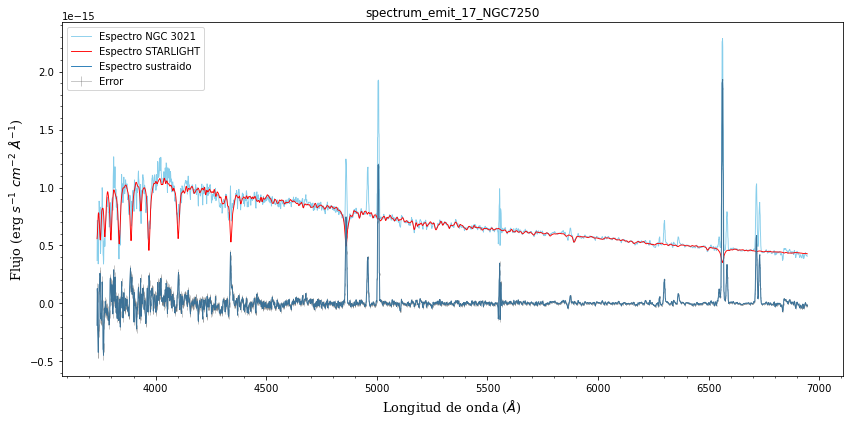

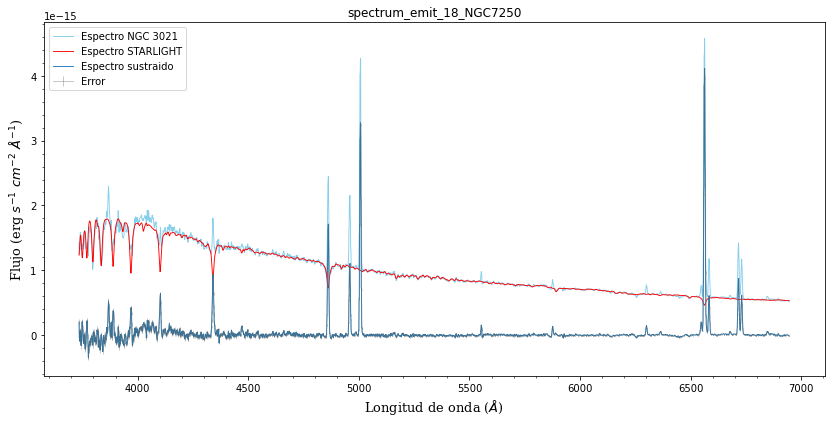

In [2]:
os.chdir(path+'\emited_spectrum')    
os.getcwd()

l_obs_todos = []
f_obs_todos = []
f_syn_todos = []
e_emit_todos = []

lenn = len(glob.glob1(path+'\emited_spectrum',"*.BN"))
#for i in list(itertools.chain(range(lenn-10,lenn-9))):
for i in range(len(glob.glob1(path+'/emited_spectrum',"*.BN"))):
    file = 'spectrum_emit_'+str(i)+'_NGC7250'
    l_obs = []
    f_obs = []
    f_syn = []
    with open(file+'.BN', 'r') as SL:
        f_obs_norm = float((np.array((SL.readlines()[25]).split()))[0,])
    with open(file+'.BN', 'r') as SL:
        data = SL.readlines()[1078:4334]   
        for linea in data:
            linea = np.array(linea.split())
            if float(linea[1]) != 0:
                l_obs.append(float(linea[0,]))
                f_obs.append(float(linea[1,]))
                f_syn.append(float(linea[2,]))
        l_obs = np.array(l_obs)
        f_obs = np.array(f_obs)*f_obs_norm
        f_syn = np.array(f_syn)*f_obs_norm
    
    e_emit = []
    with open(file+'.txt','r') as datos:
        data = datos.readlines()
        for linea in data:
            linea = np.array(linea.split())
            if float(linea[0]) >= l_obs[0] and float(linea[0]) <= l_obs[-1]:
                e_emit.append(float(linea[2,]))
        e_emit = np.array(e_emit)        
        
    
    fig, ax = plt.subplots(figsize=(14,6.5))
    ax.plot(l_obs,f_obs,color='skyblue', linewidth=0.9,label="Espectro NGC 3021")
    ax.plot(l_obs,f_syn,color='red', linewidth=0.9,label="Espectro STARLIGHT")
    ax.errorbar(l_obs,f_obs-f_syn,yerr=e_emit,linewidth=0.9, alpha=0.4, label='Error', color='dimgrey')
    ax.plot(l_obs,f_obs-f_syn, linewidth=0.9,label="Espectro sustraido")
    
    xlabel(r'Longitud de onda ($\AA$)', fontsize=13,fontfamily='serif'); ylabel(r'Flujo (erg $s^{-1}$ $cm^{-2}$ $\AA^{-1}$)', fontsize=13,fontfamily='serif') 
    plt.legend(loc='upper left')
    title('%s' %(file));plt.legend(loc='upper left')
    plt.minorticks_on()
    #axvline(4861, color='k', ls="dotted",lw='0.9')
    #text(4881, 8.3*10**(-16), r'[H$_{\beta}$] 4861',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(5007, color='k', ls="dotted",lw='0.9')
    #text(5027, 8.3*10**(-16), r'[O III] 5007',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6563, color='k', ls="dotted",lw='0.9')
    #text(6485, 9.9*10**(-16), r'[H$_{\alpha}$] 6563',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6583, color='k', ls="dotted",lw='0.9')
    #text(6603, 9.9*10**(-16), r'[N II] 6583',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6716, color='k', ls="dotted",lw='0.9')
    #text(6646, 6.5*10**(-16), r'[S II] 6716',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6731, color='k', ls="dotted",lw='0.9')
    #text(6751, 6.5*10**(-16), r'[S II] 6731',alpha=0.8,rotation='vertical',fontsize='11')  
    #plt.savefig('espectro_final.png')
    plt.show() 
    
    l_obs_todos.append(l_obs)
    f_obs_todos.append(f_obs)
    f_syn_todos.append(f_syn)
    e_emit_todos.append(e_emit)
    
l_obs_todos = np.array(l_obs_todos)
f_obs_todos = np.array(f_obs_todos)
f_syn_todos = np.array(f_syn_todos)
e_emit_todos = np.array(e_emit_todos)

### Ajuste gaussiano en las líneas de Hbeta, OIII, Halfa y NII

Se emplean dos ajustes distintos:
 - Dos ajustes simple para Hb y OIII 
         def gaussian(x, a, x0, sigma):
            return a*np.exp(-(x-x0)**2/(2*sigma**2))
            
 - Un ajuste triple para Halfa y NII 
         def gaussian_2(x, a1 ,a2,a3, x0, sigma):
           return a1*np.exp(-(x-x0)**2/(2*sigma**2))+a2*np.exp(-(x-(x0+d1))**2/(2*sigma**2))+a3*np.exp(-(x-(x0-d2))**2/(2*sigma**2))
        
   
Como las líneas de Halfa y NII están muy cerca hay que hacer un ajuste de tres gaussianas a la vez. 


AJUSTANDO ESPECTRO 0

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


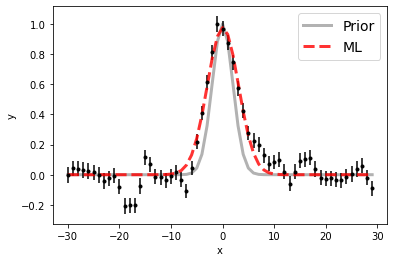

100%|██████████| 15000/15000 [00:17<00:00, 867.28it/s]


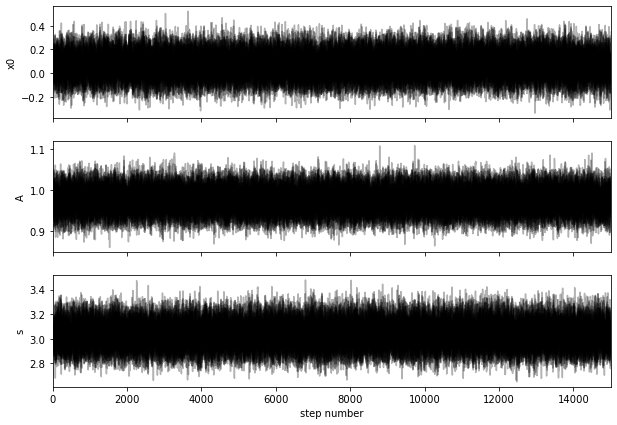

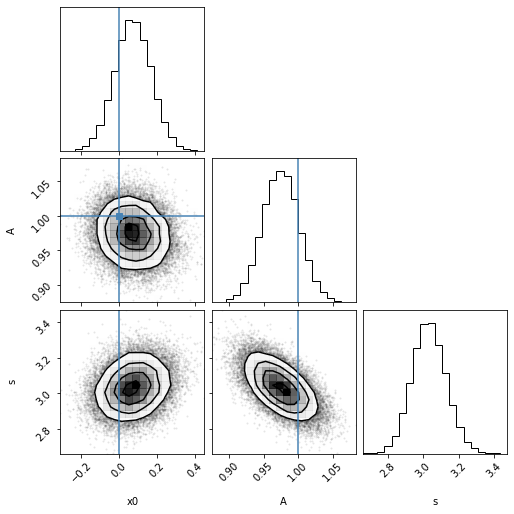

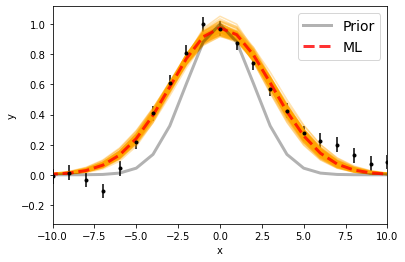

Maximum likelihood estimates:
x0 = 0.069
A = 0.976
s = 3.028


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.070210250688 [0.0956486  0.09616558]
A  =  1.9105502283751434e-16 [5.18901398e-18 5.16842139e-18]
s  =  3.031053530435771 [0.09357033 0.09771223]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


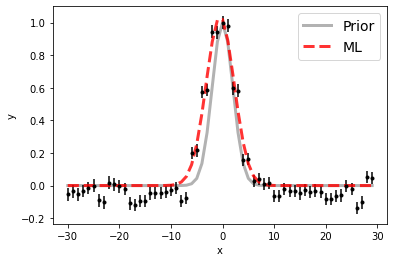

100%|██████████| 15000/15000 [00:17<00:00, 843.80it/s]


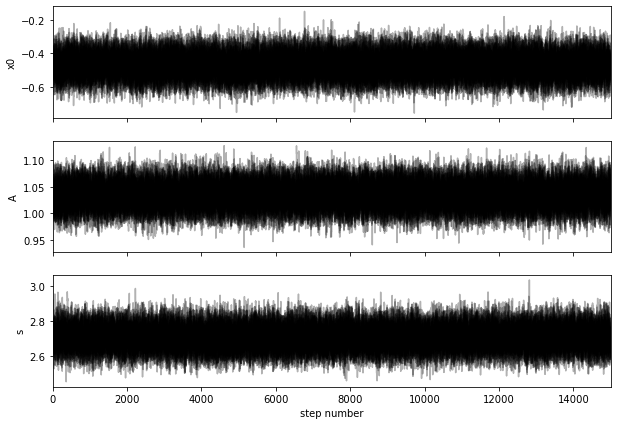

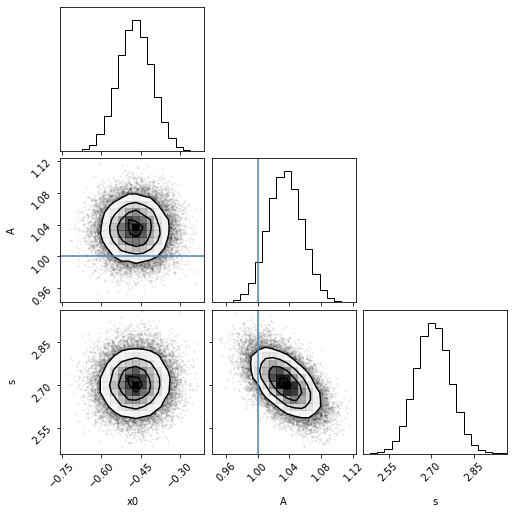

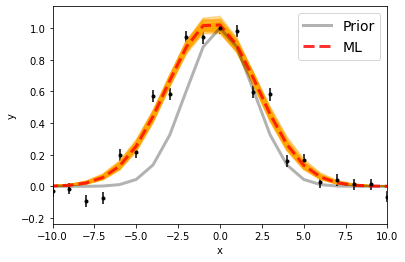

Maximum likelihood estimates:
x0 = -0.471
A = 1.035
s = 2.705


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.52854073705 [0.06443391 0.06500992]
A  =  2.4279588138334453e-16 [5.03931120e-18 5.09738629e-18]
s  =  2.706783565552768 [0.06044452 0.06071429]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


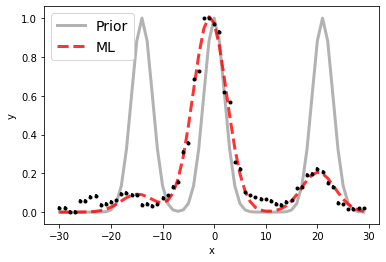

100%|██████████| 15000/15000 [00:29<00:00, 508.29it/s]


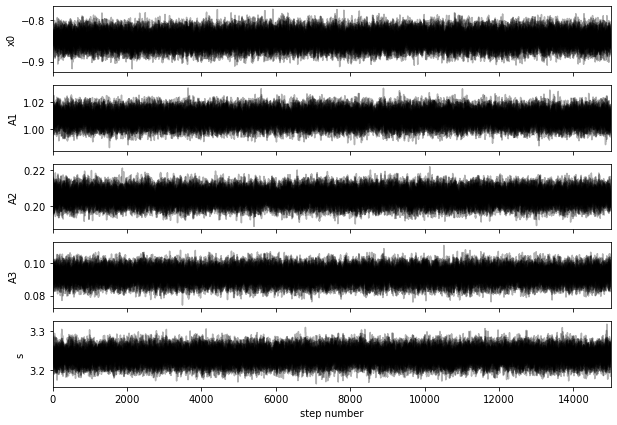

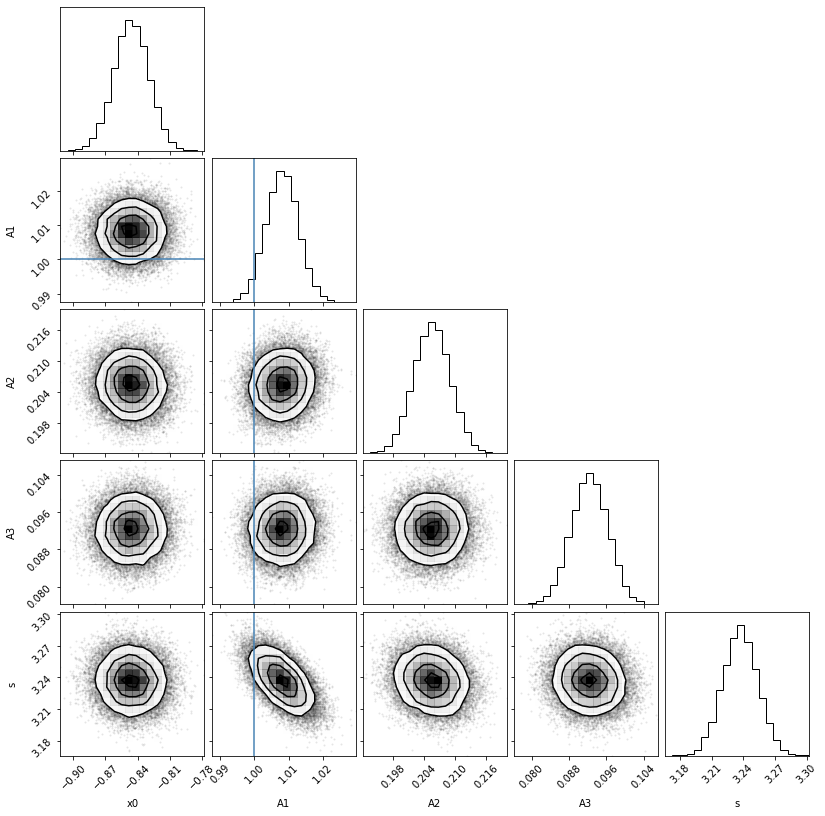

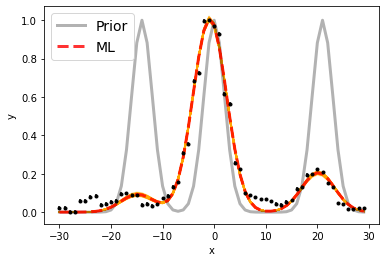

Maximum likelihood estimates:
x0 = -0.846
A1 = 1.008
A2 = 0.205
A3 = 0.092
s = 3.237


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.153950095363 6583.153950095363 [0.01589063 0.01638198]
A1, A2   =  4.394985455848282e-16 8.956380827899454e-17 [2.08077137e-18 2.02336655e-18] [1.54115181e-18 1.52525885e-18]
s  =  3.237036868441424 [0.01663603 0.0165282 ]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 1

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


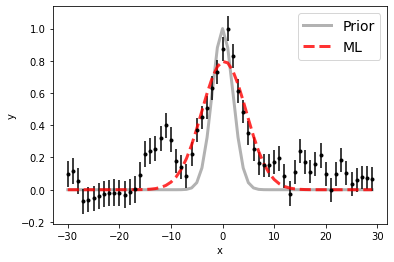

100%|██████████| 15000/15000 [00:19<00:00, 765.51it/s]


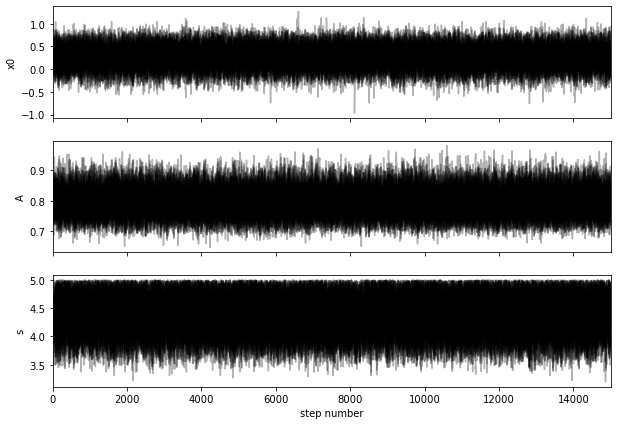

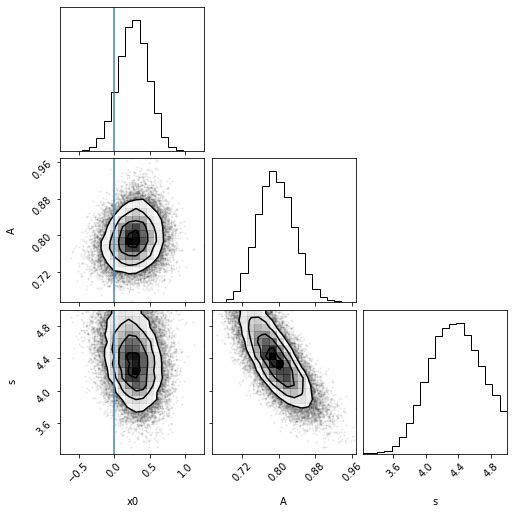

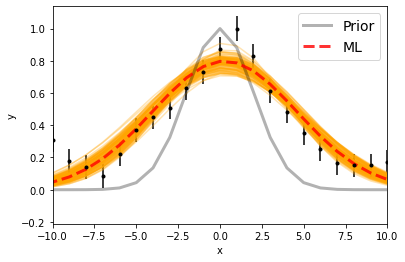

Maximum likelihood estimates:
x0 = 0.279
A = 0.798
s = 4.320


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.272954819307 [0.21478851 0.20659044]
A  =  8.316909898910958e-17 [4.04007532e-18 4.35820524e-18]
s  =  4.365022457768648 [0.32146261 0.33259222]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


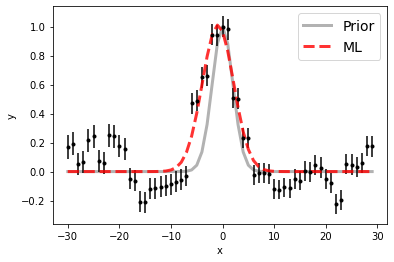

100%|██████████| 15000/15000 [00:21<00:00, 692.06it/s]


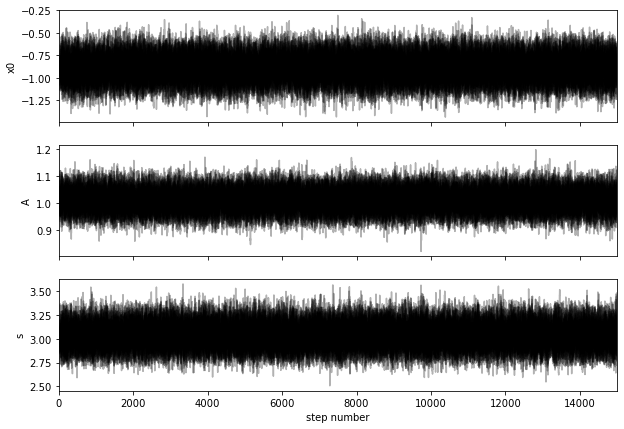

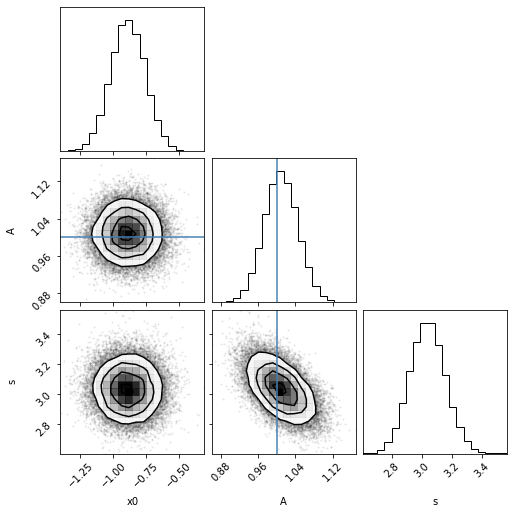

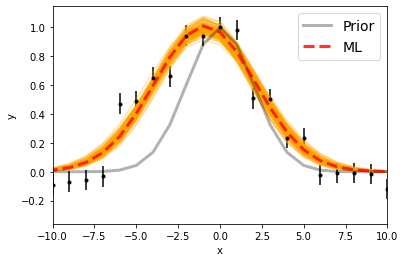

Maximum likelihood estimates:
x0 = -0.889
A = 1.011
s = 3.030


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.110032005255 [0.13022771 0.13147033]
A  =  9.747896971355924e-17 [3.47593984e-18 3.55013714e-18]
s  =  3.035401001463267 [0.11675184 0.11715164]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


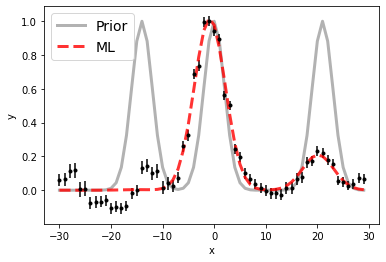

100%|██████████| 15000/15000 [00:32<00:00, 454.60it/s]


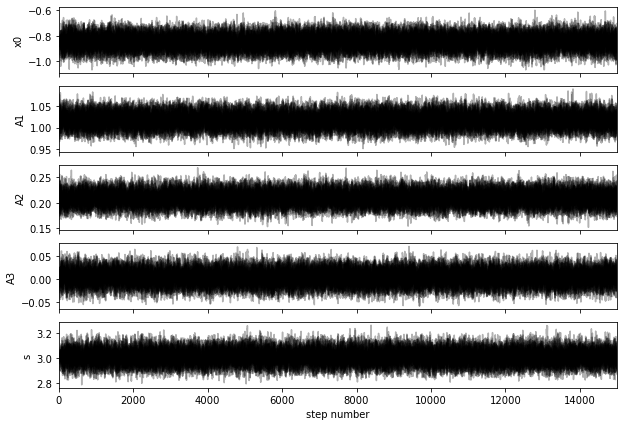

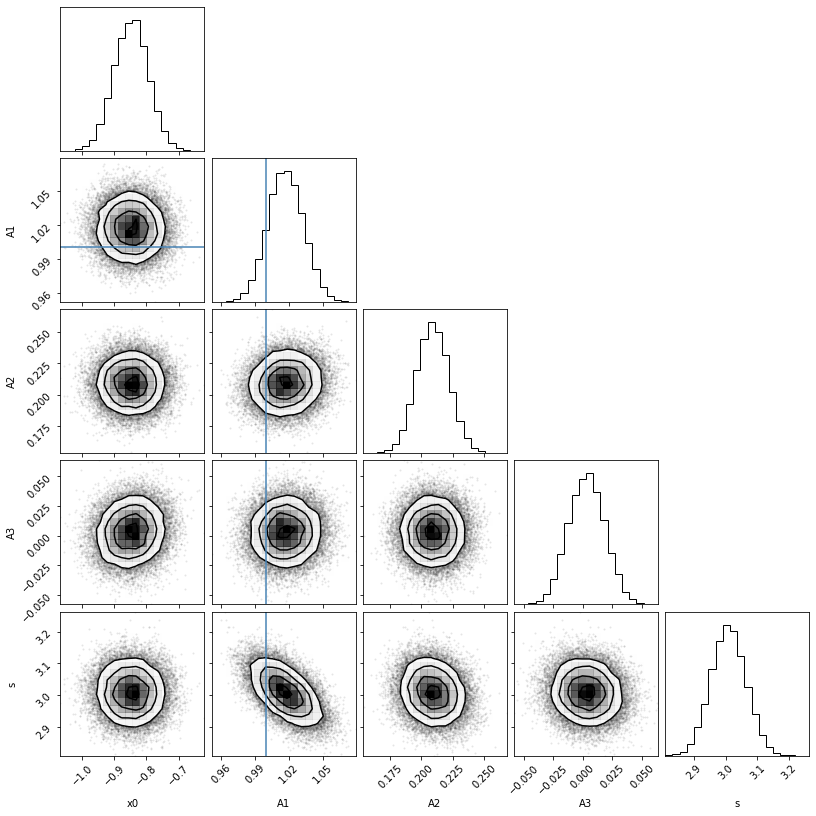

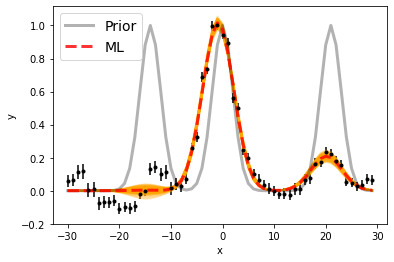

Maximum likelihood estimates:
x0 = -0.848
A1 = 1.017
A2 = 0.209
A3 = 0.003
s = 3.007


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.152087905396 6583.152087905396 [0.05371104 0.0522859 ]
A1, A2   =  9.839301004370328e-17 2.0213487181731427e-17 [1.49089686e-18 1.54356568e-18] [1.24510925e-18 1.24994203e-18]
s  =  3.0083949639283434 [0.05334096 0.05501477]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 2

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


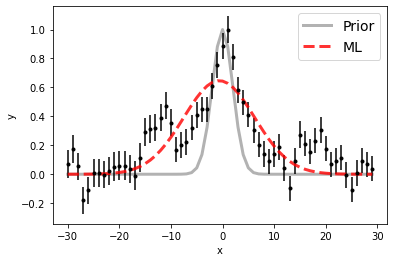

  0%|          | 0/15000 [00:00<?, ?it/s]C:\Users\saruk\anaconda3\lib\site-packages\emcee\moves\red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 15000/15000 [00:10<00:00, 1449.46it/s]


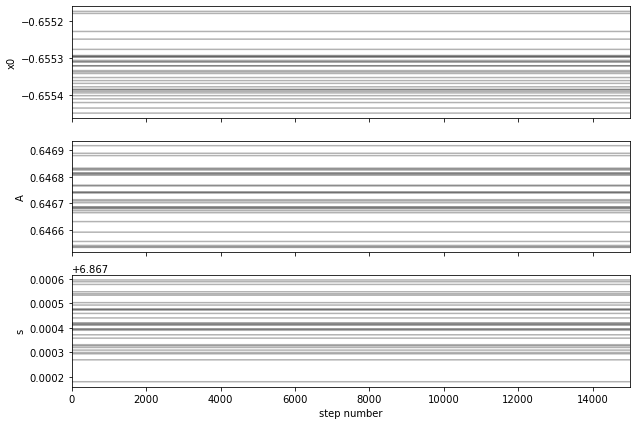

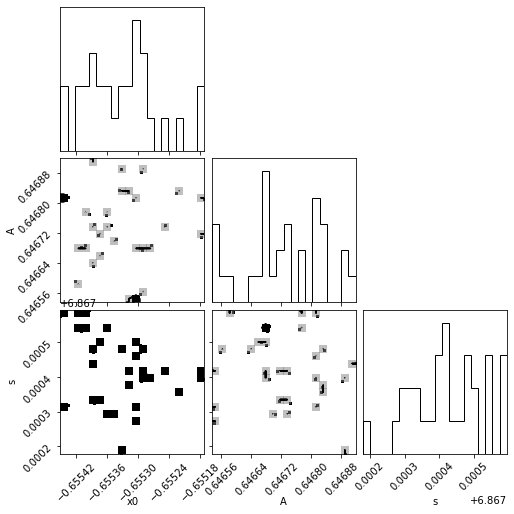

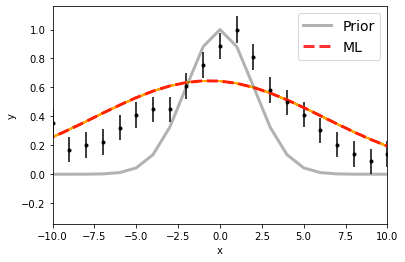

Maximum likelihood estimates:
x0 = -0.655
A = 0.647
s = 6.867


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.3446642158515 [6.65926128e-05 5.96478124e-05]
A  =  5.86503655353421e-17 [1.22722521e-20 9.32010329e-21]
s  =  6.867414866621606 [0.00010653 0.00012385]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


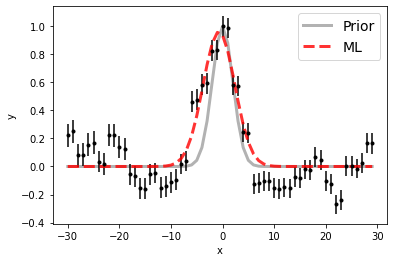

100%|██████████| 15000/15000 [00:18<00:00, 793.60it/s]


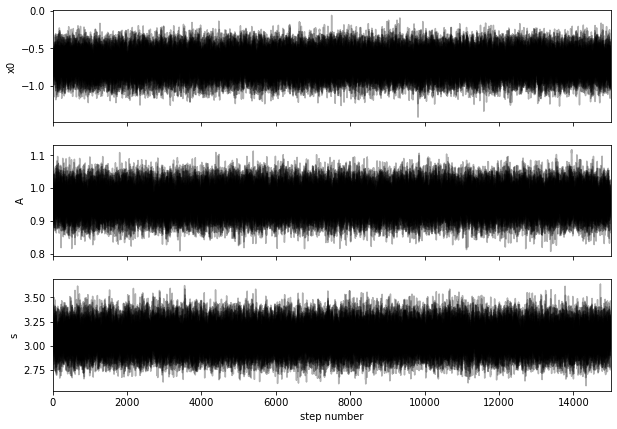

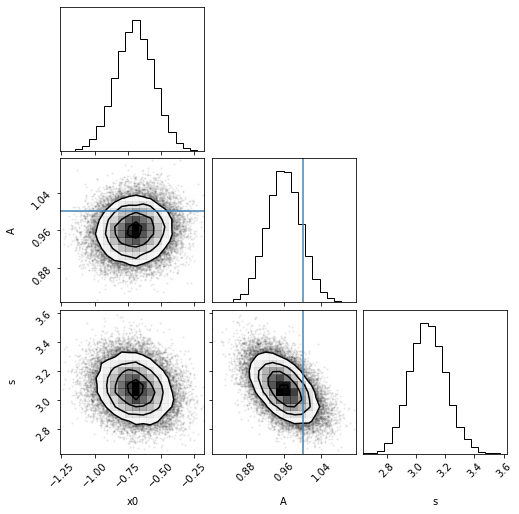

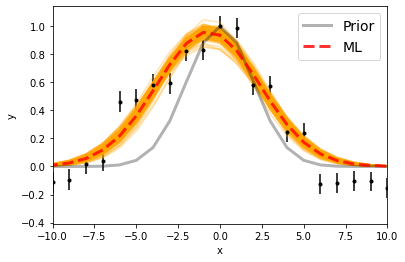

Maximum likelihood estimates:
x0 = -0.697
A = 0.962
s = 3.076


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.303388101952 [0.14524006 0.14237825]
A  =  9.35495827747182e-17 [3.54316310e-18 3.51431614e-18]
s  =  3.078379013582507 [0.12087574 0.12490436]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


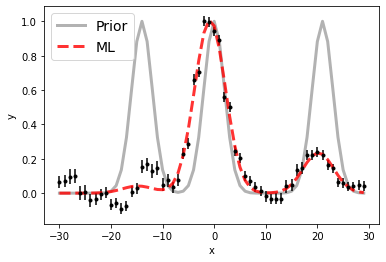

100%|██████████| 15000/15000 [00:29<00:00, 515.81it/s]


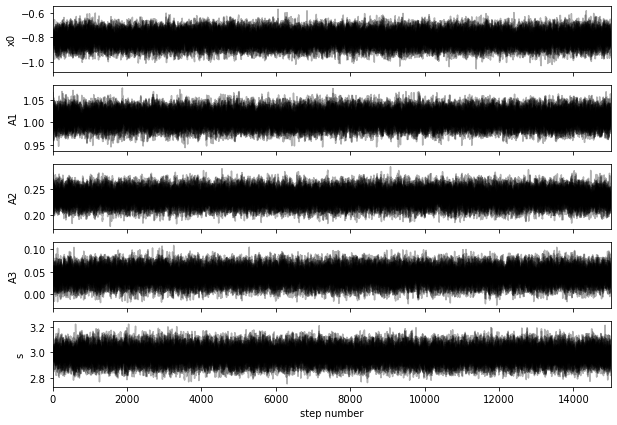

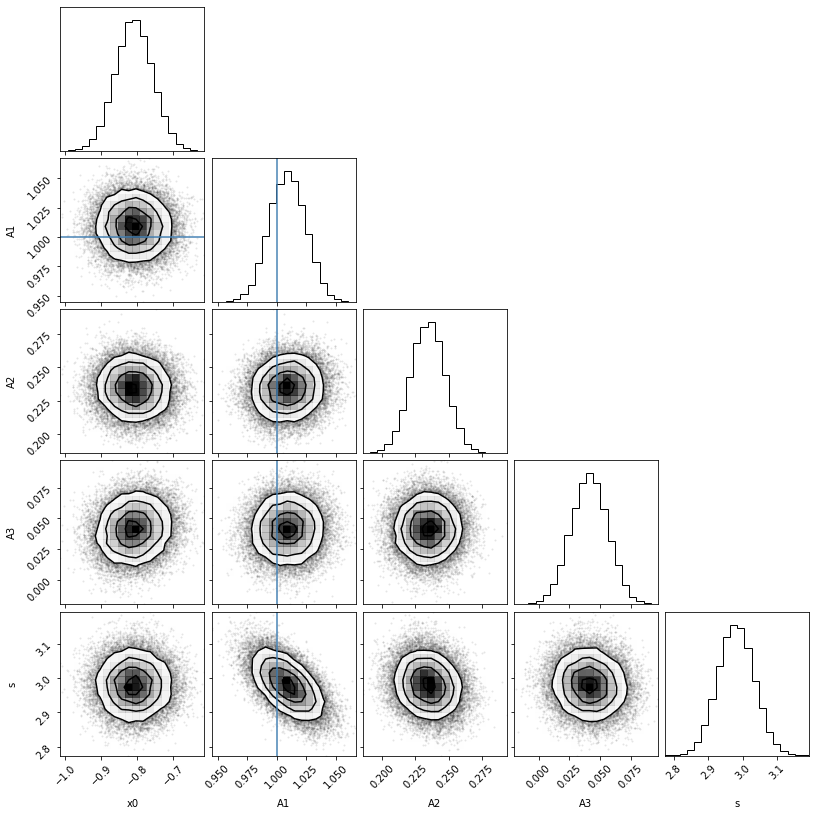

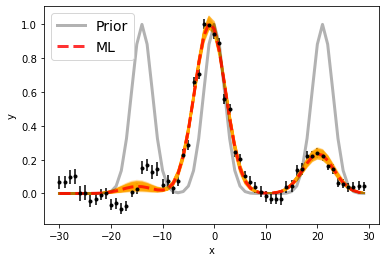

Maximum likelihood estimates:
x0 = -0.807
A1 = 1.009
A2 = 0.235
A3 = 0.042
s = 2.980


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.191403502895 6583.191403502895 [0.05140013 0.05194754]
A1, A2   =  1.0291193040701602e-16 2.3916938180479757e-17 [1.57249356e-18 1.58141331e-18] [1.30403651e-18 1.30316398e-18]
s  =  2.9798157285502365 [0.05203398 0.05296855]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 3

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


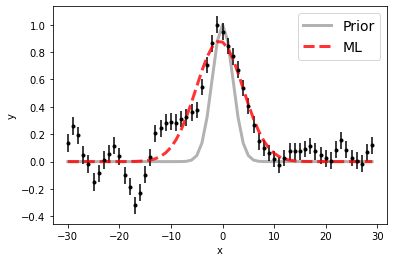

100%|██████████| 15000/15000 [00:18<00:00, 803.62it/s]


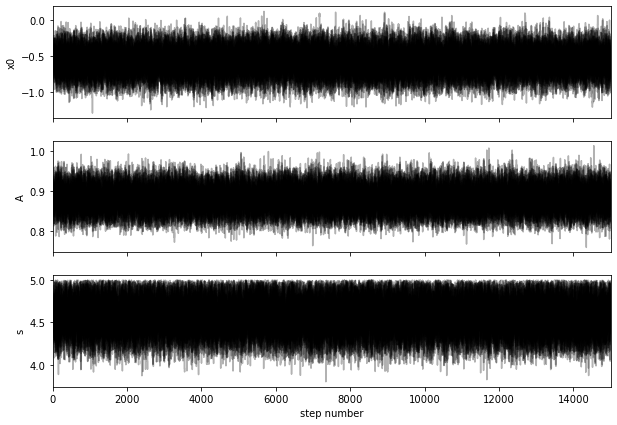

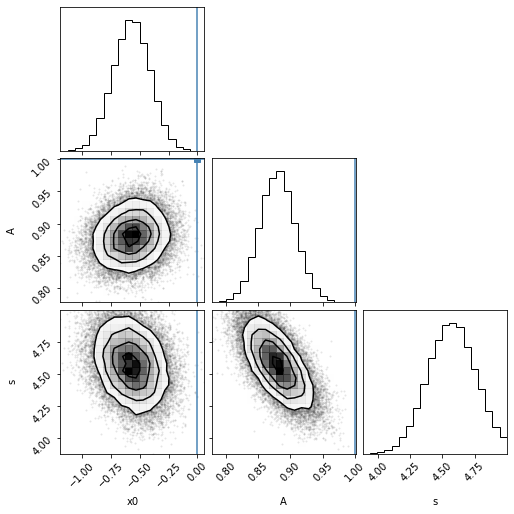

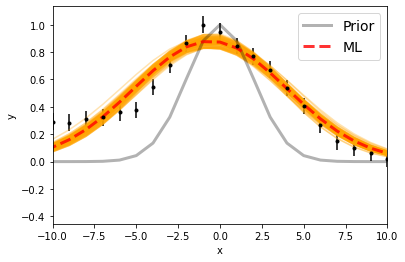

Maximum likelihood estimates:
x0 = -0.572
A = 0.880
s = 4.568


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.428976840314 [0.16351224 0.16054851]
A  =  1.252289916467998e-16 [3.88431119e-18 3.97130750e-18]
s  =  4.571818131910546 [0.18282736 0.18469079]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


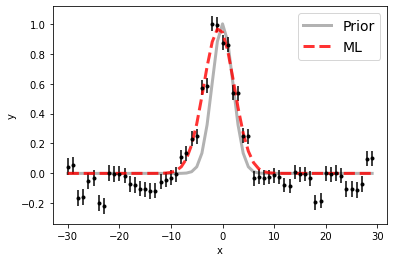

100%|██████████| 15000/15000 [00:18<00:00, 813.26it/s]


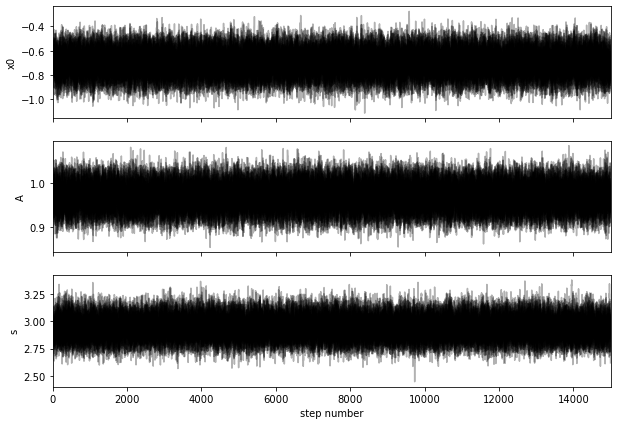

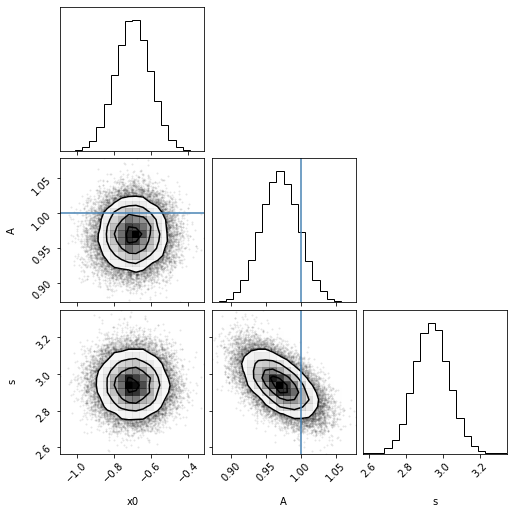

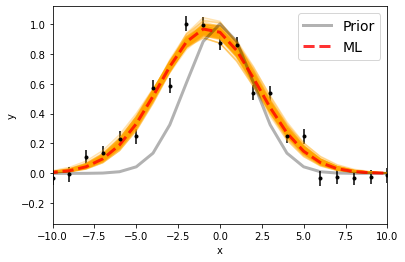

Maximum likelihood estimates:
x0 = -0.697
A = 0.971
s = 2.937


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.302835113369 [0.09438824 0.09432685]
A  =  1.4928431795321767e-16 [4.17751944e-18 4.22239674e-18]
s  =  2.940081628863556 [0.09223508 0.09495947]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


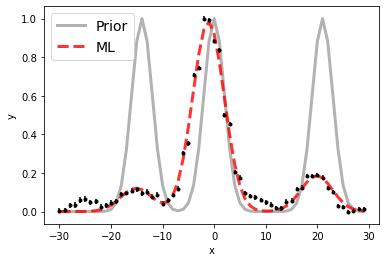

100%|██████████| 15000/15000 [00:29<00:00, 513.89it/s]


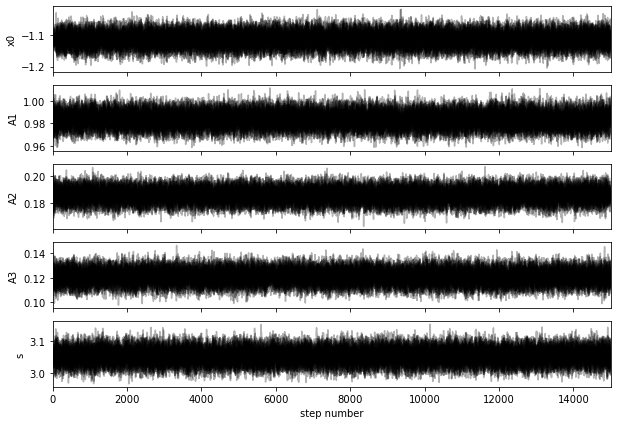

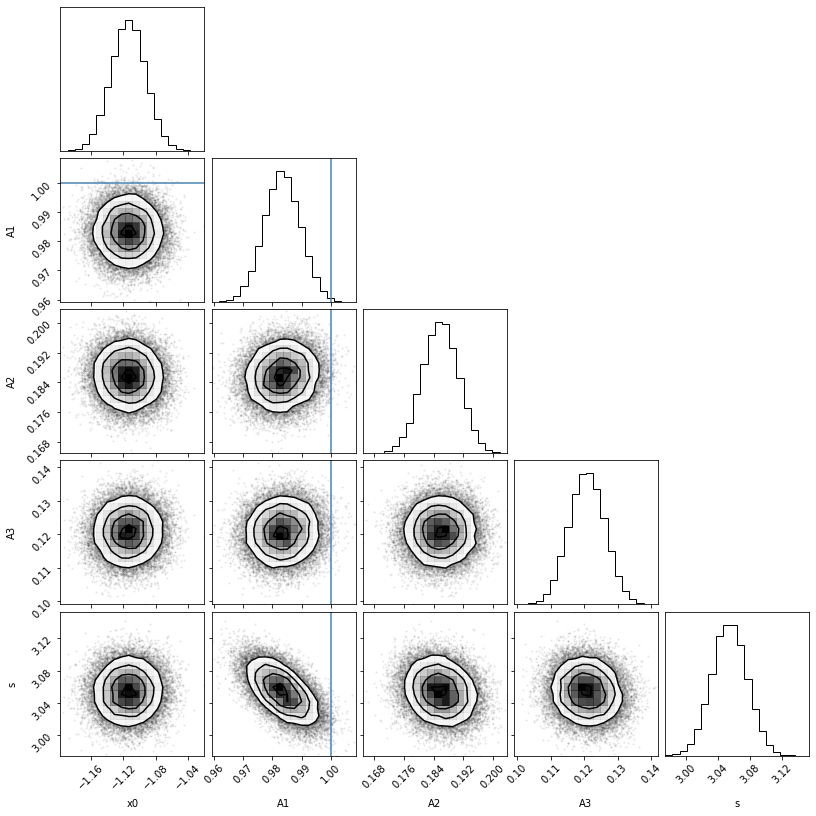

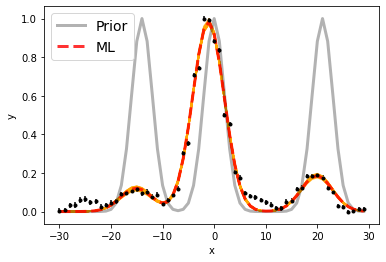

Maximum likelihood estimates:
x0 = -1.114
A1 = 0.983
A2 = 0.186
A3 = 0.121
s = 3.054


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.886171915536 6582.886171915536 [0.02131917 0.02124766]
A1, A2   =  2.796437281305148e-16 5.284633697761652e-17 [1.76028577e-18 1.78920410e-18] [1.38267678e-18 1.37889259e-18]
s  =  3.0541268230454506 [0.02156925 0.02189599]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 4

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


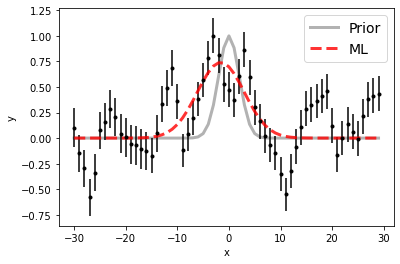

100%|██████████| 15000/15000 [00:18<00:00, 816.21it/s]


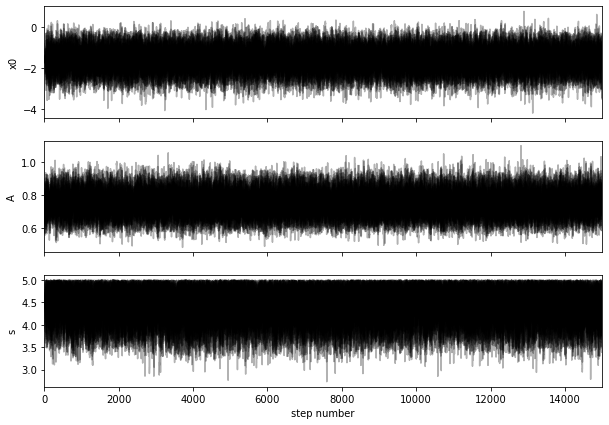

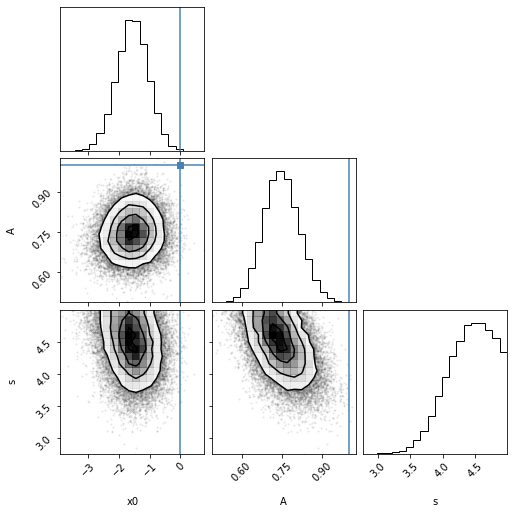

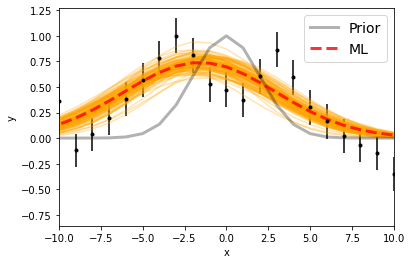

Maximum likelihood estimates:
x0 = -1.576
A = 0.740
s = 4.553


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4859.436952967401 [0.52573952 0.51117015]
A  =  3.646545995804389e-17 [3.17553950e-18 3.37044353e-18]
s  =  4.4570579017836955 [0.39995219 0.34679422]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


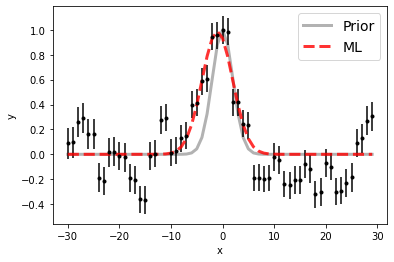

100%|██████████| 15000/15000 [00:18<00:00, 811.90it/s]


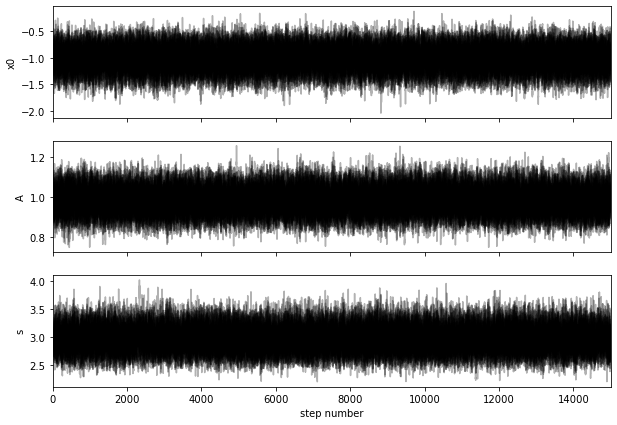

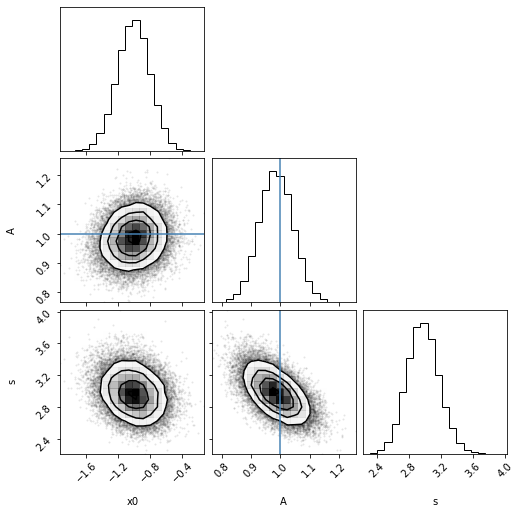

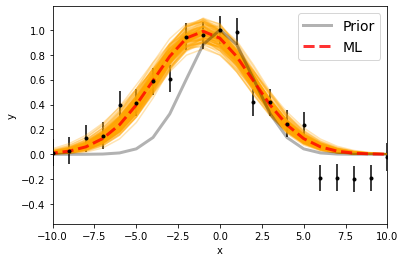

Maximum likelihood estimates:
x0 = -1.005
A = 0.988
s = 2.959


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.991123336957 [0.20586333 0.20316105]
A  =  6.702072229631113e-17 [3.93044802e-18 4.00698852e-18]
s  =  2.970225578151801 [0.19501952 0.20404905]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


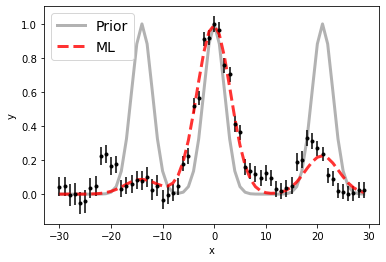

100%|██████████| 15000/15000 [00:29<00:00, 515.68it/s]


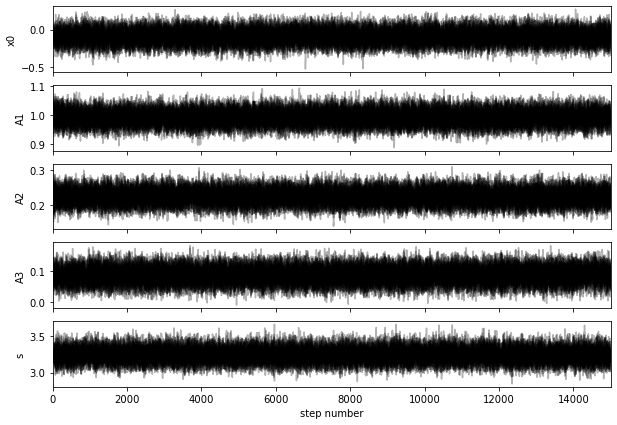

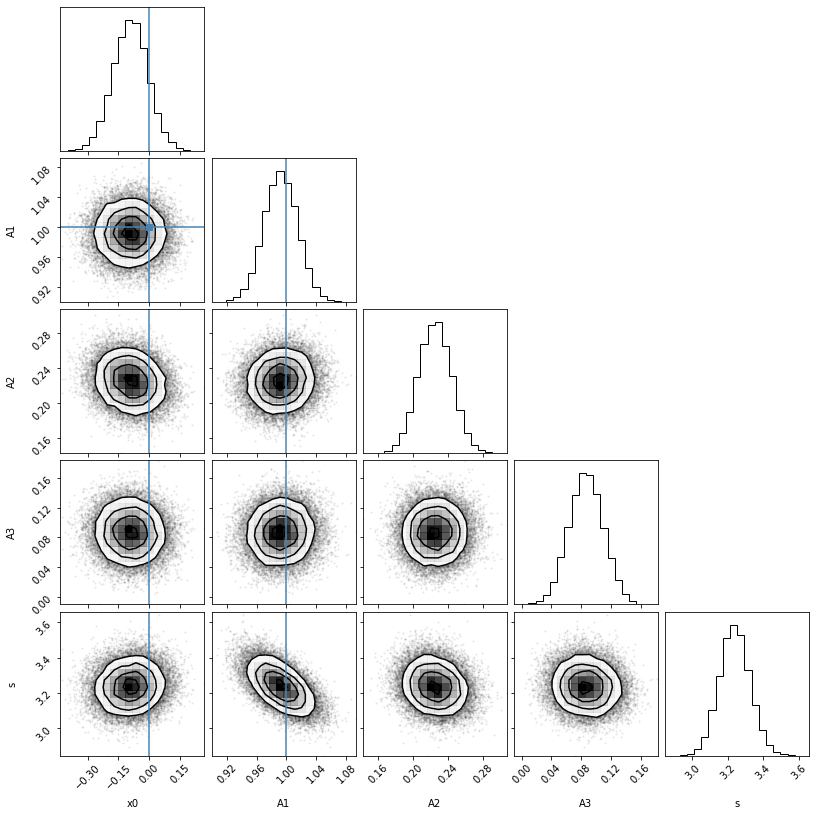

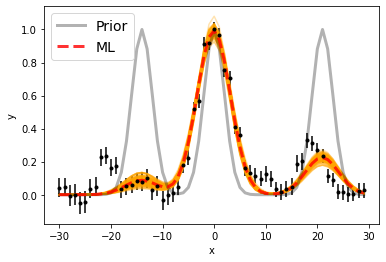

Maximum likelihood estimates:
x0 = -0.093
A1 = 0.993
A2 = 0.225
A3 = 0.087
s = 3.236


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.908081274435 6583.908081274435 [0.08575311 0.08290242]
A1, A2   =  7.060336439219167e-17 1.6010273566979352e-17 [1.60731492e-18 1.61280124e-18] [1.34212757e-18 1.34140690e-18]
s  =  3.2375144881530424 [0.08407805 0.08631154]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 5

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


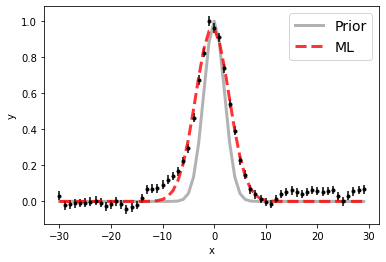

100%|██████████| 15000/15000 [00:18<00:00, 803.81it/s]


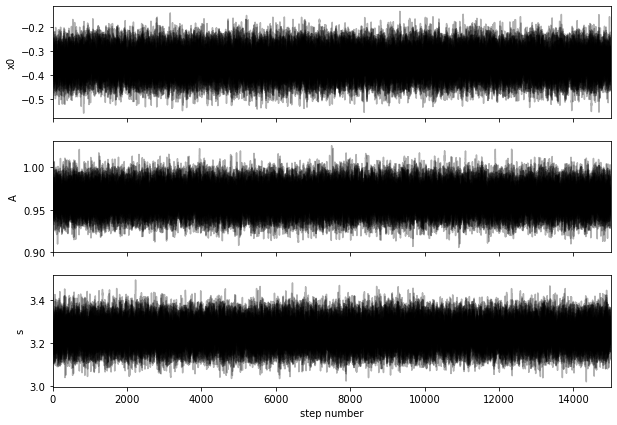

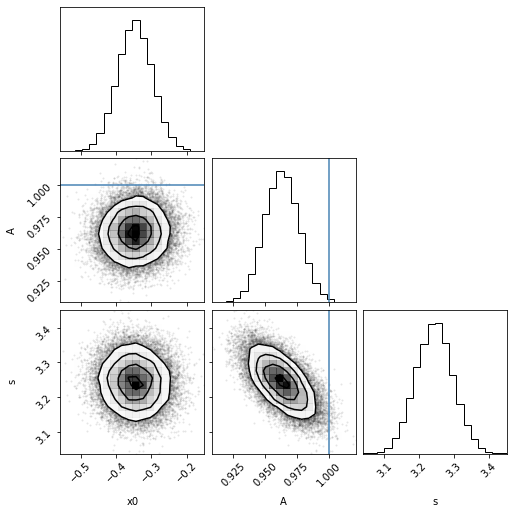

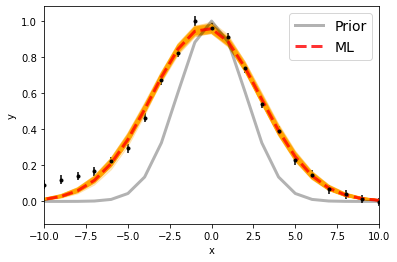

Maximum likelihood estimates:
x0 = -0.346
A = 0.963
s = 3.242


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.653272727389 [0.04905321 0.04889685]
A  =  3.365453754854362e-16 [4.78992963e-18 4.80883024e-18]
s  =  3.243590753351718 [0.05341648 0.05279269]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


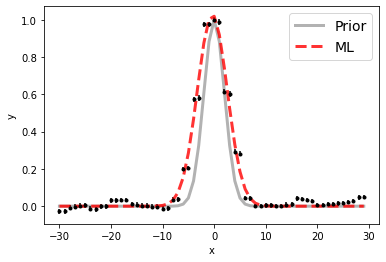

100%|██████████| 15000/15000 [00:19<00:00, 782.31it/s]


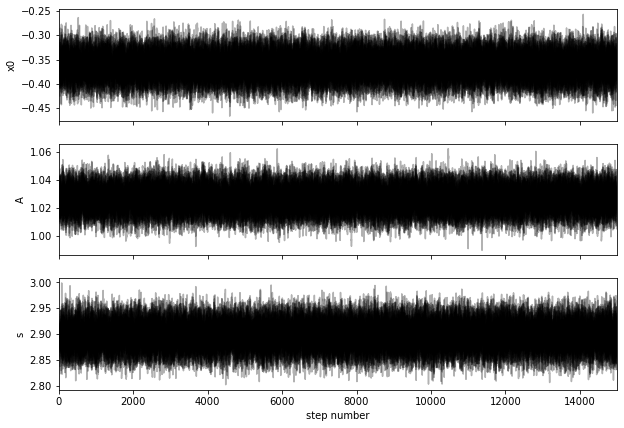

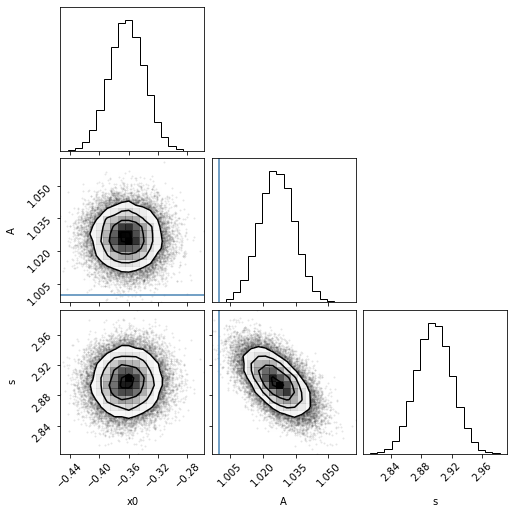

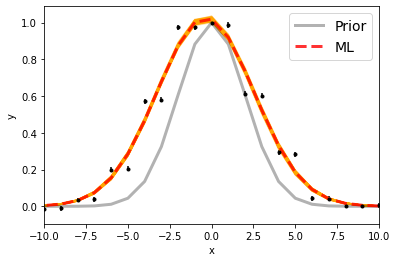

Maximum likelihood estimates:
x0 = -0.363
A = 1.026
s = 2.897


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.637304015767 [0.02376664 0.02420989]
A  =  6.334253712336064e-16 [4.90684362e-18 4.89281326e-18]
s  =  2.8970706408139675 [0.02322152 0.02367151]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


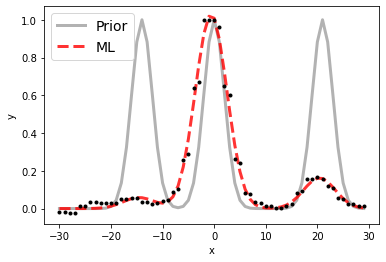

100%|██████████| 15000/15000 [00:28<00:00, 528.23it/s]


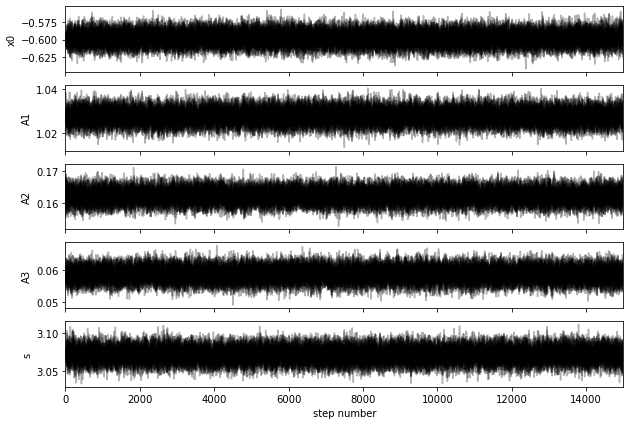

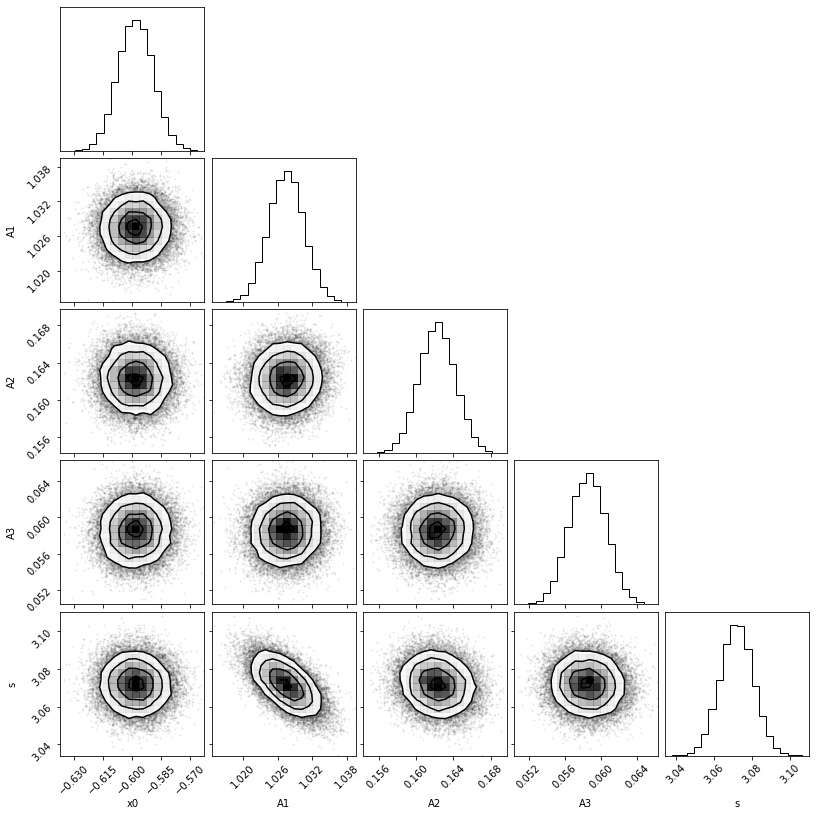

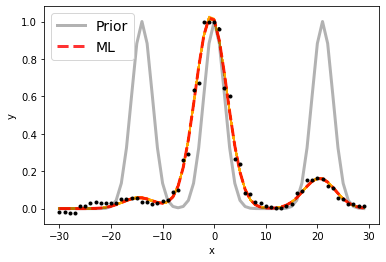

Maximum likelihood estimates:
x0 = -0.598
A1 = 1.027
A2 = 0.162
A3 = 0.059
s = 3.072


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.40196316764 6583.40196316764 [0.00903761 0.00906399]
A1, A2   =  7.123401046078915e-16 1.1249464043695906e-16 [2.11542612e-18 2.09291155e-18] [1.33392065e-18 1.35519281e-18]
s  =  3.071786560937274 [0.0087039  0.00863856]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 6

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


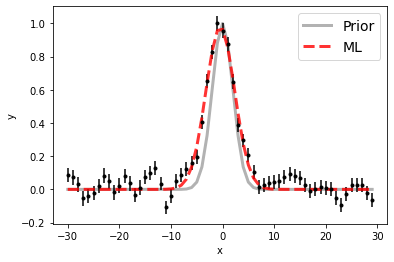

100%|██████████| 15000/15000 [00:18<00:00, 811.90it/s]


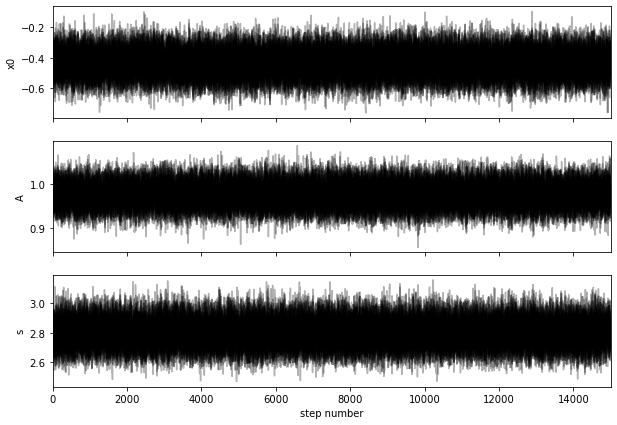

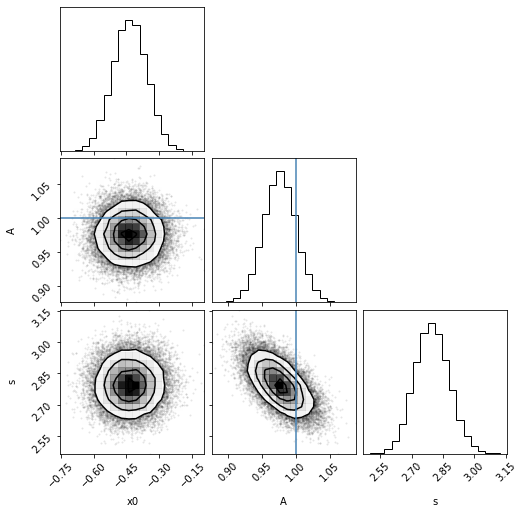

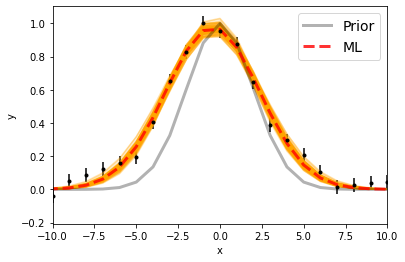

Maximum likelihood estimates:
x0 = -0.436
A = 0.977
s = 2.794


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.565185651821 [0.07675707 0.07807651]
A  =  1.9662395943518536e-16 [4.83913994e-18 4.82615395e-18]
s  =  2.795833593514976 [0.08040898 0.08368378]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


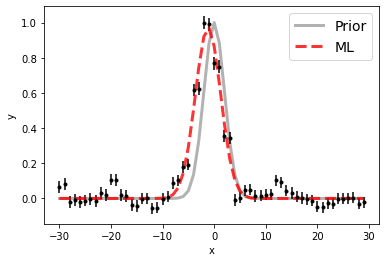

100%|██████████| 15000/15000 [00:18<00:00, 794.59it/s]


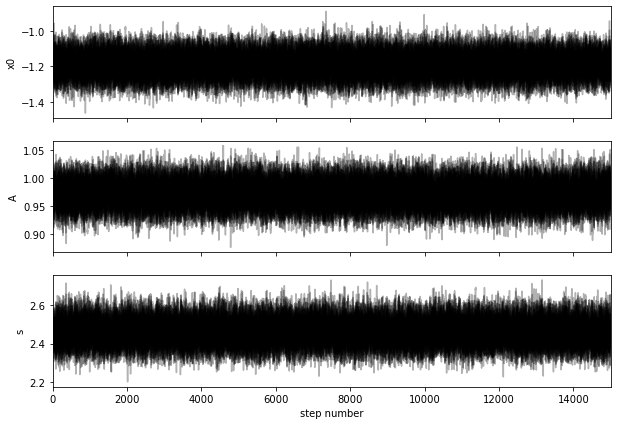

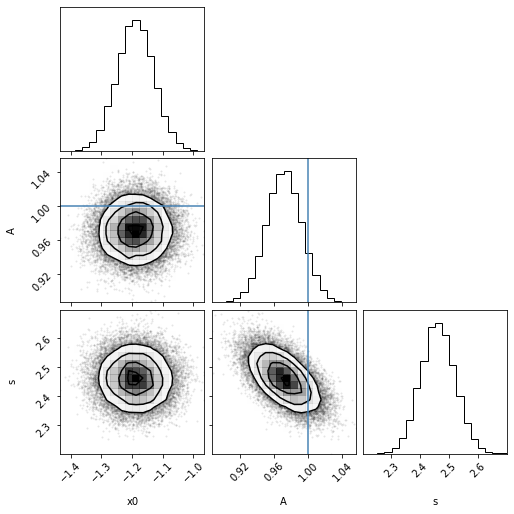

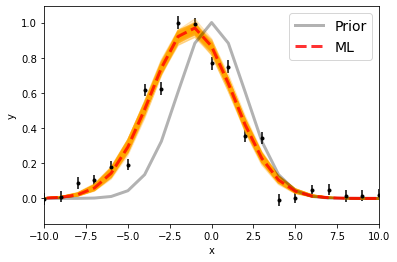

Maximum likelihood estimates:
x0 = -1.190
A = 0.972
s = 2.460


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.810469223648 [0.06047971 0.05914521]
A  =  2.3049744999297644e-16 [4.84133328e-18 4.88961155e-18]
s  =  2.4607265836558847 [0.0592081  0.05906784]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


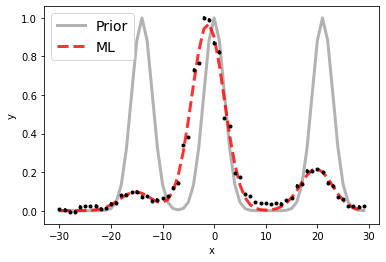

100%|██████████| 15000/15000 [00:29<00:00, 511.40it/s]


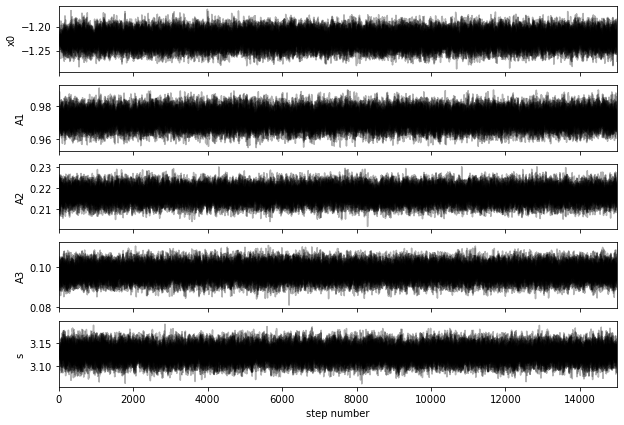

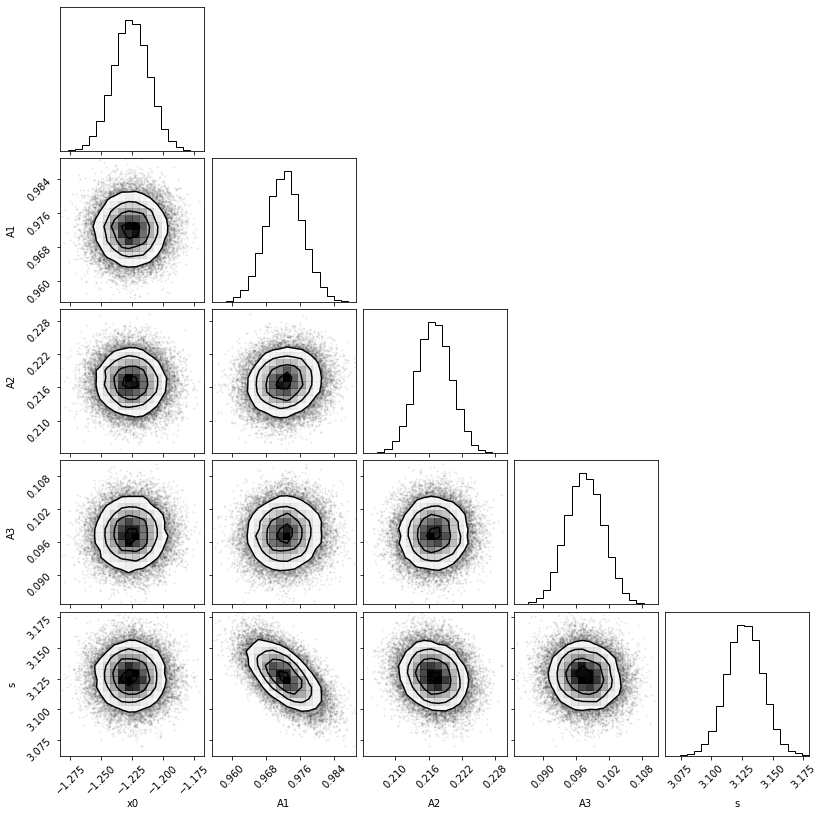

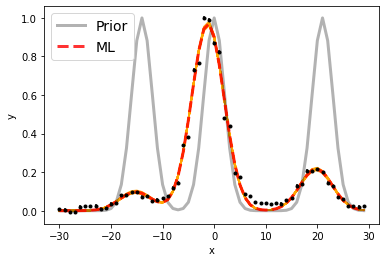

Maximum likelihood estimates:
x0 = -1.226
A1 = 0.972
A2 = 0.217
A3 = 0.098
s = 3.127


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.773918952656 6582.773918952656 [0.01437056 0.01441169]
A1, A2   =  4.296398940029354e-16 9.58703144546924e-17 [1.89365634e-18 1.90582818e-18] [1.38188194e-18 1.36585476e-18]
s  =  3.1269585150532047 [0.0143924  0.01460926]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 7

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


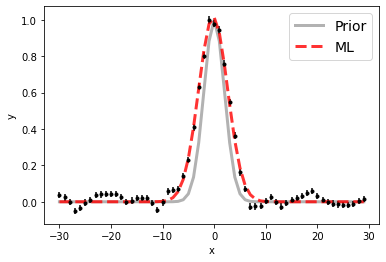

100%|██████████| 15000/15000 [00:19<00:00, 782.76it/s]


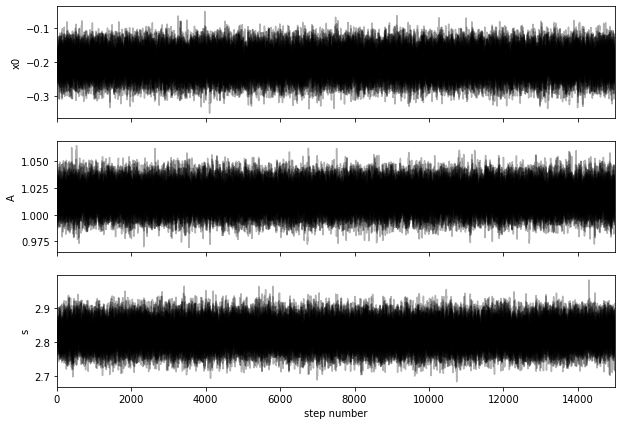

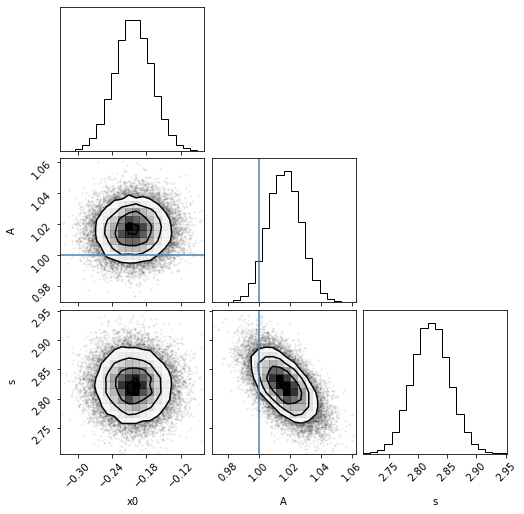

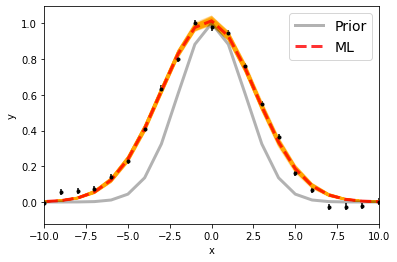

Maximum likelihood estimates:
x0 = -0.202
A = 1.017
s = 2.822


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.796744680415 [0.03210217 0.03268632]
A  =  4.587310700665796e-16 [4.79265738e-18 4.81587266e-18]
s  =  2.8222664001864937 [0.03162909 0.03201352]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


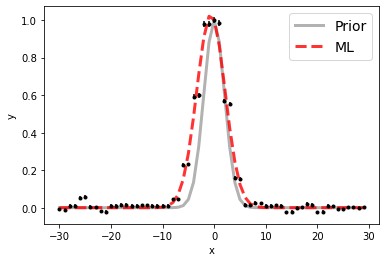

100%|██████████| 15000/15000 [00:18<00:00, 810.88it/s]


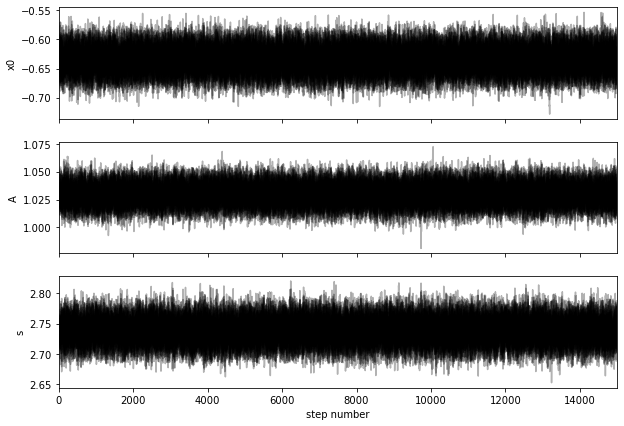

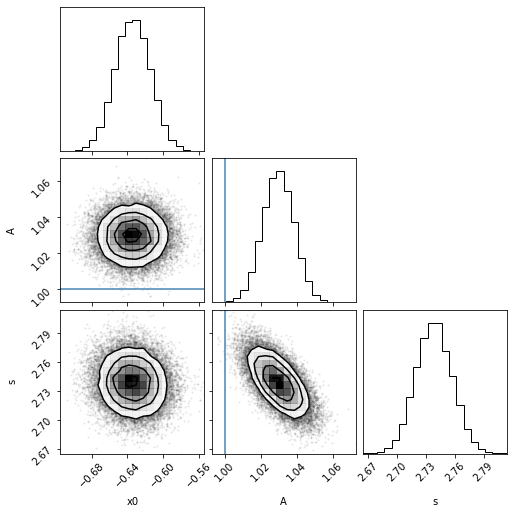

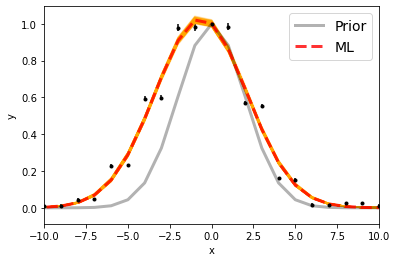

Maximum likelihood estimates:
x0 = -0.635
A = 1.030
s = 2.738


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.36572929297 [0.01981797 0.01972053]
A  =  7.94556476181598e-16 [6.66706569e-18 6.65936906e-18]
s  =  2.738489057480141 [0.01869895 0.01885331]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


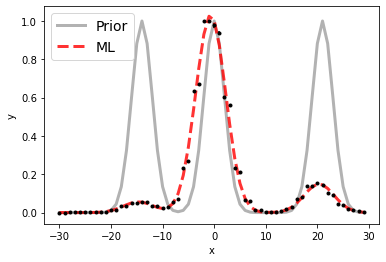

100%|██████████| 15000/15000 [00:28<00:00, 530.24it/s]


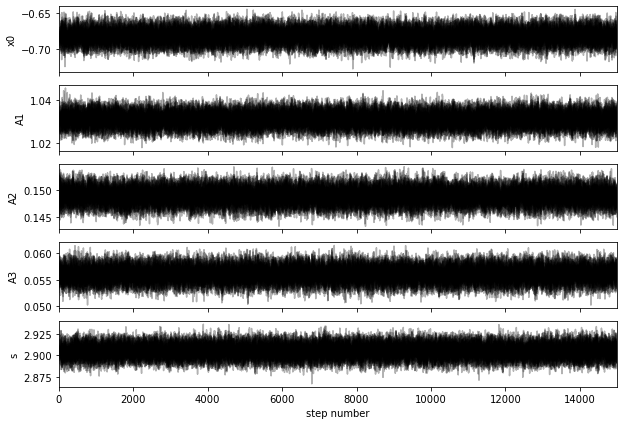

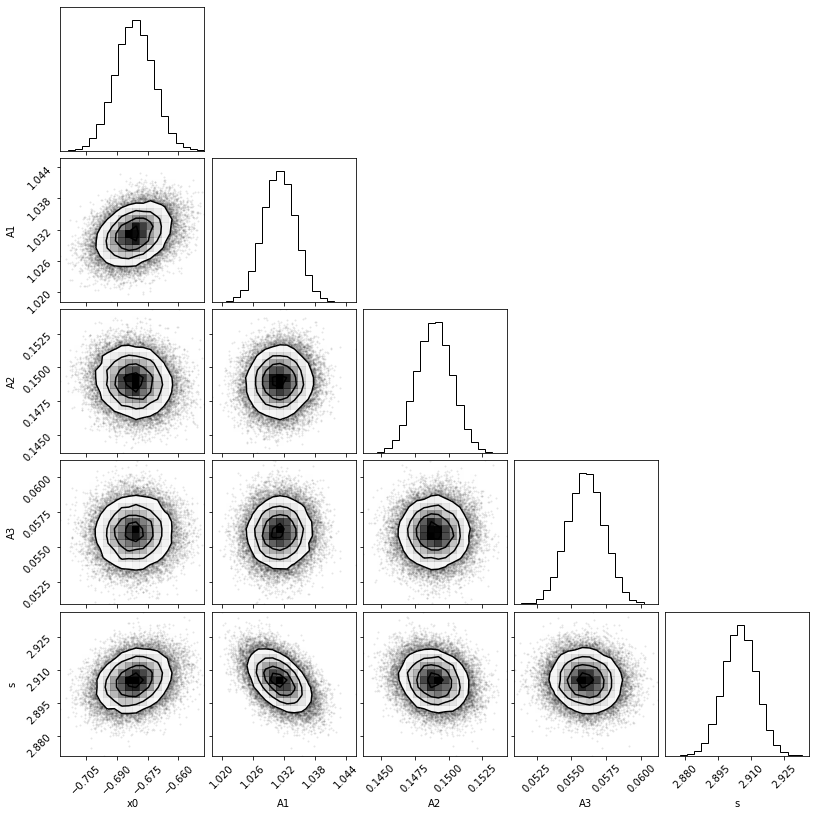

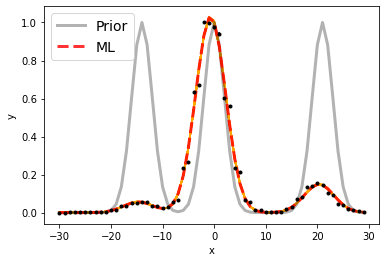

Maximum likelihood estimates:
x0 = -0.682
A1 = 1.031
A2 = 0.149
A3 = 0.056
s = 2.905


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.318414256342 6583.318414256342 [0.00917193 0.00915569]
A1, A2   =  1.0378621205961766e-15 1.4992315217295183e-16 [3.13705287e-18 3.18811382e-18] [1.33572400e-18 1.32391539e-18]
s  =  2.904981980894262 [0.00737118 0.00738424]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 8

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


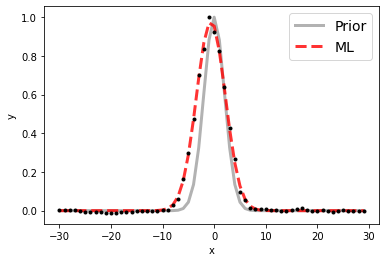

100%|██████████| 15000/15000 [00:18<00:00, 810.70it/s]


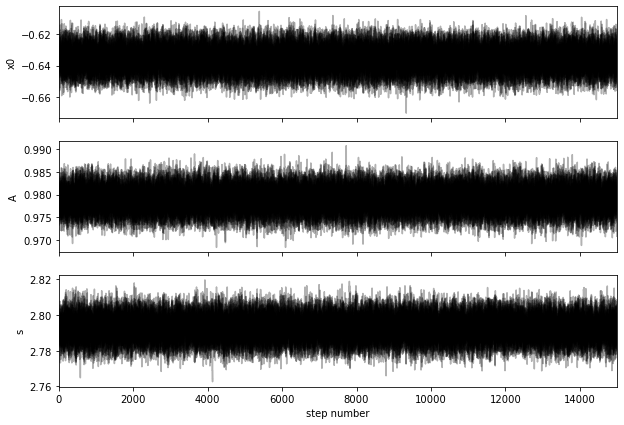

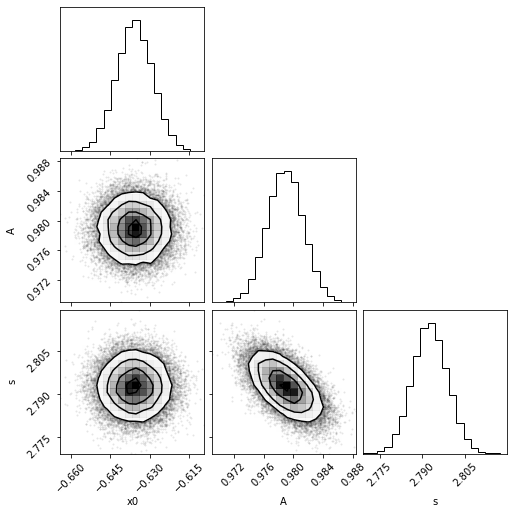

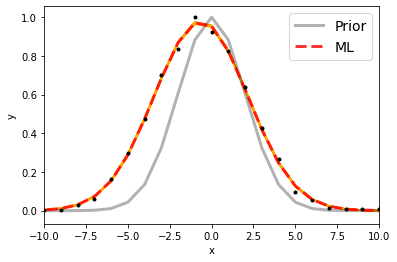

Maximum likelihood estimates:
x0 = -0.636
A = 0.979
s = 2.793


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.364180550961 [0.00684686 0.00687461]
A  =  3.4241314242667605e-15 [8.37736658e-18 8.42839358e-18]
s  =  2.792583433622865 [0.0060657  0.00627139]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


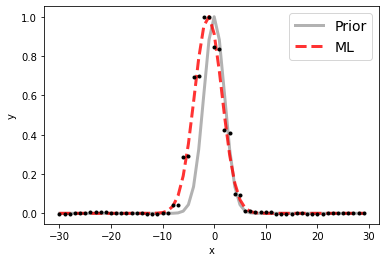

100%|██████████| 15000/15000 [00:18<00:00, 803.40it/s]


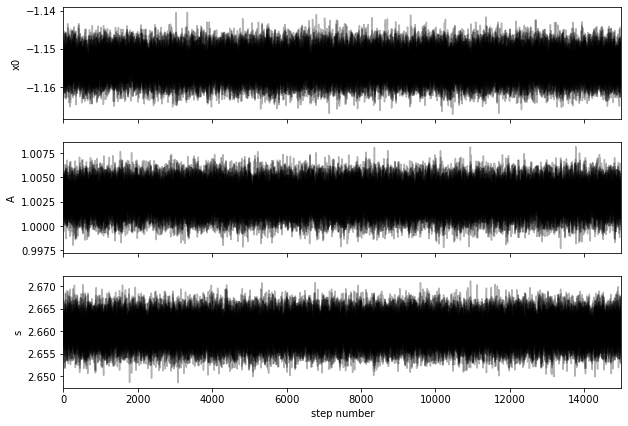

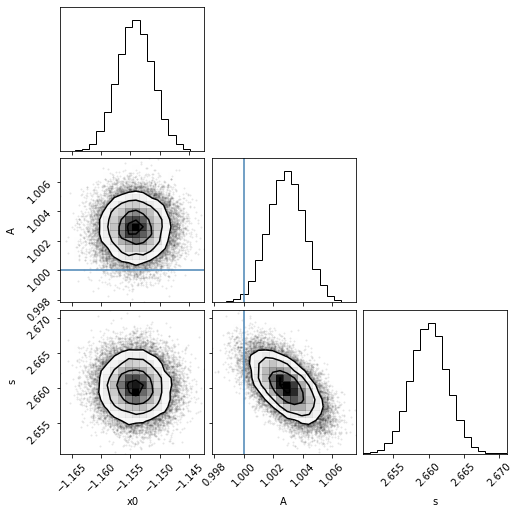

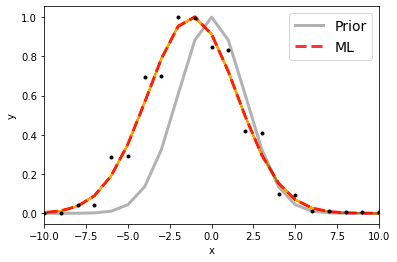

Maximum likelihood estimates:
x0 = -1.154
A = 1.003
s = 2.660


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.845797621675 [0.00302869 0.00307557]
A  =  8.809562270387002e-15 [1.08295205e-17 1.07373649e-17]
s  =  2.6601491263796464 [0.00255945 0.00260028]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


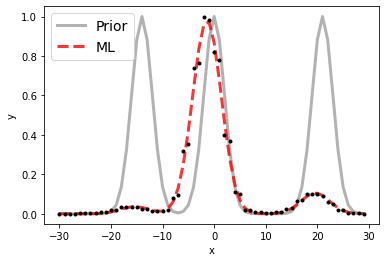

100%|██████████| 15000/15000 [00:28<00:00, 526.17it/s]


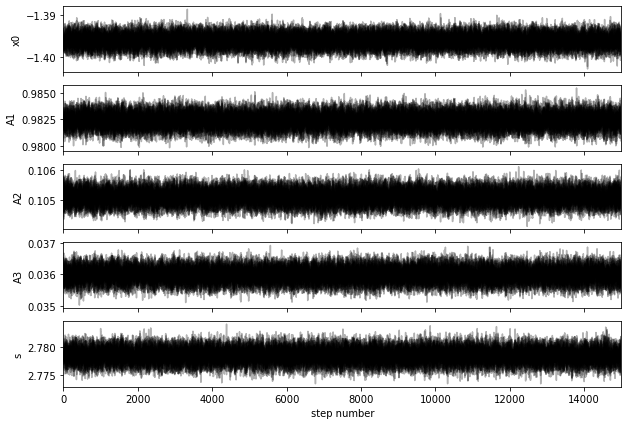

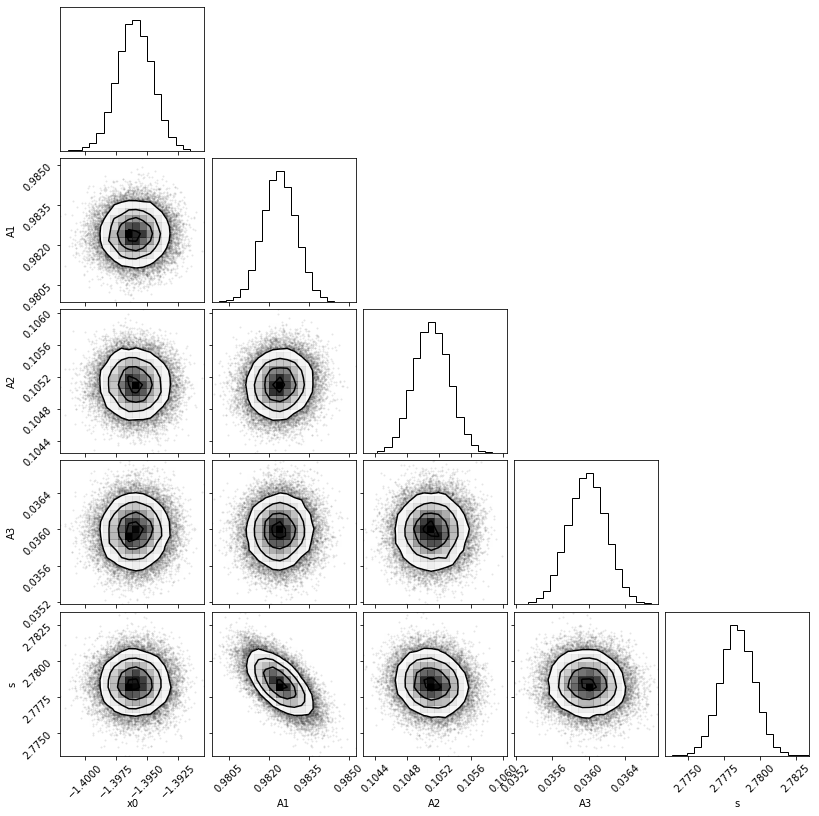

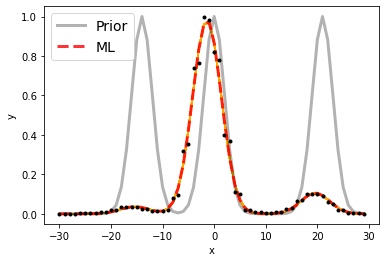

Maximum likelihood estimates:
x0 = -1.396
A1 = 0.982
A2 = 0.105
A3 = 0.036
s = 2.778


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.603976894566 6582.603976894566 [0.0013973  0.00140583]
A1, A2   =  8.538847101516621e-15 9.135139683180943e-16 [5.38463932e-18 5.43393402e-18] [1.90555234e-18 1.94521942e-18]
s  =  2.7784110922196663 [0.00113591 0.00117766]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 9

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


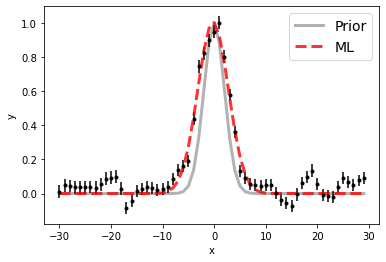

100%|██████████| 15000/15000 [00:18<00:00, 805.81it/s]


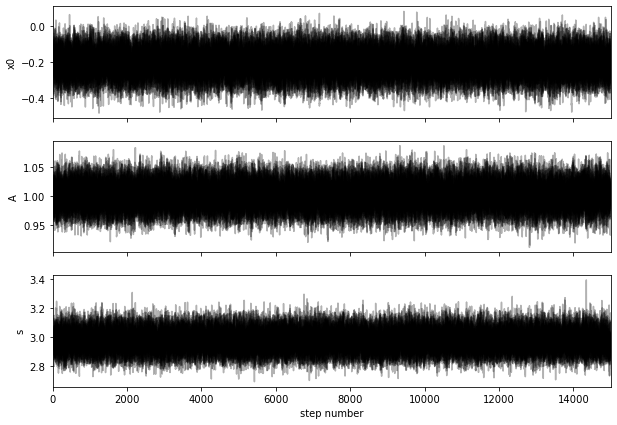

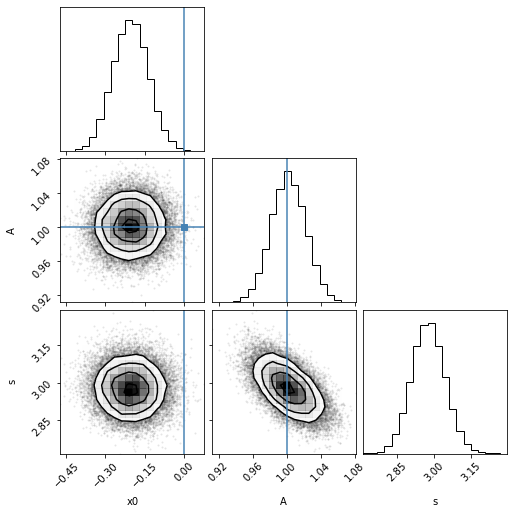

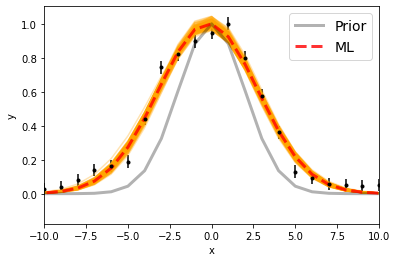

Maximum likelihood estimates:
x0 = -0.205
A = 1.003
s = 2.975


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.795865718028 [0.06878705 0.06759047]
A  =  2.3414463183768264e-16 [4.65983895e-18 4.81257794e-18]
s  =  2.977010571164455 [0.0663575  0.06744962]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


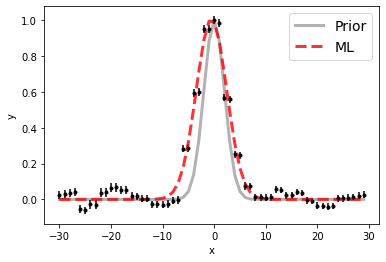

100%|██████████| 15000/15000 [00:18<00:00, 806.07it/s]


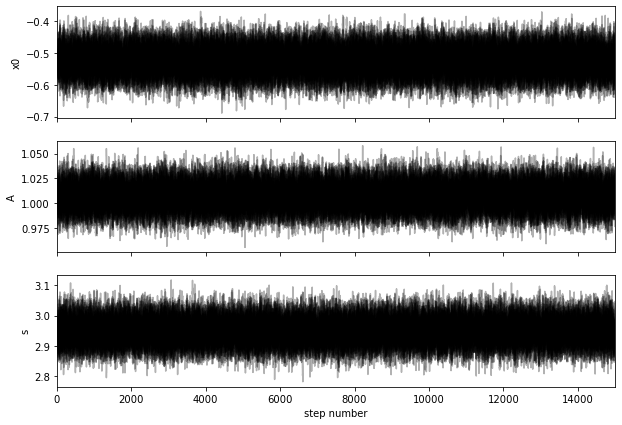

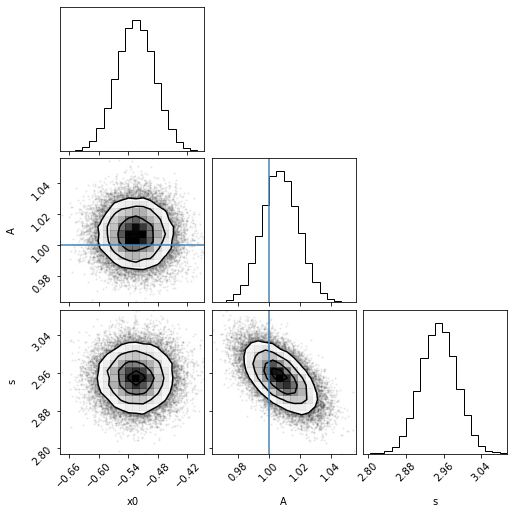

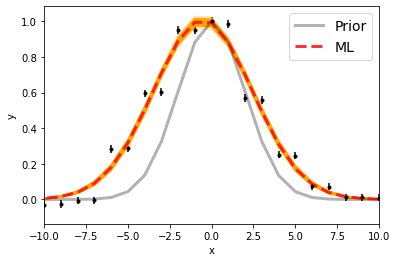

Maximum likelihood estimates:
x0 = -0.525
A = 1.008
s = 2.949


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.475242336404 [0.03842148 0.03816844]
A  =  3.768081150553827e-16 [4.33729291e-18 4.51696442e-18]
s  =  2.9495928512128335 [0.03759983 0.03773705]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


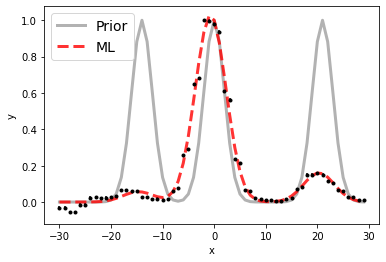

100%|██████████| 15000/15000 [00:28<00:00, 523.55it/s]


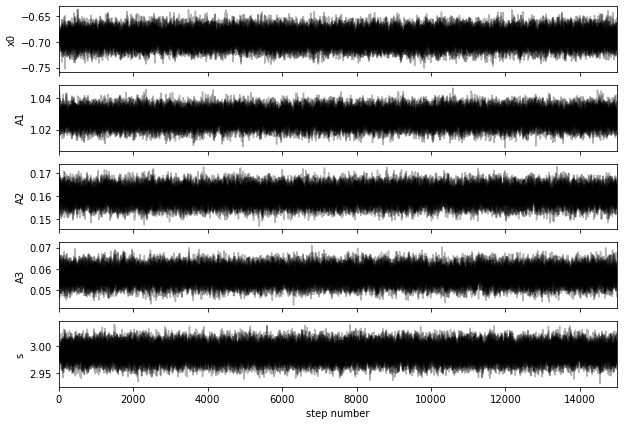

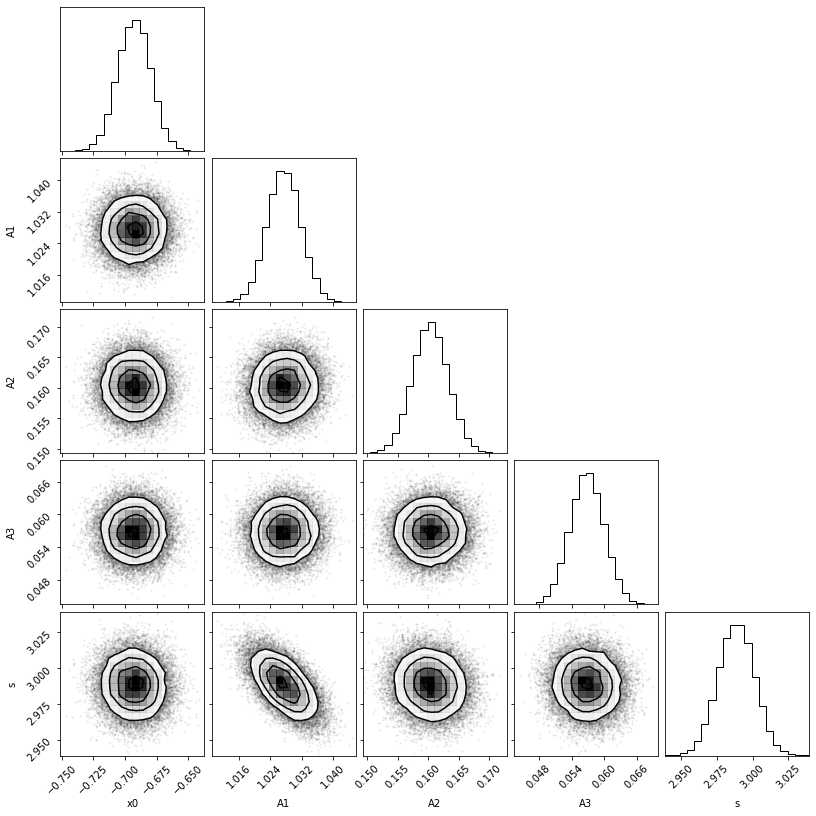

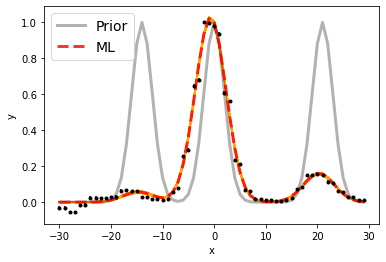

Maximum likelihood estimates:
x0 = -0.693
A1 = 1.028
A2 = 0.160
A3 = 0.057
s = 2.989


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.3072158221485 6583.3072158221485 [0.01312141 0.0129417 ]
A1, A2   =  4.611709537840014e-16 7.194797636032228e-17 [1.87896650e-18 1.92346943e-18] [1.29153164e-18 1.32276347e-18]
s  =  2.988593919139771 [0.01259879 0.01259026]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 10

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


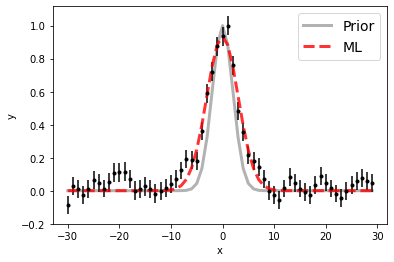

100%|██████████| 15000/15000 [00:19<00:00, 751.90it/s]


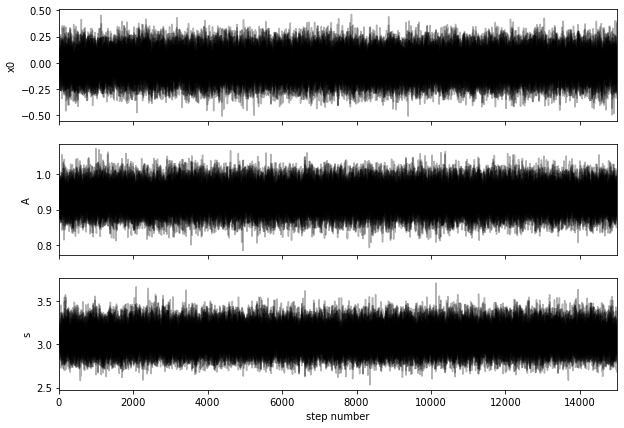

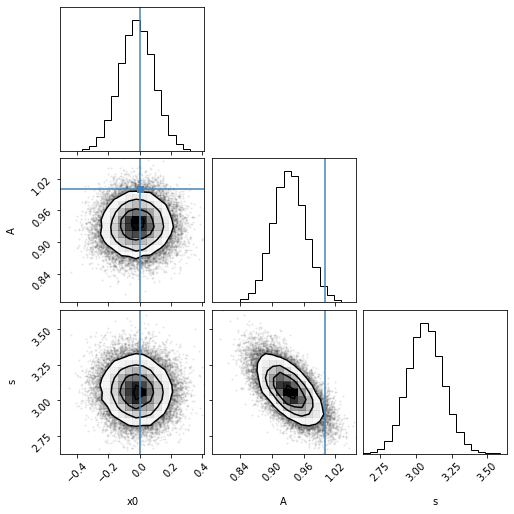

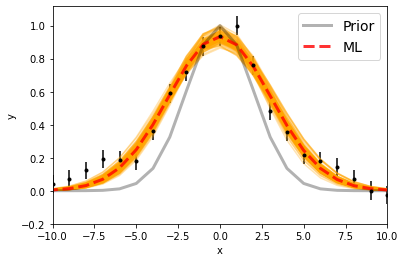

Maximum likelihood estimates:
x0 = -0.018
A = 0.934
s = 3.062


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.982536122876 [0.11092445 0.10935531]
A  =  1.2938732525537312e-16 [4.27741548e-18 4.31665043e-18]
s  =  3.0673334563560113 [0.12175711 0.12535468]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


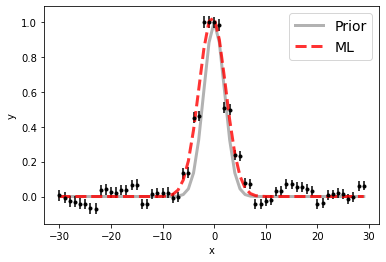

100%|██████████| 15000/15000 [00:21<00:00, 708.66it/s]


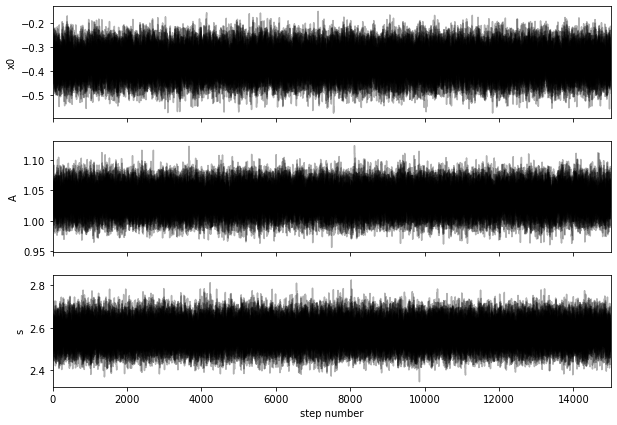

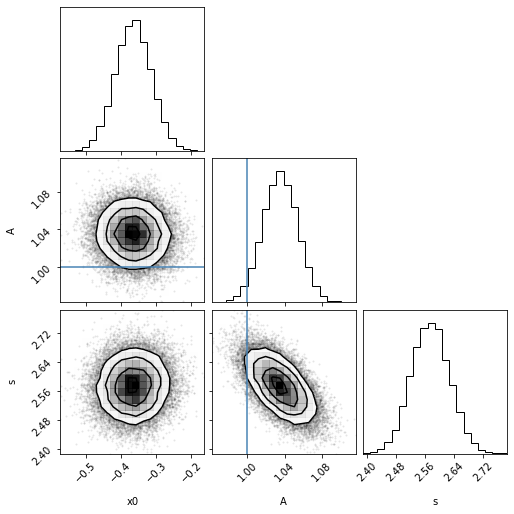

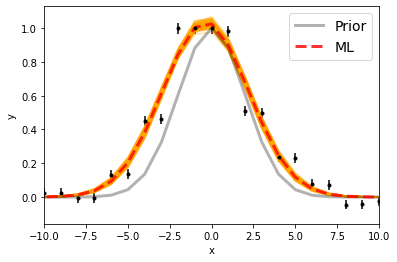

Maximum likelihood estimates:
x0 = -0.365
A = 1.035
s = 2.573


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.634946039969 [0.05114264 0.05084455]
A  =  2.3713281471828584e-16 [4.29776671e-18 4.29707258e-18]
s  =  2.573398450380913 [0.05243053 0.05289829]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


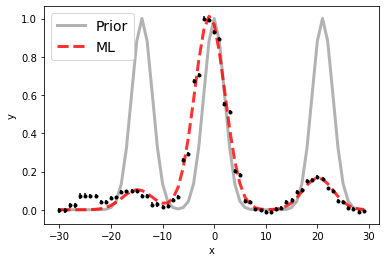

100%|██████████| 15000/15000 [00:55<00:00, 268.91it/s]


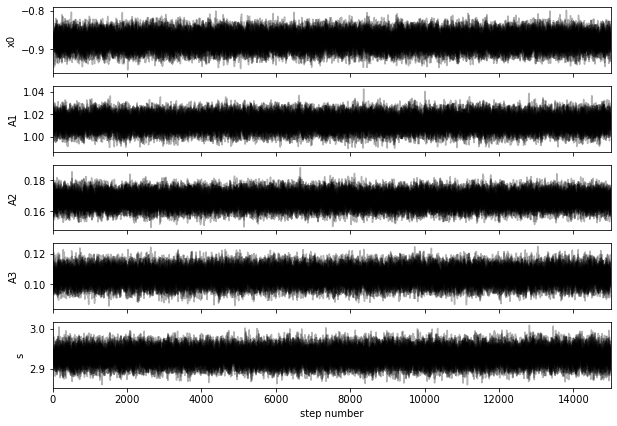

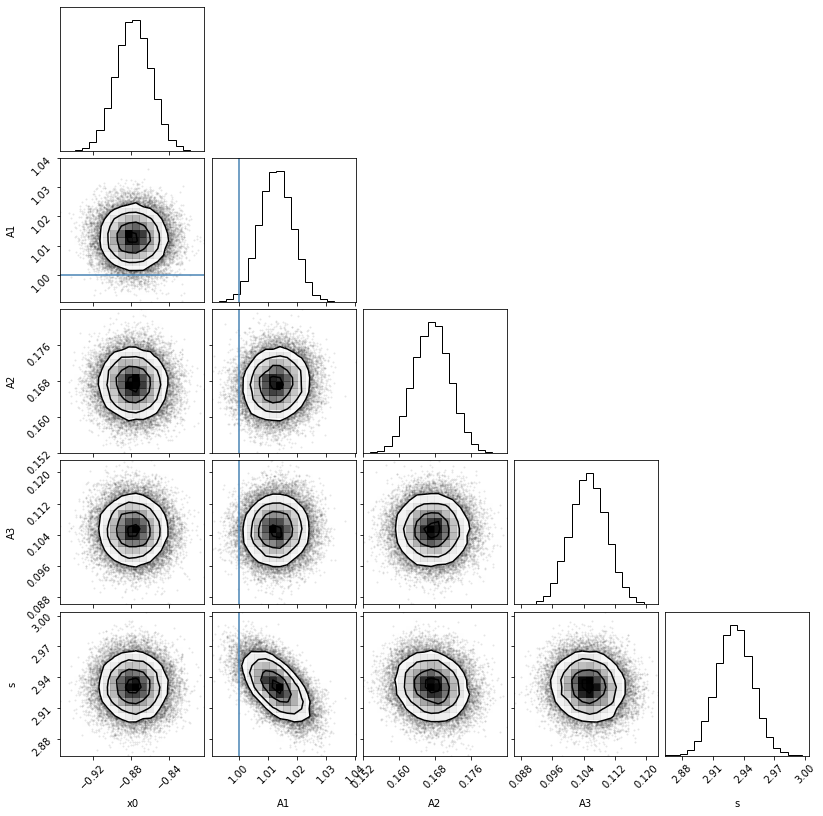

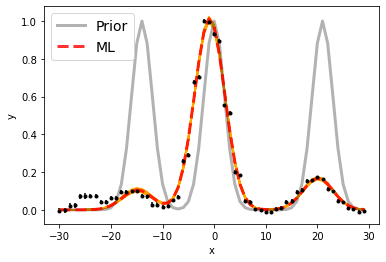

Maximum likelihood estimates:
x0 = -0.877
A1 = 1.013
A2 = 0.167
A3 = 0.105
s = 2.931


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.122509941199 6583.122509941199 [0.01784831 0.01798472]
A1, A2   =  2.907525960213508e-16 4.802936311893289e-17 [1.62269653e-18 1.64555392e-18] [1.17497128e-18 1.15087402e-18]
s  =  2.9311620014402537 [0.01698966 0.017026  ]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 11

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


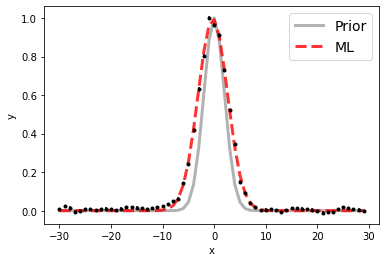

100%|██████████| 15000/15000 [00:45<00:00, 331.46it/s]


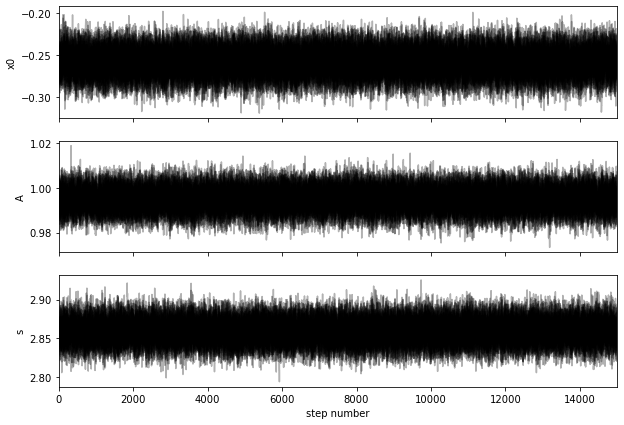

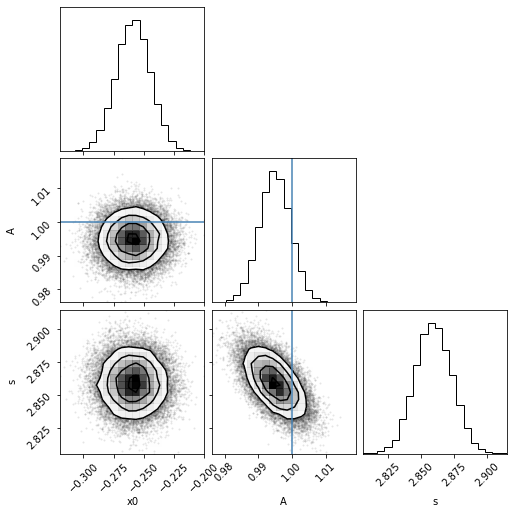

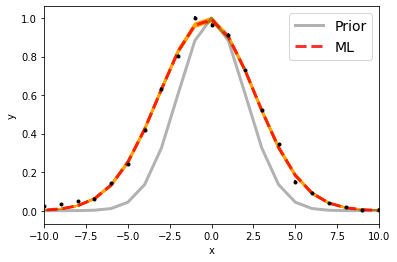

Maximum likelihood estimates:
x0 = -0.259
A = 0.995
s = 2.860


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.741278095349 [0.01430509 0.01414612]
A  =  1.4087924787791887e-15 [6.49598445e-18 6.54817645e-18]
s  =  2.8590191923486694 [0.01349701 0.0141561 ]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


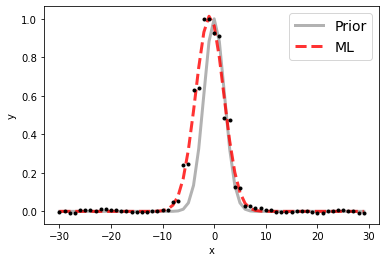

100%|██████████| 15000/15000 [00:44<00:00, 336.63it/s]


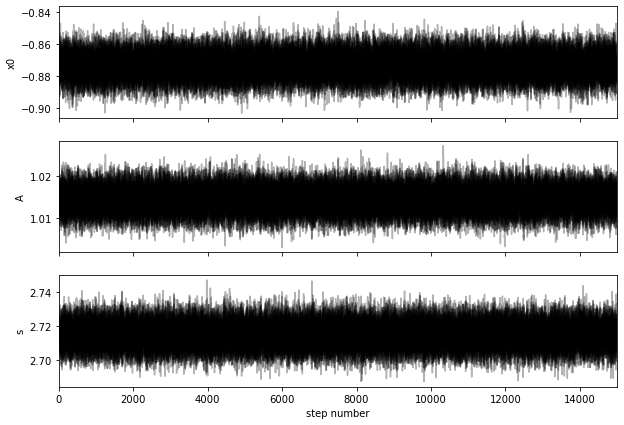

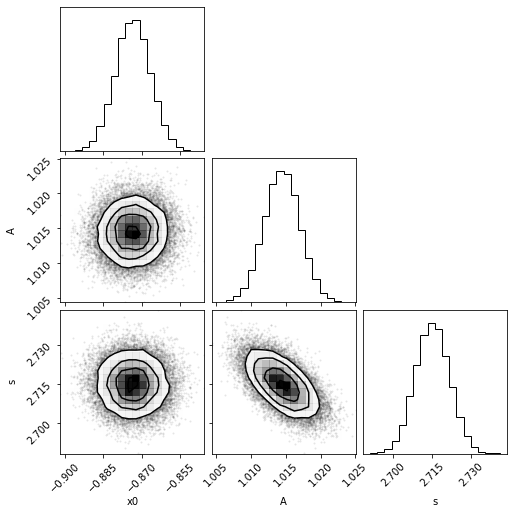

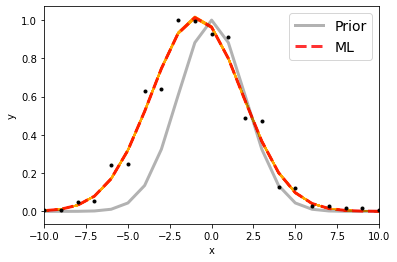

Maximum likelihood estimates:
x0 = -0.874
A = 1.014
s = 2.715


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.126545606389 [0.00686577 0.0068732 ]
A  =  2.9472195122384243e-15 [7.53938036e-18 7.43343132e-18]
s  =  2.7149749748154797 [0.00654224 0.00661667]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


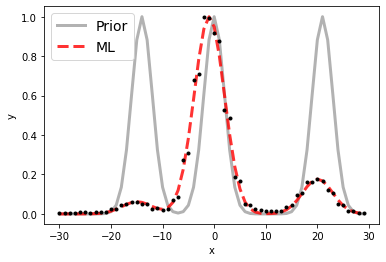

100%|██████████| 15000/15000 [01:08<00:00, 219.89it/s]


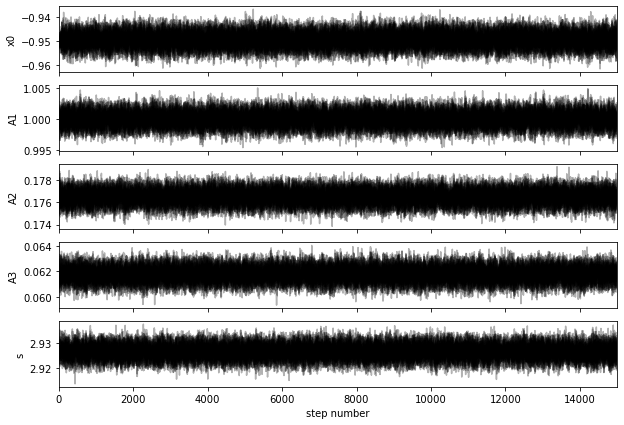

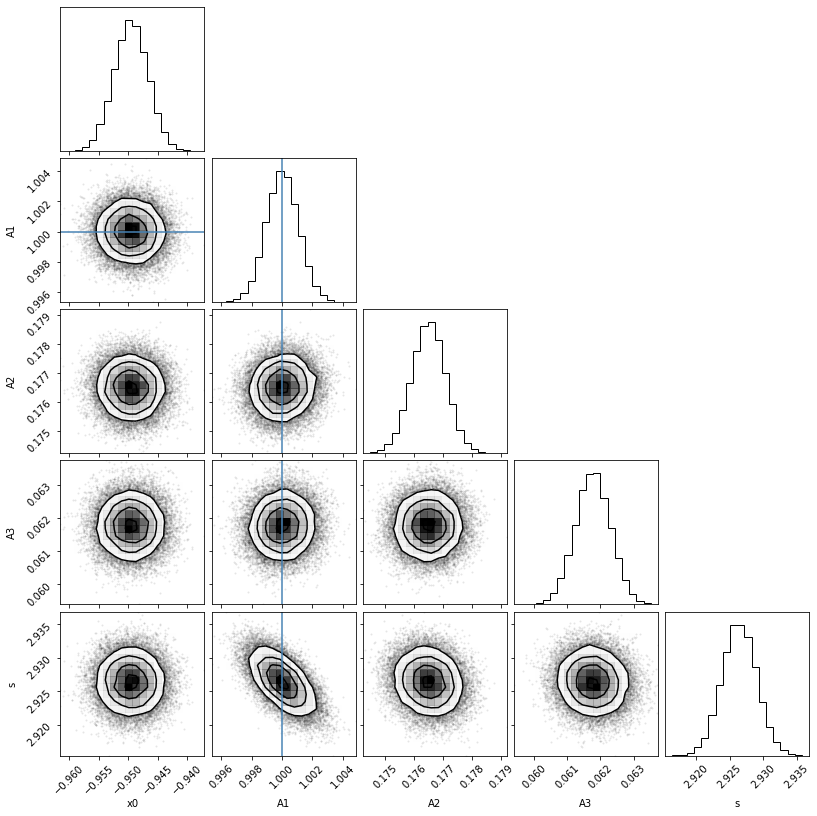

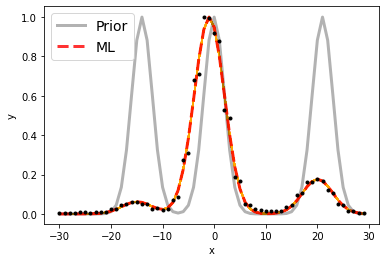

Maximum likelihood estimates:
x0 = -0.950
A1 = 1.000
A2 = 0.176
A3 = 0.062
s = 2.926


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.050456731387 6583.050456731387 [0.00289836 0.00284325]
A1, A2   =  3.2494148289396708e-15 5.734836821506583e-16 [3.50909114e-18 3.49918951e-18] [1.92325188e-18 1.89358847e-18]
s  =  2.926398128765671 [0.00257131 0.00258235]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 12

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


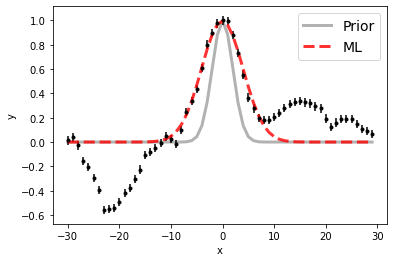

100%|██████████| 15000/15000 [00:44<00:00, 338.03it/s]


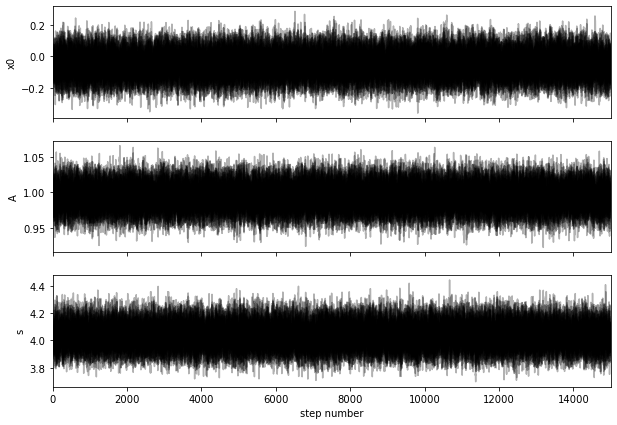

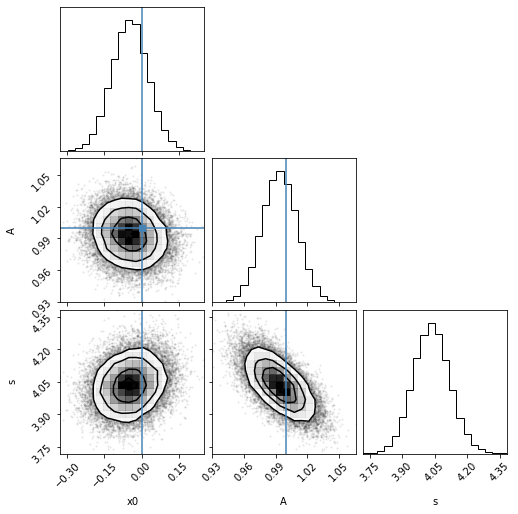

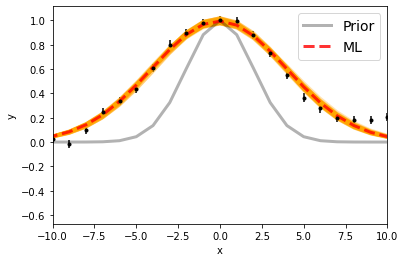

Maximum likelihood estimates:
x0 = -0.049
A = 0.994
s = 4.032


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.952124139224 [0.07313433 0.07324094]
A  =  2.7649545850375947e-16 [4.56376340e-18 4.62907169e-18]
s  =  4.035019495295867 [0.08280612 0.08312891]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


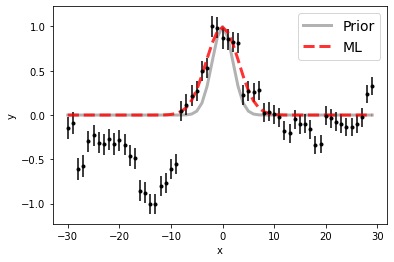

100%|██████████| 15000/15000 [00:44<00:00, 333.80it/s]


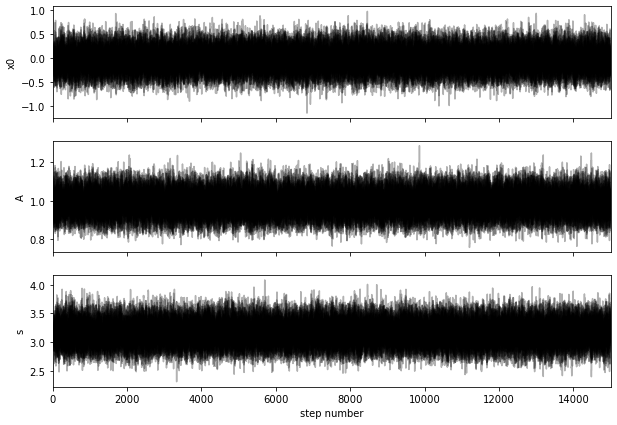

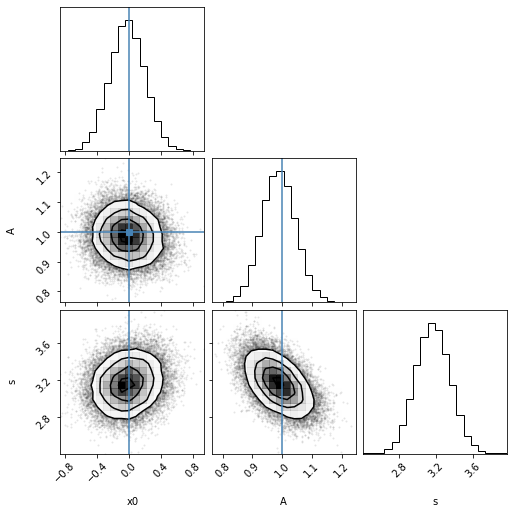

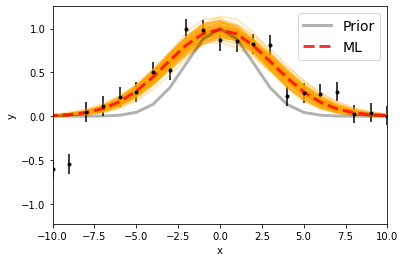

Maximum likelihood estimates:
x0 = -0.027
A = 0.990
s = 3.157


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.974698620049 [0.21869329 0.21787428]
A  =  7.215041112976319e-17 [4.09295491e-18 4.14577953e-18]
s  =  3.1619668316035145 [0.18497691 0.1882256 ]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


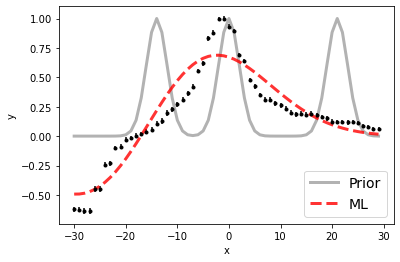

  0%|          | 0/15000 [00:00<?, ?it/s]C:\Users\saruk\anaconda3\lib\site-packages\emcee\moves\red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 15000/15000 [00:23<00:00, 646.05it/s]


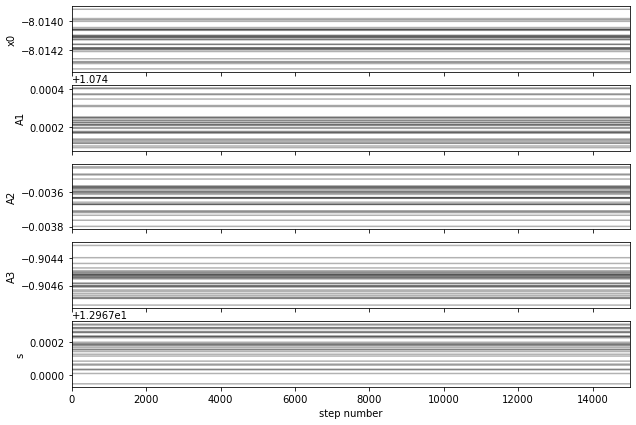

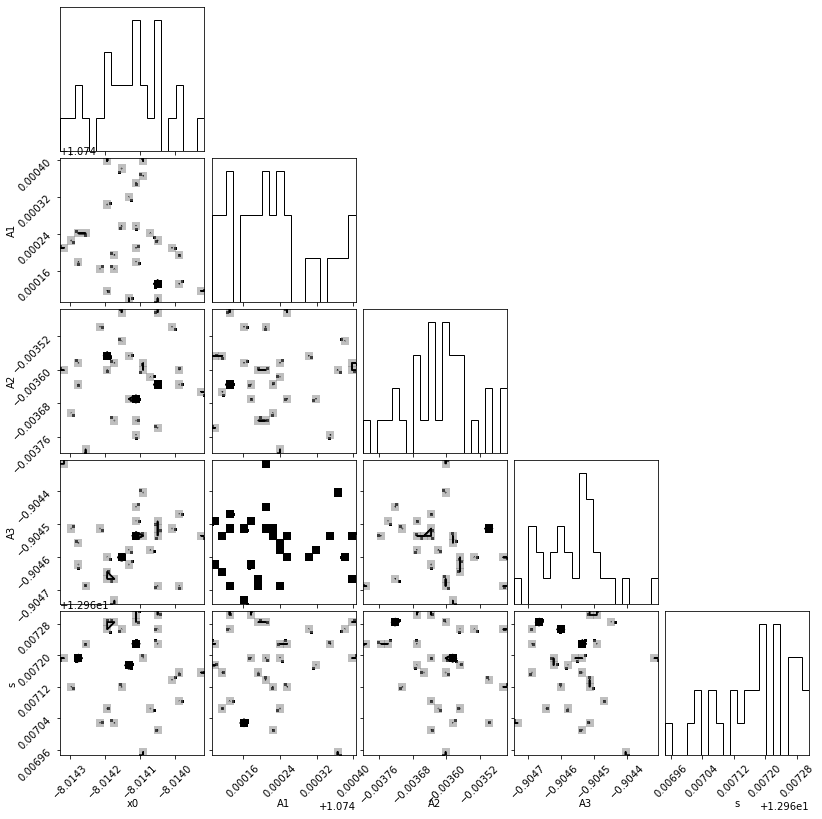

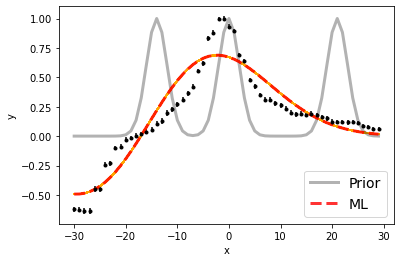

Maximum likelihood estimates:
x0 = -8.014
A1 = 1.074
A2 = -0.004
A3 = -0.905
s = 12.967


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6554.98588151792 6575.98588151792 [1.39003491e-04 7.62088857e-05]
A1, A2   =  1.9125181834617002e-16 -6.428113869958509e-19 [1.56456175e-20 2.38172692e-20] [1.83486625e-20 1.50117497e-20]
s  =  12.967186801746347 [1.26504794e-04 9.65407082e-05]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 13

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


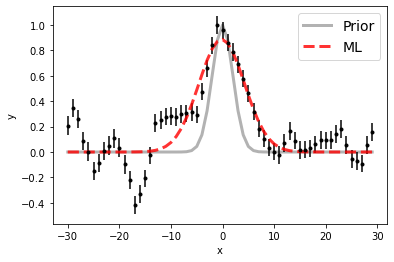

100%|██████████| 15000/15000 [00:45<00:00, 332.01it/s]


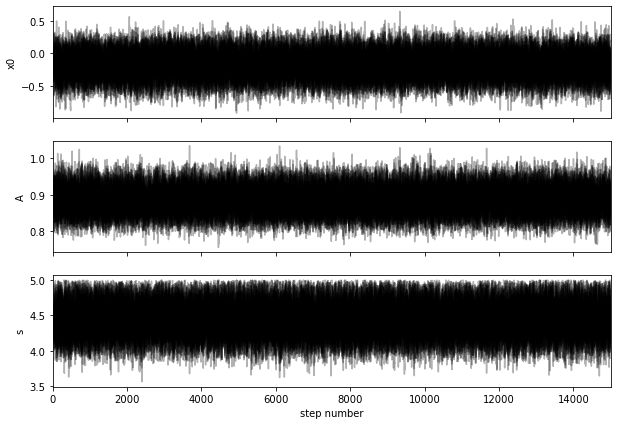

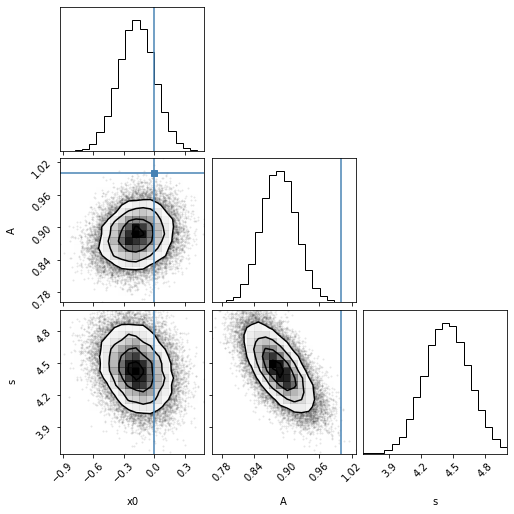

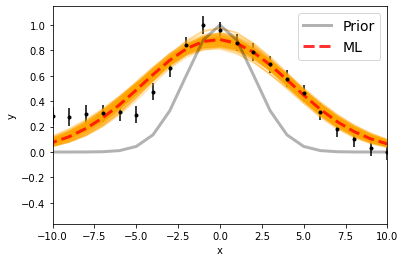

Maximum likelihood estimates:
x0 = -0.169
A = 0.886
s = 4.427


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.82720581641 [0.17803902 0.17742265]
A  =  1.0904139244340272e-16 [3.89401381e-18 3.99910939e-18]
s  =  4.439070168755622 [0.20749277 0.2124003 ]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


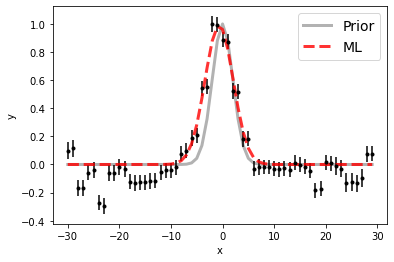

100%|██████████| 15000/15000 [00:44<00:00, 334.08it/s]


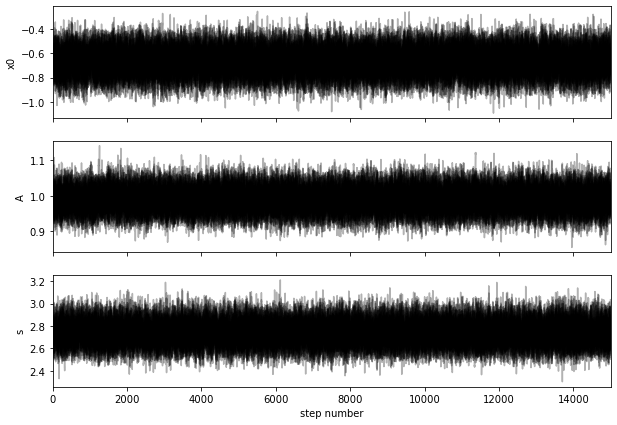

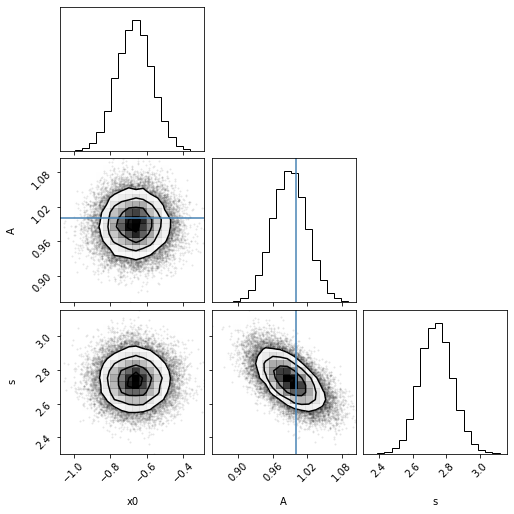

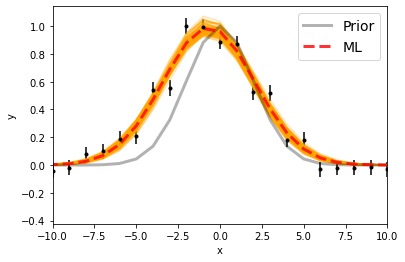

Maximum likelihood estimates:
x0 = -0.667
A = 0.991
s = 2.735


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.333859645305 [0.09780379 0.09583018]
A  =  1.383474545501209e-16 [4.23675610e-18 4.21346175e-18]
s  =  2.7378561099247634 [0.09432708 0.09664112]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


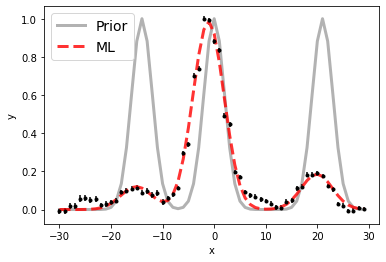

100%|██████████| 15000/15000 [01:09<00:00, 215.78it/s]


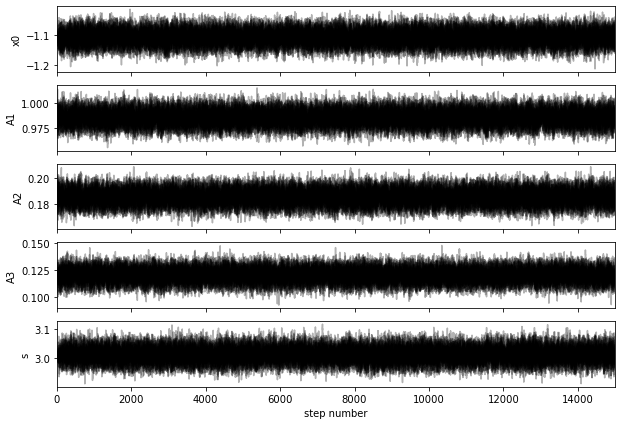

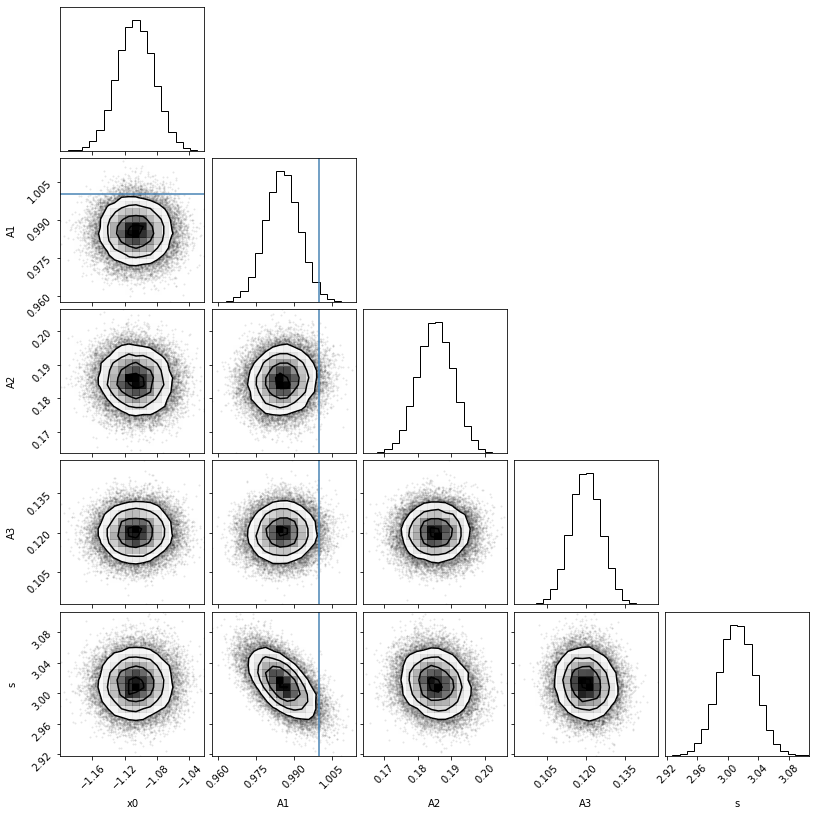

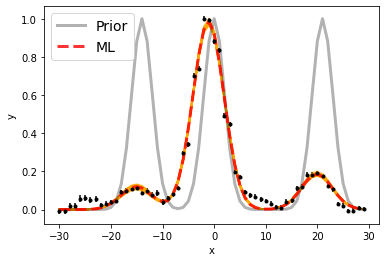

Maximum likelihood estimates:
x0 = -1.107
A1 = 0.985
A2 = 0.185
A3 = 0.120
s = 3.012


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.893493237523 6582.893493237523 [0.02287043 0.02283296]
A1, A2   =  2.523514369110726e-16 4.7454079225332913e-17 [1.71863221e-18 1.71974943e-18] [1.34408135e-18 1.34980608e-18]
s  =  3.0120699994134643 [0.02309126 0.02358023]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 14

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


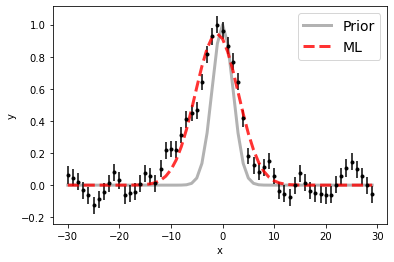

100%|██████████| 15000/15000 [00:44<00:00, 337.94it/s]


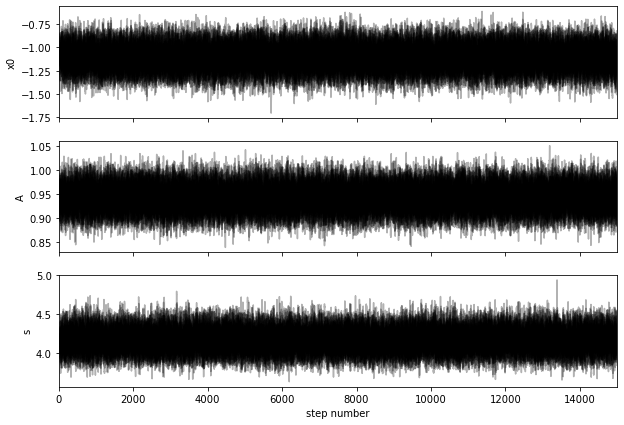

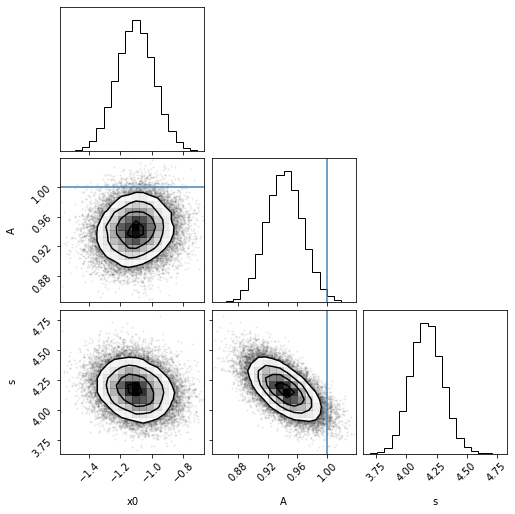

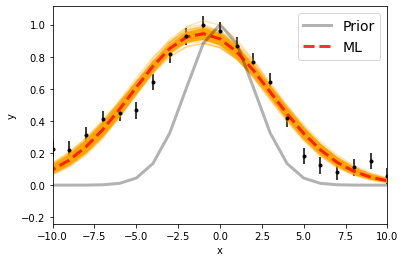

Maximum likelihood estimates:
x0 = -1.105
A = 0.944
s = 4.162


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4859.894737895627 [0.11982142 0.11918424]
A  =  1.7107922376025342e-16 [4.41458297e-18 4.38685710e-18]
s  =  4.167400769223574 [0.13038728 0.13354013]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


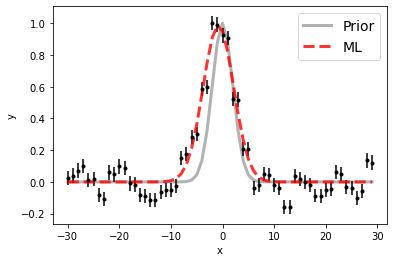

100%|██████████| 15000/15000 [00:44<00:00, 339.42it/s]


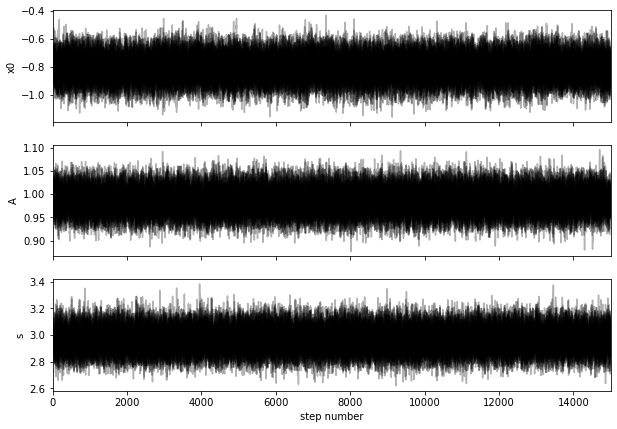

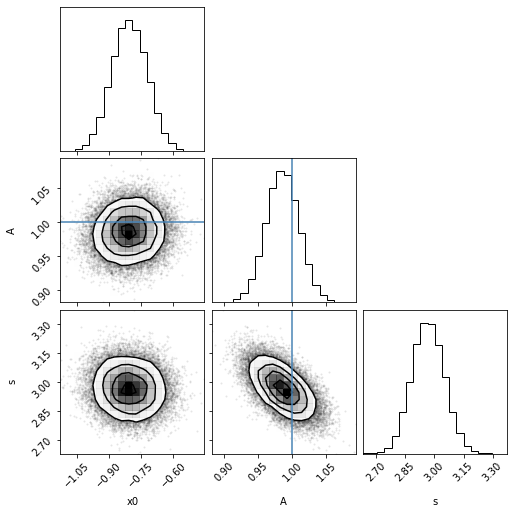

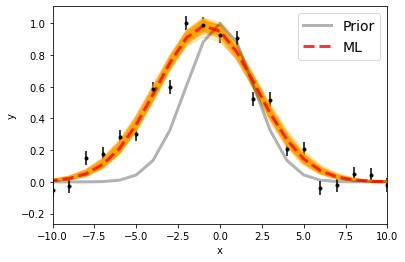

Maximum likelihood estimates:
x0 = -0.806
A = 0.986
s = 2.963


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.1940405234955 [0.08259263 0.08388177]
A  =  1.9093841916721889e-16 [4.67887627e-18 4.75771258e-18]
s  =  2.9655667410221005 [0.08216756 0.08398746]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


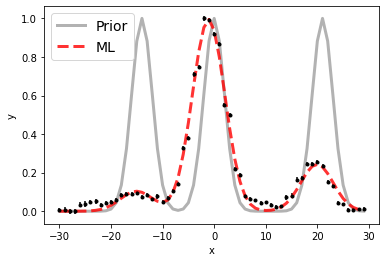

100%|██████████| 15000/15000 [01:09<00:00, 215.52it/s]


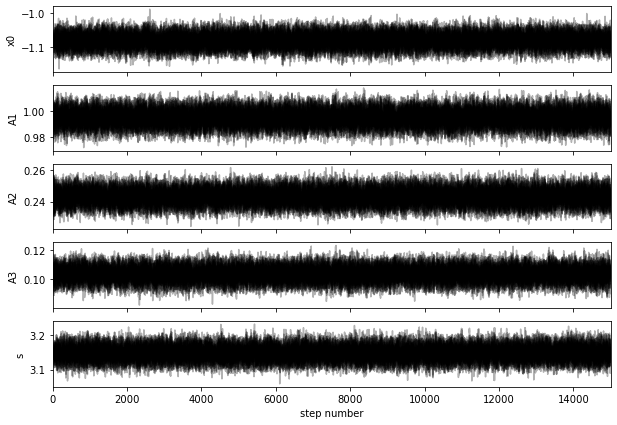

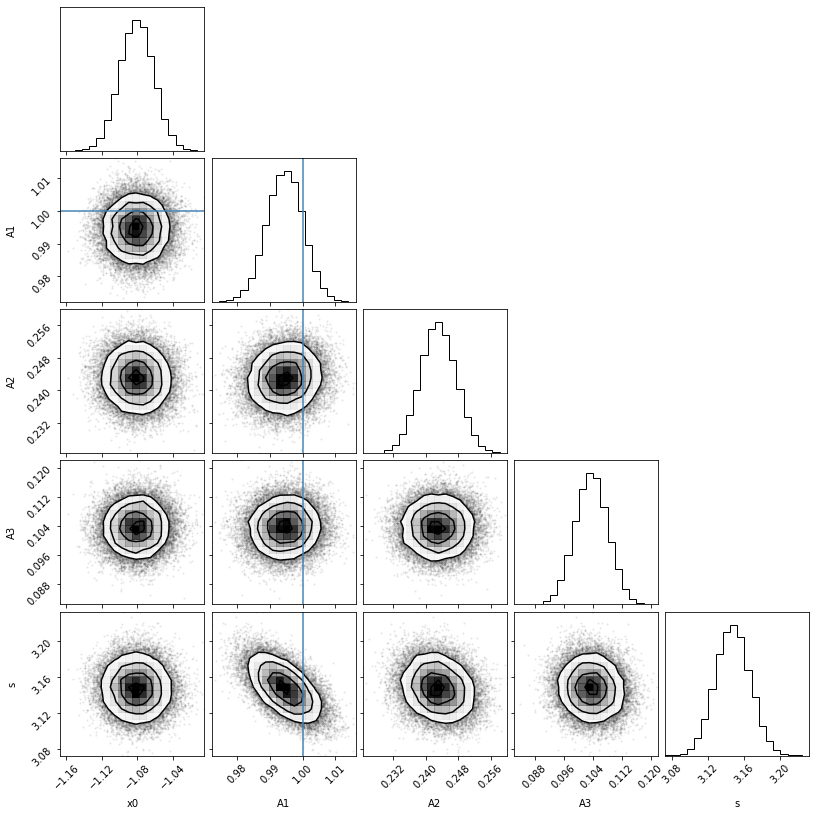

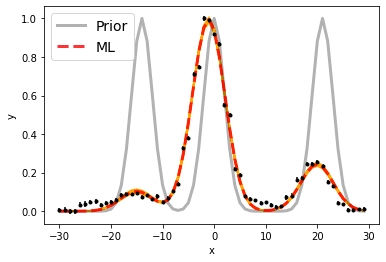

Maximum likelihood estimates:
x0 = -1.081
A1 = 0.994
A2 = 0.243
A3 = 0.104
s = 3.148


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.919055227426 6582.919055227426 [0.01908879 0.01890002]
A1, A2   =  3.421815529969704e-16 8.361573120367425e-17 [1.93073216e-18 1.88999215e-18] [1.49952096e-18 1.53495883e-18]
s  =  3.14755250787832 [0.01891973 0.01916809]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 15

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


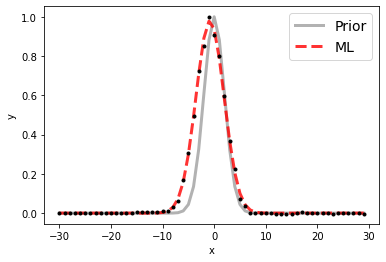

100%|██████████| 15000/15000 [00:46<00:00, 319.19it/s]


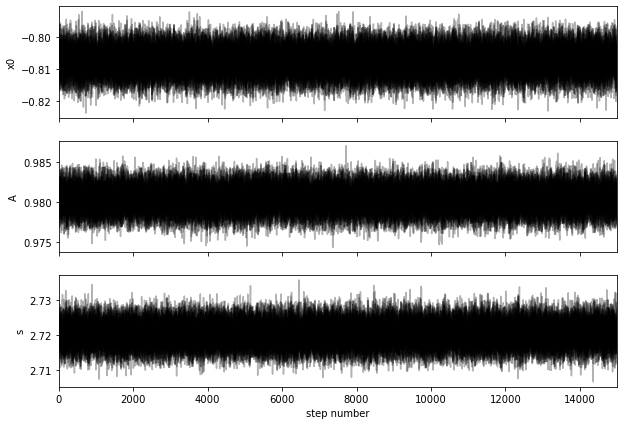

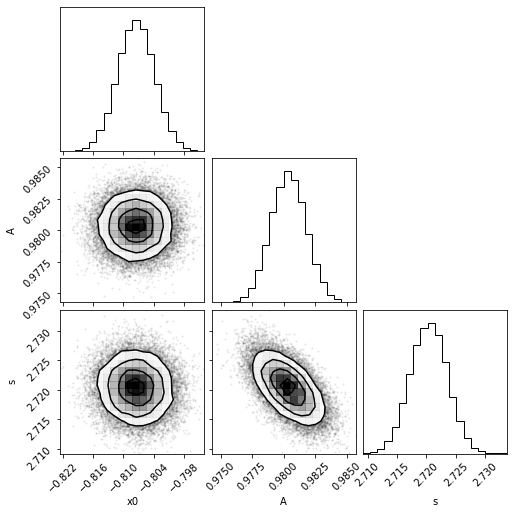

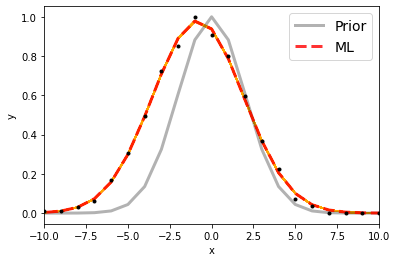

Maximum likelihood estimates:
x0 = -0.807
A = 0.980
s = 2.720


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.1924942661 [0.00368256 0.00365331]
A  =  8.613818158876952e-15 [1.22660598e-17 1.21828417e-17]
s  =  2.7203979023829605 [0.00318429 0.00312173]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


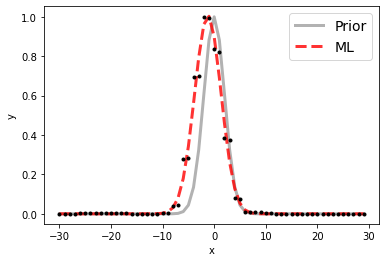

100%|██████████| 15000/15000 [00:45<00:00, 327.47it/s]


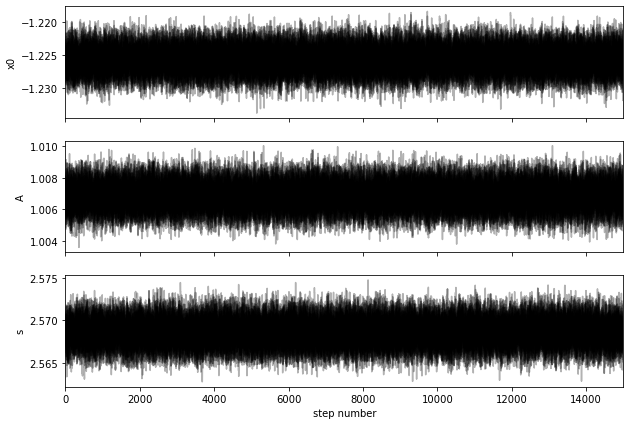

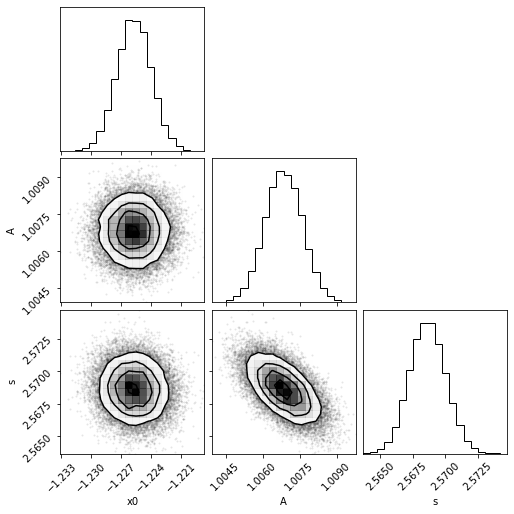

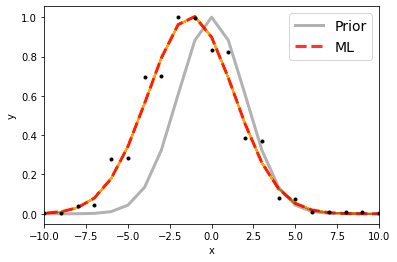

Maximum likelihood estimates:
x0 = -1.226
A = 1.007
s = 2.569


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.774247894134 [0.00172312 0.00172026]
A  =  2.3835235463763222e-14 [1.77983528e-17 1.79476754e-17]
s  =  2.5686162541265154 [0.00138313 0.00140672]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


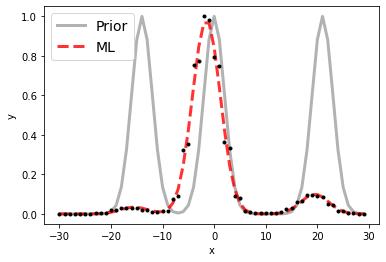

100%|██████████| 15000/15000 [00:40<00:00, 373.91it/s]


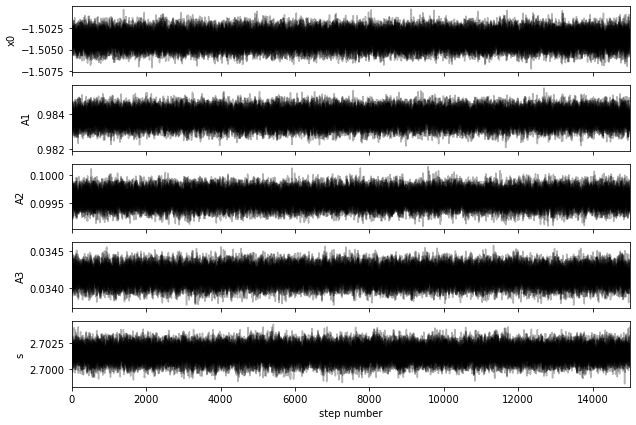

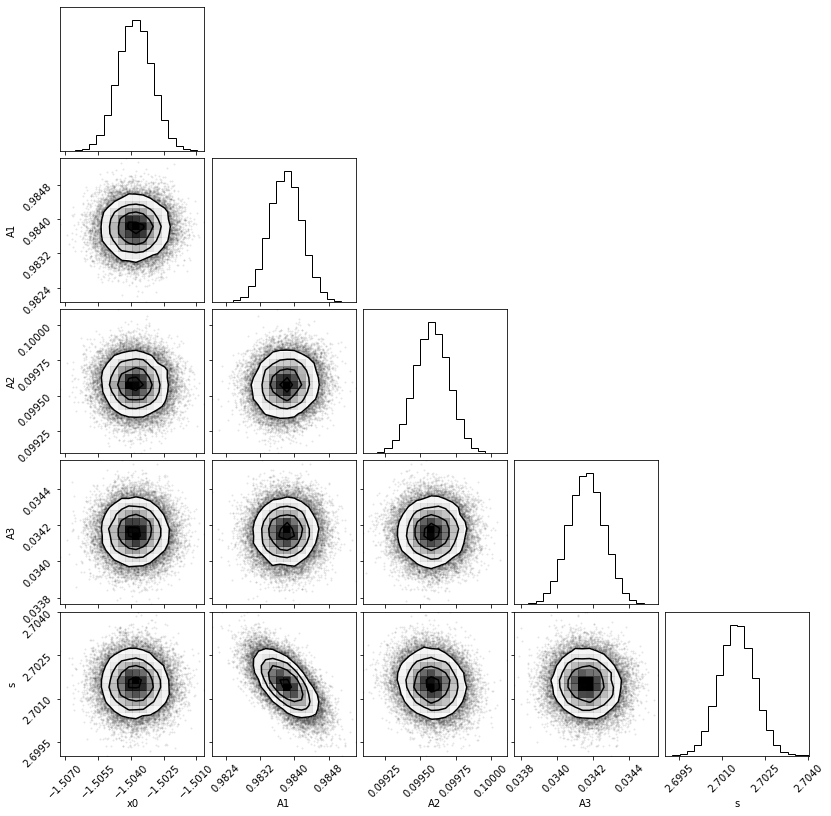

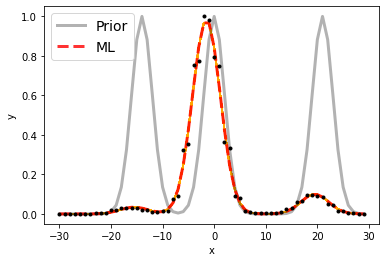

Maximum likelihood estimates:
x0 = -1.504
A1 = 0.984
A2 = 0.100
A3 = 0.034
s = 2.702


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.49618494764 6582.49618494764 [0.00077783 0.00078457]
A1, A2   =  2.3151198403497894e-14 2.343452573856107e-15 [9.02156472e-18 8.90284662e-18] [2.80459405e-18 2.82525189e-18]
s  =  2.7015105563127624 [0.00061043 0.00061296]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 16

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


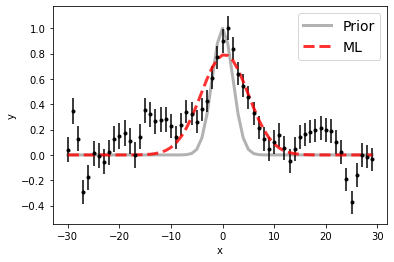

100%|██████████| 15000/15000 [00:17<00:00, 866.00it/s]


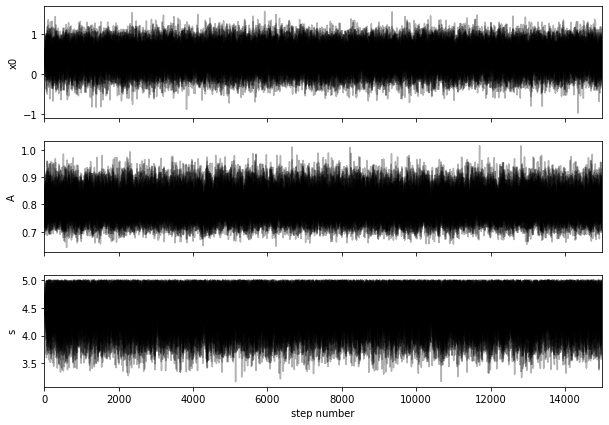

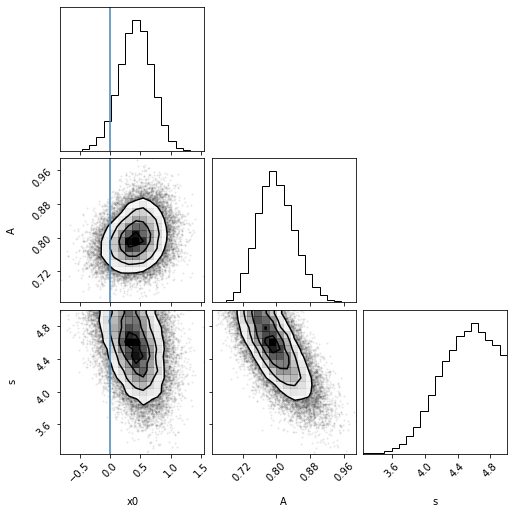

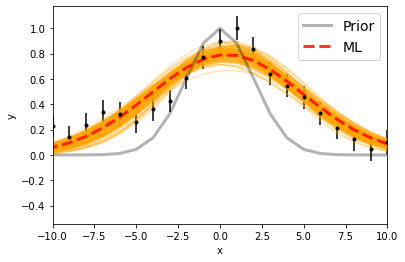

Maximum likelihood estimates:
x0 = 0.403
A = 0.793
s = 4.571


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.419560845552 [0.27436766 0.26319588]
A  =  6.766911754825711e-17 [3.50739655e-18 3.93230785e-18]
s  =  4.5231302486816745 [0.35878808 0.30604058]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


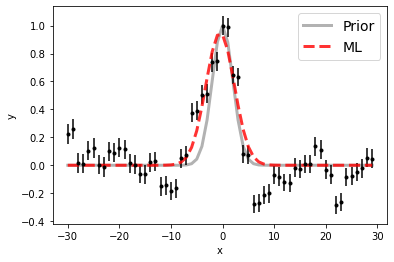

100%|██████████| 15000/15000 [00:17<00:00, 878.43it/s]


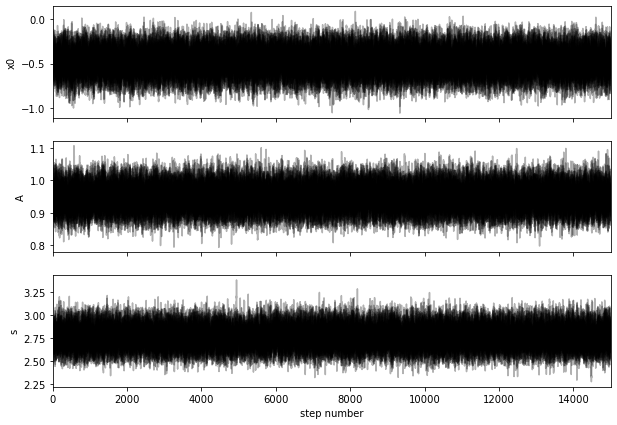

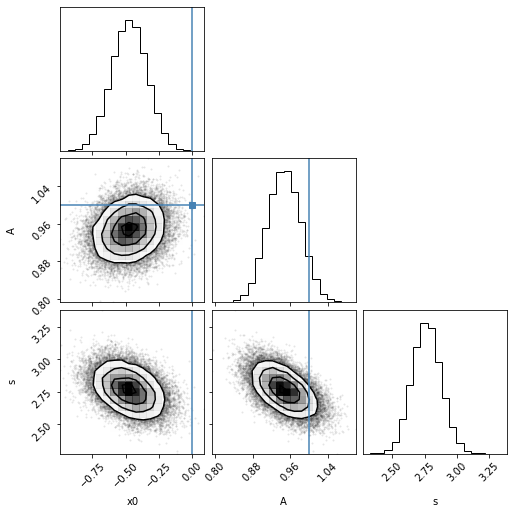

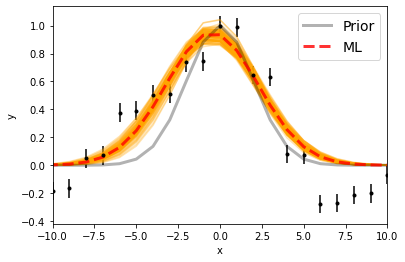

Maximum likelihood estimates:
x0 = -0.474
A = 0.948
s = 2.761


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.525915383221 [0.13397998 0.13264262]
A  =  1.018771731558505e-16 [3.83508816e-18 3.87448068e-18]
s  =  2.7629692423487997 [0.1105064  0.11267989]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


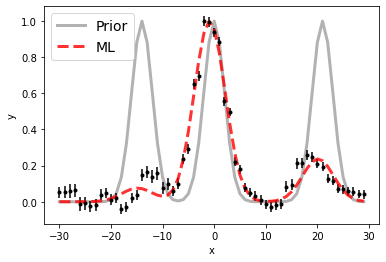

100%|██████████| 15000/15000 [00:26<00:00, 573.54it/s]


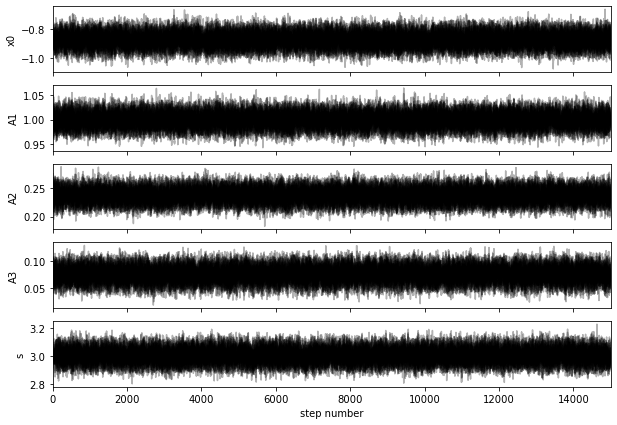

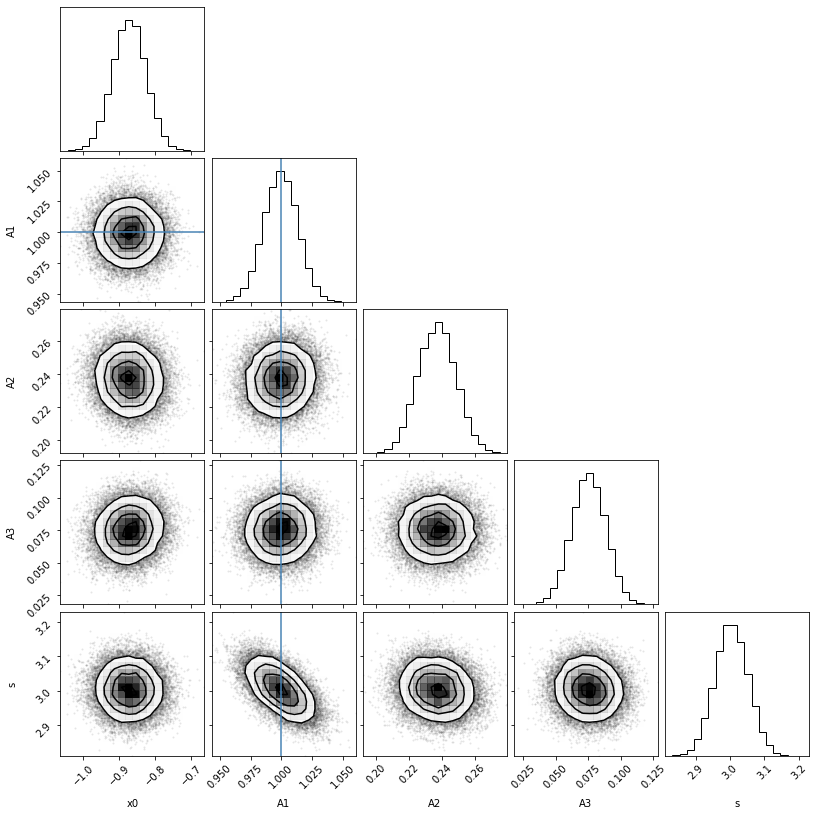

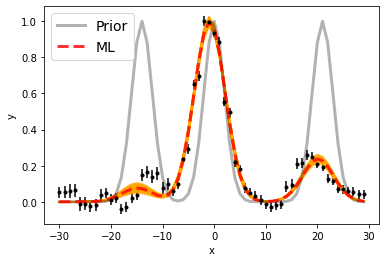

Maximum likelihood estimates:
x0 = -0.872
A1 = 1.000
A2 = 0.237
A3 = 0.075
s = 3.004


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.127217982163 6583.127217982163 [0.04651175 0.04583503]
A1, A2   =  1.1475222193363902e-16 2.7211815956253096e-17 [1.61175095e-18 1.58346498e-18] [1.33156421e-18 1.30758732e-18]
s  =  3.003646520606456 [0.04719107 0.04862682]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 17

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


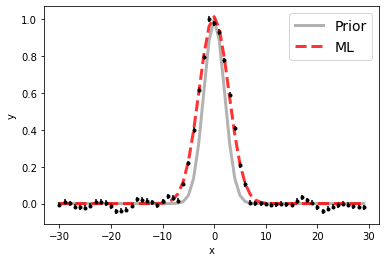

100%|██████████| 15000/15000 [00:16<00:00, 884.41it/s]


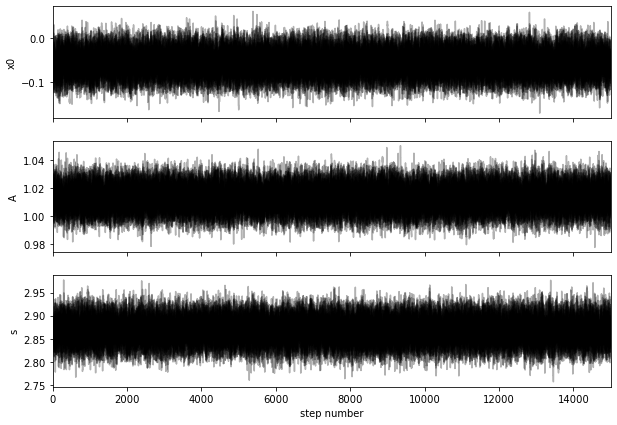

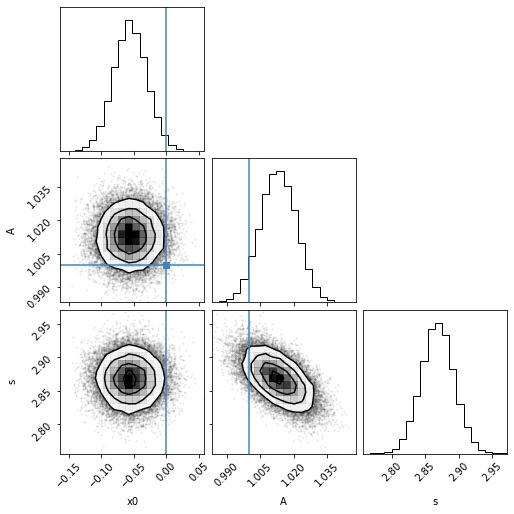

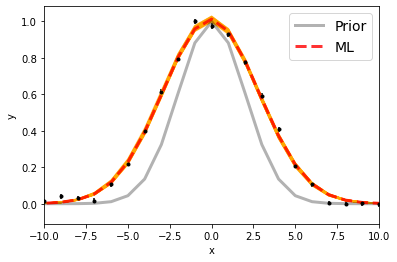

Maximum likelihood estimates:
x0 = -0.056
A = 1.013
s = 2.868


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.944326818989 [0.02541035 0.02577431]
A  =  7.554974949091368e-16 [5.99560019e-18 6.08097336e-18]
s  =  2.867965983591768 [0.02427988 0.02440243]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


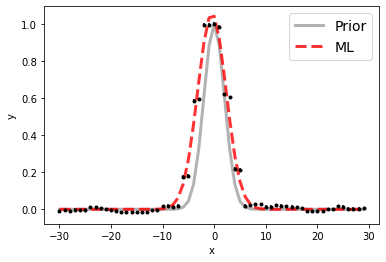

100%|██████████| 15000/15000 [00:16<00:00, 896.83it/s]


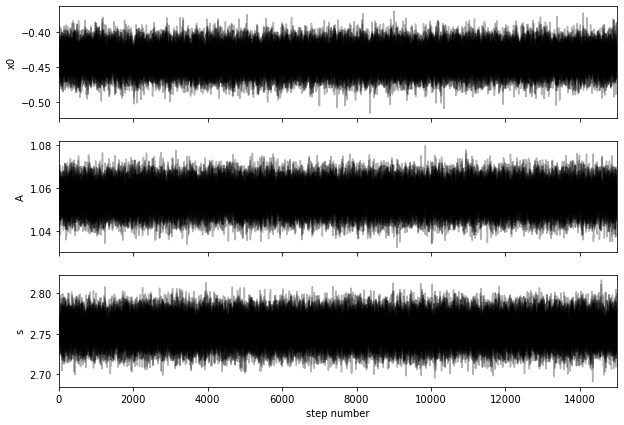

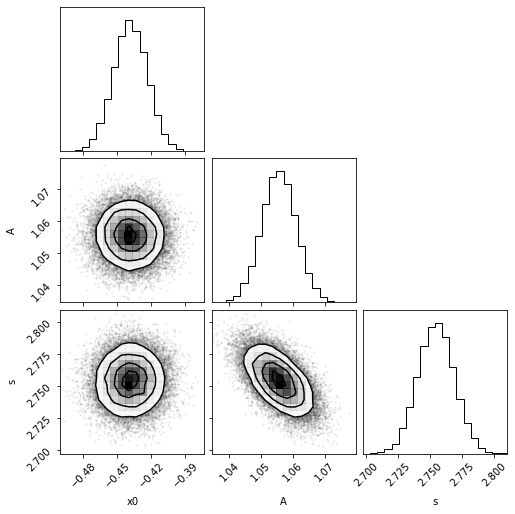

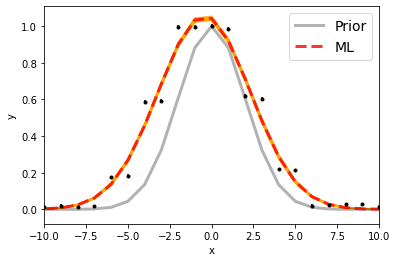

Maximum likelihood estimates:
x0 = -0.439
A = 1.056
s = 2.754


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.56139248242 [0.01488545 0.01510044]
A  =  1.263404064279181e-15 [6.44863415e-18 6.44635021e-18]
s  =  2.7543218261314406 [0.01401986 0.01397746]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


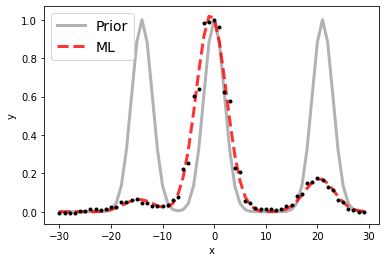

100%|██████████| 15000/15000 [00:27<00:00, 541.98it/s]


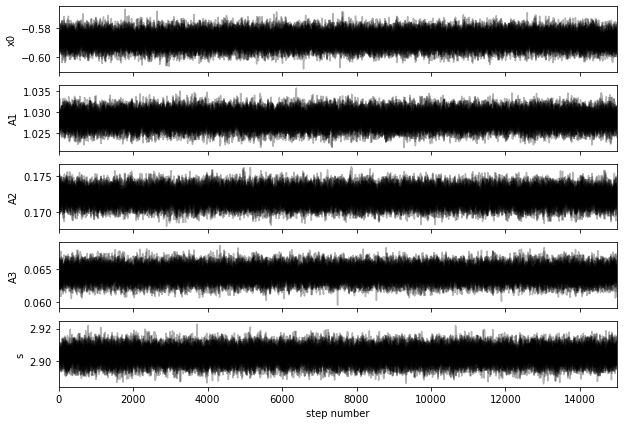

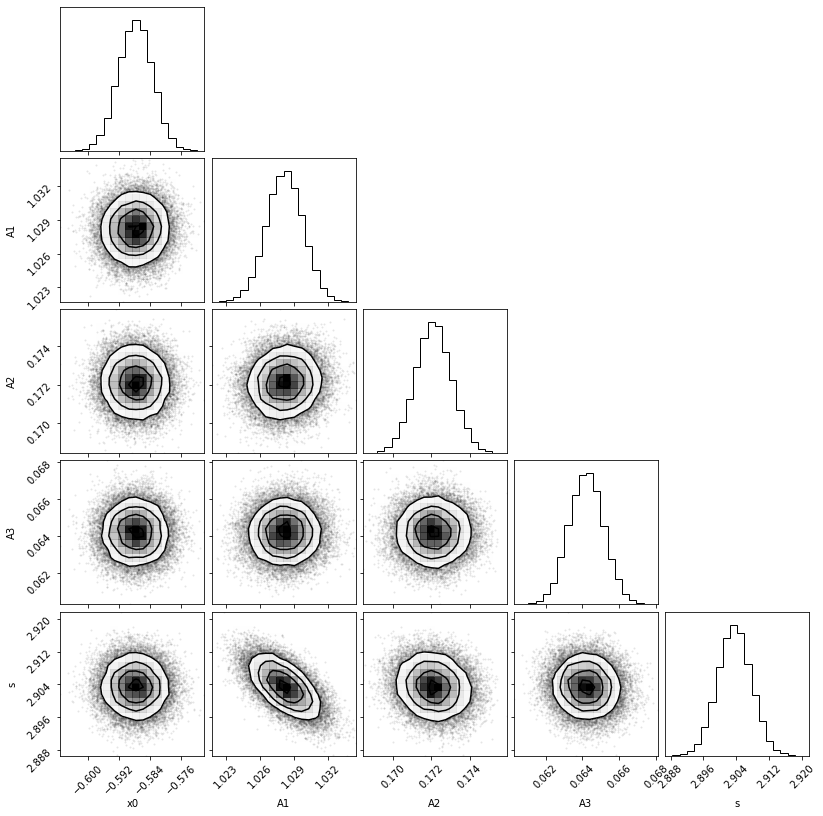

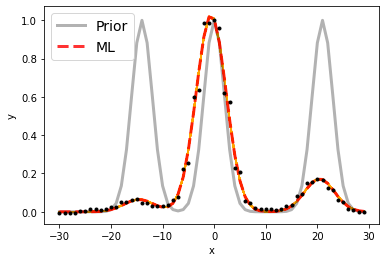

Maximum likelihood estimates:
x0 = -0.588
A1 = 1.028
A2 = 0.172
A3 = 0.064
s = 2.903


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.412289636419 6583.412289636419 [0.00439191 0.00431572]
A1, A2   =  1.986399642043651e-15 3.3248352669424084e-16 [3.11391584e-18 3.10144049e-18] [1.81326786e-18 1.83323076e-18]
s  =  2.903484934139077 [0.00401209 0.00409322]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 18

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


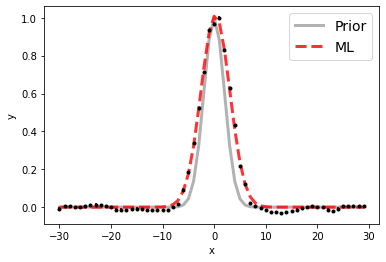

100%|██████████| 15000/15000 [00:18<00:00, 829.32it/s]


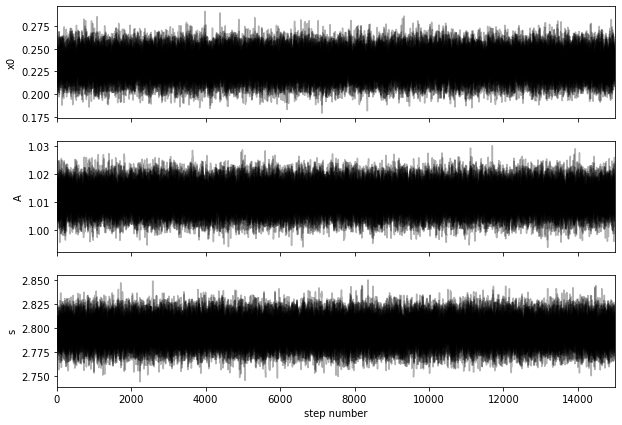

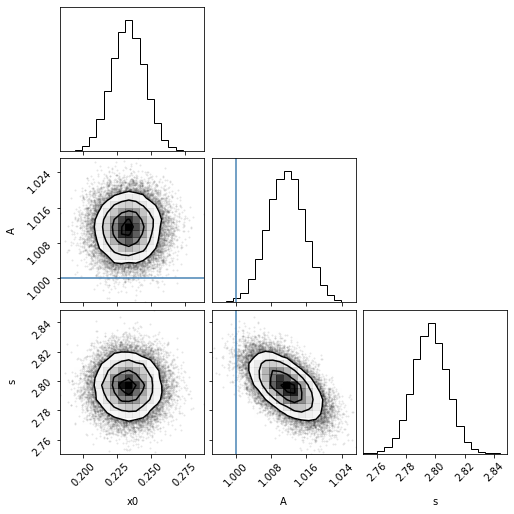

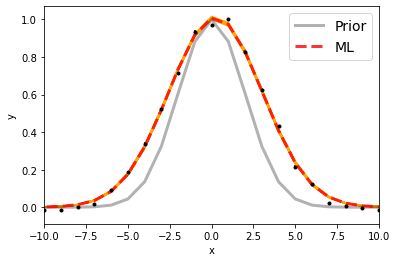

Maximum likelihood estimates:
x0 = 0.233
A = 1.011
s = 2.796


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.2330201623545 [0.01226922 0.0123311 ]
A  =  1.7302958136853808e-15 [7.09109056e-18 6.93788347e-18]
s  =  2.7964328805923655 [0.01135925 0.01161086]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


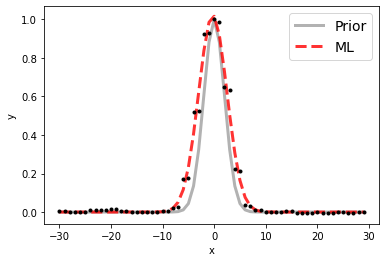

100%|██████████| 15000/15000 [00:17<00:00, 847.47it/s]


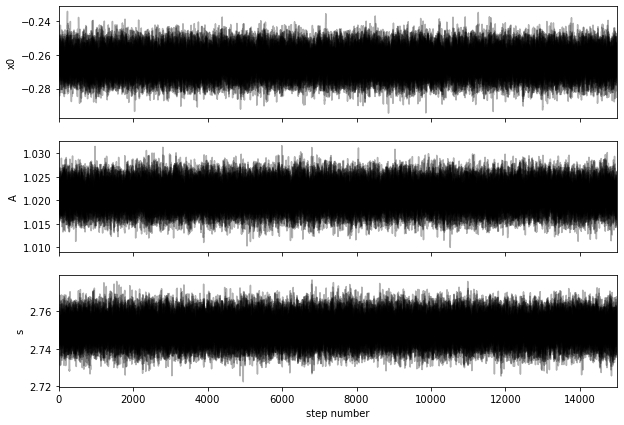

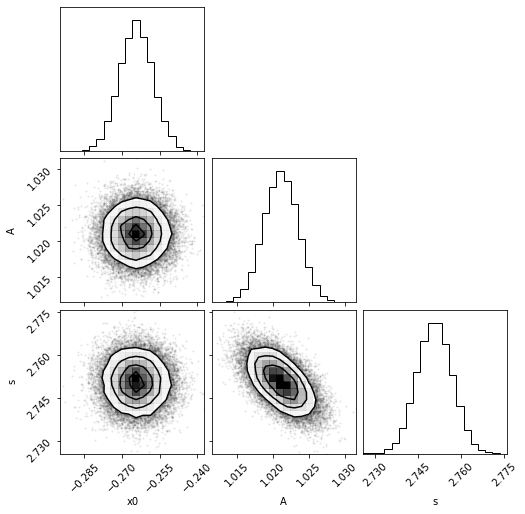

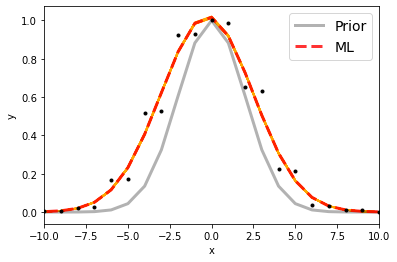

Maximum likelihood estimates:
x0 = -0.264
A = 1.021
s = 2.751


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.735615235439 [0.0066485  0.00663992]
A  =  3.344971986687777e-15 [7.81583477e-18 7.77941848e-18]
s  =  2.7506301988402906 [0.0061071  0.00607355]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


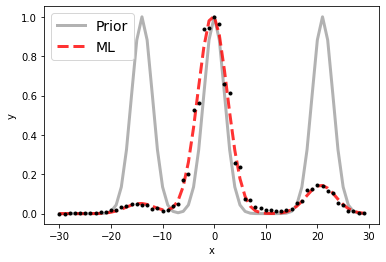

100%|██████████| 15000/15000 [00:28<00:00, 528.87it/s]


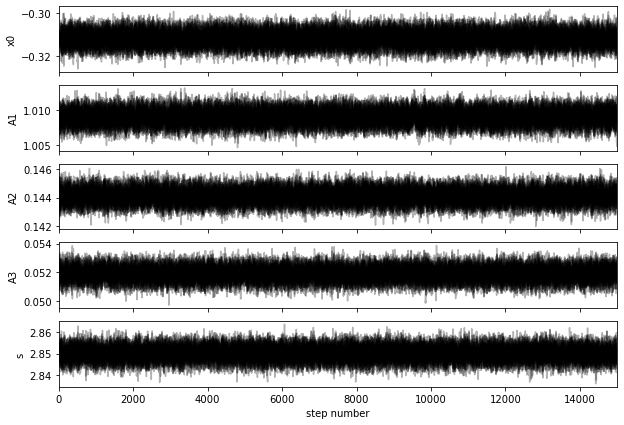

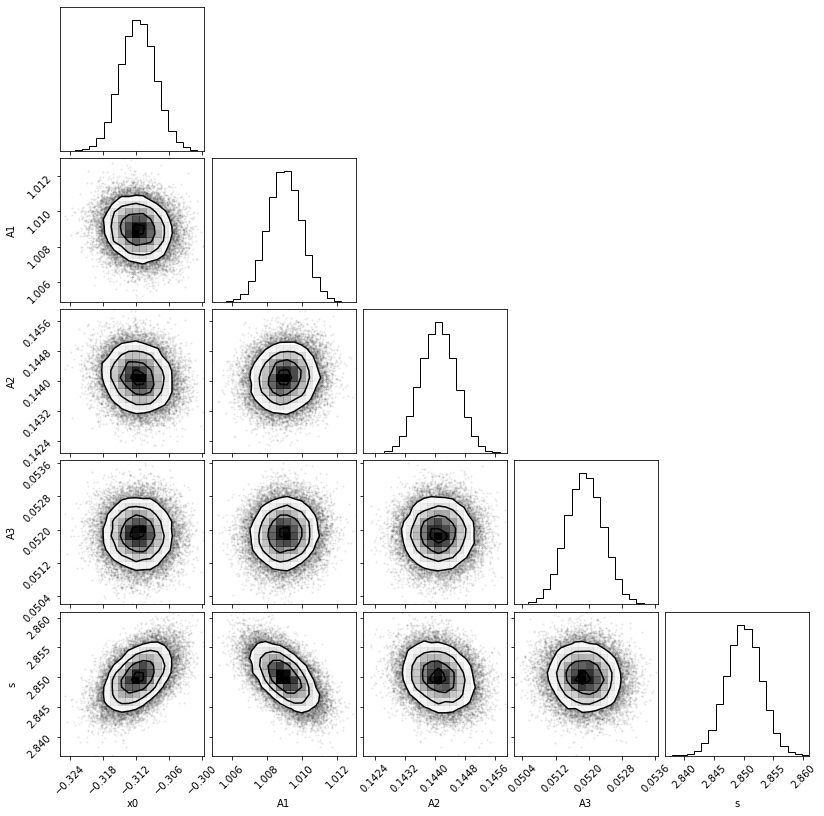

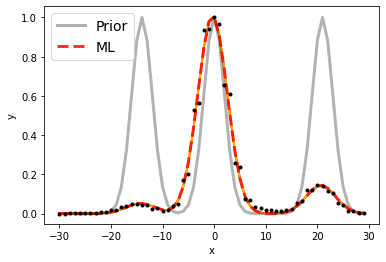

Maximum likelihood estimates:
x0 = -0.312
A1 = 1.009
A2 = 0.144
A3 = 0.052
s = 2.850


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.688290533802 6583.688290533802 [0.00316368 0.00316432]
A1, A2   =  4.14900844510989e-15 5.925360457016562e-16 [3.96073627e-18 3.96141920e-18] [1.95408003e-18 1.96183001e-18]
s  =  2.8500331478780265 [0.00295456 0.00292671]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


El programa ha finalizado en 1894 s.


In [3]:
instanteInicial = datetime.now()

os.chdir(path+'\\adjusted_spectrum')    
os.getcwd()


Hbeta = 4861
OIII = 5007
Halfa = 6563
NII = 6583

lineas = np.array([Hbeta,OIII,Halfa,NII])
lineas_wave = np.array(np.where((l_obs==Hbeta)|(l_obs==OIII)|(l_obs==Halfa)|(l_obs==NII)))

for j in range(len(l_obs_todos[:,0])):
    l_obs = l_obs_todos[j,:]
    f_obs = f_obs_todos[j,:]
    f_syn = f_syn_todos[j,:]
    e_emit = e_emit_todos[j,:]
    
    print('AJUSTANDO ESPECTRO',j)
    print()
    
    
    ##################################### Hb y OIII
    x0_1 = []
    A_1 = []
    s_1 = []
    e_x0_1 = []
    e_A_1 = []
    e_s_1 = []
    lineas_1 = lineas[0:2]
    lineas_wave_1 = lineas_wave[0,0:2]
    for i in range(len(lineas_1)):
        lim_i=lineas_wave_1[i]-30; lim_i=int(lim_i)
        lim_f=lineas_wave_1[i]+30; lim_f=int(lim_f)
        
        # Choose the "true" parameters.
        data = f_obs-f_syn
        wave = l_obs[lim_i:lim_f]
        flux = data[lim_i:lim_f]
        ymax = np.max(flux)
        x = wave-lineas_1[i]
        y = flux/ymax
        yerr = e_emit[lim_i:lim_f]/ymax
        linea = lineas_1[i]
        
        def gaussian(x, a, x0, sigma):
            return a*np.exp(-(x-x0)**2/(2*sigma**2))
            
        popt, pcov = curve_fit(gaussian, wave, flux, p0=[1, 0, 2])
        
        A_true,x0_true,s_true=popt
        print('Ajuste en', lineas_1[i],'nm:')
        print()
        print('Parámetros reales:')
        print(A_true,x0_true,s_true)
        print()
        
        
        # Maximum likehood estimation:
        def log_likelihood(theta, x, y, yerr):
            x0, A, s = theta
            model = A * np.exp( -(x-x0)**2 / (2 * s**2) )
            sigma2 = yerr ** 2 #+ model ** 2 
            return -0.5 * np.sum((y - model) ** 2 / sigma2 )#+ np.log(sigma2))
        
        np.random.seed(42)
        nll = lambda *args: -log_likelihood(*args)
        initial = np.array([x0_true, A_true, s_true]) + 0.1 * np.random.randn(3)
        soln = minimize(nll, initial, args=(x, y, yerr))
        x0_ml, A_ml, s_ml = soln.x
        
        
        plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
        plt.plot(x, A_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="Prior")
        plt.plot(x, A_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
        plt.legend(fontsize=14)
        #plt.xlim(-10, 10)
        plt.xlabel('x')
        plt.ylabel('y');
        plt.show()
        
        
        # Marginalization and uncertainty:
        def log_prior(theta):
            x0, A, s = theta
            if -10. < x0 < 10. and 0.0 < A < 20.0 and 0.0 < s < 5.0:
                return 0.0
            return -np.inf
        
        def log_probability(theta, x, y, yerr):
            lp = log_prior(theta)
            if not np.isfinite(lp):
                return -np.inf
            return lp + log_likelihood(theta, x, y, yerr)
        
        pos = soln.x + 1e-4 * np.random.randn(30, 3)
        nwalkers, ndim = pos.shape
        
        sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
        sampler.run_mcmc(pos, 15000, progress=True);
        
        
        fig, axes = plt.subplots(3, figsize=(10, 7), sharex=True)
        samples = sampler.get_chain()
        labels = ["x0", "A", "s"]
        for i in range(ndim):
            ax = axes[i]
            ax.plot(samples[:, :, i], "k", alpha=0.3)
            ax.set_xlim(0, len(samples))
            ax.set_ylabel(labels[i])
        #    ax.yaxis.set_label_coords(-0.1, 0.5)
        
        axes[-1].set_xlabel("step number");
        plt.show()
        
        
        flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
        #print(flat_samples.shape)
        
        
        # Resultados
        fig = corner.corner(flat_samples, labels=labels, truths=[x0_true, A_true, s_true]);
        plt.show()
        
        inds = np.random.randint(len(flat_samples), size=100)
        plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
        for ind in inds:
            sample = flat_samples[ind]
            plt.plot(x, sample[1] * np.exp(-(x-sample[0])**2 / (2*sample[2]**2)) , color='orange', alpha=0.3)
        plt.plot(x, A_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="Prior")
        plt.plot(x, A_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
        plt.legend(fontsize=14)
        plt.xlim(-10, 10)
        plt.xlabel('x')
        plt.ylabel('y');
        
        plt.show()
        
        print('Maximum likelihood estimates:')
        print("x0 = {0:.3f}".format(x0_ml))
        print("A = {0:.3f}".format(A_ml))
        print("s = {0:.3f}".format(s_ml))
        
        #
        datos = []
        errores = []
        for i in range(ndim):
            mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
            q = np.diff(mcmc)
            txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
            txt = txt.format(mcmc[1], q[0], q[1], labels[i])
            display(Math(txt))
            datos.append(mcmc[1])
            errores.append(q[:])
            
        datos = np.array(datos)
        errores = np.array(errores)
        x0 = datos[0]+linea
        A = datos[1]*ymax
        s = datos[2]
        e_x0 = errores[0]
        e_A = errores[1]*ymax
        e_s = errores[2]
        print('\nParámetros obtenidos:')
        print('x0 = ', x0, e_x0)
        print('A  = ', A, e_A)
        print('s  = ', s, e_s)
        print('\n-------------------------------------------------------------------------------------------')
        print()
        
        x0_1.append(x0)
        A_1.append(A)
        s_1.append(s)
        e_x0_1.append(e_x0)
        e_A_1.append(e_A)
        e_s_1.append(e_s)
    
    x0_1 = np.array(x0_1)
    A_1 = np.array(A_1)
    s_1 = np.array(s_1)
    e_x0_1 = np.array(e_x0_1)
    e_A_1 = np.array(e_A_1)
    e_s_1 = np.array(e_s_1)
    
        
    ##################################### Ha y NII
    
    d1 = 21
    d2 = 14
    
    x0_2 = []
    A1_2 = []
    A2_2 = []
    A3_2 = []
    s_2 = []
    e_x0_2 = []
    e_A1_2 = []
    e_A2_2 = []
    e_A3_2 = []
    e_s_2 = []
    lim_i = lineas_wave[0,2]-30; lim_i=int(lim_i)
    lim_f = lineas_wave[0,2]+30; lim_f=int(lim_f)
    
    # Choose the "true" parameters.
    data = f_obs-f_syn
    wave = l_obs[lim_i:lim_f]
    flux = data[lim_i:lim_f]
    ymax = np.max(flux)
    x = wave-lineas[2]
    y = flux/ymax
    yerr = e_emit[lim_i:lim_f]/ymax
    linea = lineas[2]
    
    def gaussian_2(x, a1 ,a2,a3, x0, sigma):
        return a1*np.exp(-(x-x0)**2/(2*sigma**2))+a2*np.exp(-(x-(x0+d1))**2/(2*sigma**2))+a3*np.exp(-(x-(x0-d2))**2/(2*sigma**2))
        
    popt, pcov = curve_fit(gaussian_2, wave, flux, p0=[1,1,1, 0, 2])
    
    A1_true,A2_true,A3_true,x0_true,s_true=popt
    print('Ajuste en', lineas[2],'nm:')
    print()
    print('Parámetros reales:')
    print(A1_true,A2_true,A3_true,x0_true,s_true)
    print()
    
    
    # Maximum likehood estimation:
    def log_likelihood(theta, x, y, yerr):
        x0, A1,A2,A3, s = theta
        model = A1 * np.exp( -(x-x0)**2 / (2 * s**2) )+A2 * np.exp( -(x-(x0+d1))**2 / (2 * s**2) )+A3 * np.exp( -(x-(x0-d2))**2 / (2 * s**2) )
        sigma2 = yerr ** 2 #+ model ** 2 
        return -0.5 * np.sum((y - model) ** 2 / sigma2 )#+ np.log(sigma2))
    
    np.random.seed(42)
    nll = lambda *args: -log_likelihood(*args)
    initial = np.array([x0_true, A1_true,A2_true,A3_true, s_true]) + 0.1 * np.random.randn(5)
    soln = minimize(nll, initial, args=(x, y, yerr))
    x0_ml, A1_ml,A2_ml,A3_ml, s_ml = soln.x
    
    
    plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
    plt.plot(x, A1_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))+ A2_true * np.exp(-(x-(x0_true+d1))**2 / (2*s_true**2))+ A3_true * np.exp(-(x-(x0_true-d2))**2 / (2*s_true**2))    , "k", alpha=0.3, lw=3, label="Prior")
    plt.plot(x, A1_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))+A2_ml * np.exp(-(x-(x0_ml+d1))**2 / (2*s_ml**2))+A3_ml * np.exp(-(x-(x0_ml-d2))**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
    plt.legend(fontsize=14)
    #plt.xlim(-10, 10)
    plt.xlabel('x')
    plt.ylabel('y');
    plt.show()
    
    
    # Marginalization and uncertainty:
    def log_prior(theta):
        x0, A1,A2,A3, s = theta
        if -10. < x0 < 10. and 0.0 < A1 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
        if -10. < x0 < 10. and 0.0 < A2 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
        if -10. < x0 < 10. and 0.0 < A3 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
    
    def log_probability(theta, x, y, yerr):
        lp = log_prior(theta)
        if not np.isfinite(lp):
            return -np.inf
        return lp + log_likelihood(theta, x, y, yerr)
    
    pos = soln.x + 1e-4 * np.random.randn(30, 5)
    nwalkers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
    sampler.run_mcmc(pos, 15000, progress=True);
    
    
    fig, axes = plt.subplots(5, figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["x0", "A1","A2","A3", "s"]
    for i in range(ndim):
        ax = axes[i]
        ax.plot(samples[:, :, i], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[i])
    #    ax.yaxis.set_label_coords(-0.1, 0.5)
    
    axes[-1].set_xlabel("step number");
    plt.show()
    
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    #print(flat_samples.shape)
    
    
    # Resultados
    fig = corner.corner(flat_samples, labels=labels, truths=[x0_true, A1_true, A2_true, A3_true, s_true]);
    plt.show()
    
    inds = np.random.randint(len(flat_samples), size=100)
    plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
    for ind in inds:
        sample = flat_samples[ind]
        plt.plot(x, sample[1] * np.exp(-(x-sample[0])**2 / (2*sample[4]**2))+sample[2] * np.exp(-(x-(sample[0]+d1))**2 / (2*sample[4]**2))+sample[3] * np.exp(-(x-(sample[0]-d2))**2 / (2*sample[4]**2)) , color='orange', alpha=0.3)
    plt.plot(x, A1_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))+ A2_true * np.exp(-(x-(x0_true+d1))**2 / (2*s_true**2))+ A3_true * np.exp(-(x-(x0_true-d2))**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="Prior")
    plt.plot(x, A1_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))+A2_ml * np.exp(-(x-(x0_ml+d1))**2 / (2*s_ml**2))+A3_ml * np.exp(-(x-(x0_ml-d2))**2 / (2*s_ml**2))   , "--r", alpha=0.8, lw=3, label="ML")
    plt.legend(fontsize=14)
  #  plt.xlim(-10, 10)
    plt.xlabel('x')
    plt.ylabel('y');
    
    plt.show()
    
    print('Maximum likelihood estimates:')
    print("x0 = {0:.3f}".format(x0_ml))
    print("A1 = {0:.3f}".format(A1_ml))
    print("A2 = {0:.3f}".format(A2_ml))
    print("A3 = {0:.3f}".format(A3_ml))
    print("s = {0:.3f}".format(s_ml))
    
    #
    datos = []
    errores = []
    for i in range(ndim):
        mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
        q = np.diff(mcmc)
        txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
        txt = txt.format(mcmc[1], q[0], q[1], labels[i])
        display(Math(txt))
        datos.append(mcmc[1])
        errores.append(q[:])
        
    datos = np.array(datos)
    errores = np.array(errores)
    x0 = datos[0]+linea
    A1 = datos[1]*ymax
    A2 = datos[2]*ymax
    A3 = datos[3]*ymax
    s = datos[4]
    e_x0 = errores[0]
    e_A1 = errores[1]*ymax
    e_A2 = errores[2]*ymax
    e_A3 = errores[3]*ymax
    e_s = errores[4]
    print('\nParámetros obtenidos:')
    print('x01, x02 = ', x0, x0+d1, e_x0)
    print('A1, A2   = ', A1, A2, e_A1, e_A2)
    print('s  = ', s, e_s)
    print('\n-------------------------------------------------------------------------------------------')
    print()
    
    x0_2.append(x0)
    A1_2.append(A1)
    A2_2.append(A2)
    A3_2.append(A3)
    s_2.append(s)
    e_x0_2.append(e_x0)
    e_A1_2.append(e_A1)
    e_A2_2.append(e_A2)
    e_A3_2.append(e_A3)
    e_s_2.append(e_s)
    
    x0_2 = np.array(x0_2)
    A1_2 = np.array(A1_2) # Ha
    A2_2 = np.array(A2_2) # NII
    A3_2 = np.array(A3_2) # El otro N
    s_2 = np.array(s_2)
    e_x0_2 = np.array(e_x0_2)
    e_A1_2 = np.array(e_A1_2)
    e_A2_2 = np.array(e_A2_2)
    e_A3_2 = np.array(e_A3_2)
    e_s_2 = np.array(e_s_2)
    
    
    ####
    
    
    x0_t = np.concatenate((x0_1,x0_2,(x0_2+d1)),axis=0)
    e_x0_t = np.concatenate((e_x0_1,e_x0_2,e_x0_2),axis=0)
    A_t = np.concatenate((A_1,A1_2,A2_2),axis=0)
    e_A_t = np.concatenate((e_A_1,e_A1_2,e_A2_2),axis=0)
    s_t = np.concatenate((s_1,s_2,s_2),axis=0)
    e_s_t = np.concatenate((e_s_1,e_s_2,e_s_2),axis=0) 

    #table = {'media': x0_t, 'e1x0':e_x0_t[:,0], 'e2x0':e_x0_t[:,1], 
    #         'A': A_t, 'e1A':e_A_t[:,0], 'e2A':e_A_t[:,1], 's':s_t, 
    #         'e1s':e_s_t[:,0], 'e2s':e_s_t[:,1]}
    #ascii.write(table, 'spectrum_adjusted_'+str(j)+'_NGC7250.txt', 
    #            formats={'media': '%.5f','e1x0': '%.5f','e2x0':'%.5f',
    #                     'A': '%.10e','e1A': '%.10e','e2A':'%.10e',
    #                     's': '%.5f','e1s': '%.5f','e2s':'%.5f'}, 
    #            overwrite=True,format='fixed_width',delimiter=None)  
    
    print('///////////////////////////////////////////////////////////////////////////////////////////')
    print()
    print()

instanteFinal = datetime.now()
tiempo = instanteFinal - instanteInicial 
segundos = tiempo.seconds
print('El programa ha finalizado en', segundos,'s.')

Tras esto, se han eliminado determinados espectros ya que no se podían ajustar adecuadamente. 

En este caso se han eliminado los espectros 2, 4 y 12.


### Calculo de flujos

Una vez conocemos la altura de la campana, A, y el ancho o desviación típica, s, del ajuste gaussiano calculamos el flujo de cada campana, que es el área debajo de la curva, que será:

                                           flujo = A * s * sqrt(2pi)

Y hacemos propagación de errores:

                             error = sqrt( 2pi * (s^2 * error_A^2 + A^2 *error_s^2)
                             
Los errores de A y sigma se han obtenido durante el ajuste gaussiano.

In [4]:
os.chdir(path+'\\adjusted_spectrum')    
os.getcwd()

lenn = len(glob.glob1(path+'\emited_spectrum',"*.BN"))

flux_t = []
err1_flux_t = []
err2_flux_t = []
for i in list(itertools.chain(range(0,lenn-8), range(lenn-7,lenn-1))):
    datos=pd.read_table('spectrum_adjusted_'+str(i)+'_NGC7250.txt', delim_whitespace=True)
    A = datos['A']
    s = datos['s']
    e1A = datos['e1A']
    e2A = datos['e2A']
    e1s = datos['e1s']
    e2s = datos['e2s']
    flux = []
    err1_flux = []
    err2_flux = []
    for j in range(len(A)): 
        integral = A[j]*s[j]*sqrt(2*pi)
        err1 = sqrt(2*pi*(s[j]**2*e1A[j]**2+A[j]**2*e1s[j]**2))
        err2 = sqrt(2*pi*(s[j]**2*e2A[j]**2+A[j]**2*e2s[j]**2))
        flux.append(integral)
        err1_flux.append(err1)
        err2_flux.append(err2)
    flux = np.array(flux)
    err1_flux = np.array(err1_flux)
    err2_flux = np.array(err2_flux)
    flux_t.append(flux)
    err1_flux_t.append(err1_flux)
    err2_flux_t.append(err2_flux)
flux_t = np.array(flux_t)
err1_flux_t = np.array(err1_flux_t)
err2_flux_t = np.array(err2_flux_t)

spec = np.linspace(0,len(flux_t[:,0])-1,len(flux_t[:,0]))
#for j in range(len(flux_t[:,0])):
#    table = {'spec': spec, 'Ha':flux_t[:,2], 'e1Ha':err1_flux_t[:,2], 'e2Ha':err2_flux_t[:,2], 
#             'Hb':flux_t[:,0], 'e1Hb':err1_flux_t[:,0], 'e2Hb':err2_flux_t[:,0], 'O3': flux_t[:,1], 
#             'e1O3':err1_flux_t[:,1], 'e2O3':err2_flux_t[:,1], 'N2':flux_t[:,3], 'e1N2':err1_flux_t[:,3], 
#             'e2N2':err2_flux_t[:,3]}
#    ascii.write(table, 'flujos.txt', formats={'spec': '%i','Ha': '%.6e','e1Ha': '%.6e','e2Ha': '%.6e',
#                                              'Hb':'%.6e','e1Hb': '%.6e','e2Hb': '%.6e','O3': '%.6e',
#                                              'e1O3': '%.6e','e2O3': '%.6e','N2': '%.6e','e1N2': '%.6e',
#                                              'e2N2': '%.6e',}, overwrite=True, format='fixed_width',delimiter=None)  
